# Convolutional Neural Networks

## Project: Write an Algorithm for a Dog Identification App 

---

In this notebook, some template code has already been provided for you, and you will need to implement additional functionality to successfully complete this project. You will not need to modify the included code beyond what is requested. Sections that begin with **'(IMPLEMENTATION)'** in the header indicate that the following block of code will require additional functionality which you must provide. Instructions will be provided for each section, and the specifics of the implementation are marked in the code block with a 'TODO' statement. Please be sure to read the instructions carefully! 

> **Note**: Once you have completed all of the code implementations, you need to finalize your work by exporting the Jupyter Notebook as an HTML document. Before exporting the notebook to html, all of the code cells need to have been run so that reviewers can see the final implementation and output. You can then export the notebook by using the menu above and navigating to **File -> Download as -> HTML (.html)**. Include the finished document along with this notebook as your submission.

In addition to implementing code, there will be questions that you must answer which relate to the project and your implementation. Each section where you will answer a question is preceded by a **'Question X'** header. Carefully read each question and provide thorough answers in the following text boxes that begin with **'Answer:'**. Your project submission will be evaluated based on your answers to each of the questions and the implementation you provide.

>**Note:** Code and Markdown cells can be executed using the **Shift + Enter** keyboard shortcut.  Markdown cells can be edited by double-clicking the cell to enter edit mode.

The rubric contains _optional_ "Stand Out Suggestions" for enhancing the project beyond the minimum requirements. If you decide to pursue the "Stand Out Suggestions", you should include the code in this Jupyter notebook.



---
### Why We're Here 

In this notebook, you will make the first steps towards developing an algorithm that could be used as part of a mobile or web app.  At the end of this project, your code will accept any user-supplied image as input.  If a dog is detected in the image, it will provide an estimate of the dog's breed.  If a human is detected, it will provide an estimate of the dog breed that is most resembling.  The image below displays potential sample output of your finished project (... but we expect that each student's algorithm will behave differently!). 

![Sample Dog Output](images/sample_dog_output.png)

In this real-world setting, you will need to piece together a series of models to perform different tasks; for instance, the algorithm that detects humans in an image will be different from the CNN that infers dog breed.  There are many points of possible failure, and no perfect algorithm exists.  Your imperfect solution will nonetheless create a fun user experience!

### The Road Ahead

We break the notebook into separate steps.  Feel free to use the links below to navigate the notebook.

* [Step 0](#step0): Import Datasets
* [Step 1](#step1): Detect Humans
* [Step 2](#step2): Detect Dogs
* [Step 3](#step3): Create a CNN to Classify Dog Breeds (from Scratch)
* [Step 4](#step4): Create a CNN to Classify Dog Breeds (using Transfer Learning)
* [Step 5](#step5): Write your Algorithm
* [Step 6](#step6): Test Your Algorithm

---
<a id='step0'></a>
## Step 0: Import Datasets

Make sure that you've downloaded the required human and dog datasets:
* Download the [dog dataset](https://s3-us-west-1.amazonaws.com/udacity-aind/dog-project/dogImages.zip).  Unzip the folder and place it in this project's home directory, at the location `/dogImages`. 

* Download the [human dataset](https://s3-us-west-1.amazonaws.com/udacity-aind/dog-project/lfw.zip).  Unzip the folder and place it in the home diretcory, at location `/lfw`.  

*Note: If you are using a Windows machine, you are encouraged to use [7zip](http://www.7-zip.org/) to extract the folder.*

In the code cell below, we save the file paths for both the human (LFW) dataset and dog dataset in the numpy arrays `human_files` and `dog_files`.

In [1]:
import numpy as np
from glob import glob
import os
import time
import copy
import cv2                
import matplotlib.pyplot as plt                        
%matplotlib inline 

In [2]:
import torch
use_cuda = torch.cuda.is_available()
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

In [3]:
# see https://github.com/pytorch/pytorch/issues/7068
import random
SEED = 0
torch.manual_seed(SEED)
torch.cuda.manual_seed(SEED)
np.random.seed(SEED)
random.seed(SEED)
torch.backends.cudnn.deterministic=True

In [ ]:
# global variable used throughout...
model_name = ""

In [5]:
# load filenames for human and dog images
# human_files = np.array(glob("/data/lfw/*/*"))
# dog_files = np.array(glob("/data/dog_images/*/*/*"))

# have copied the images to my local workspace to allow for removing corrupted images, 
# so set up directory variables to allow for loading from original or workspace
# orig_dir = "/data/"
# work_dir = "/home/workspace/data/"
# project_dir = "/home/workspace/dog_project/"

orig_dir = "/DeepLearning/data/dog_app/"
work_dir = "/DeepLearning/deep-learning-v2-pytorch/project-dog-classification/"
project_dir = "/DeepLearning/deep-learning-v2-pytorch/project-dog-classification/"

human_files = np.array(glob(orig_dir + 'lfw/*/*'))
dog_files   = np.array(glob(orig_dir + 'dog_images/*/*/*'))

# print number of images in each dataset
print('There are %d total human images.' % len(human_files))
print('There are %d total dog images.' % len(dog_files))

There are 13233 total human images.
There are 8350 total dog images.


In [6]:
from torchsummary import summary

In [7]:
def get_learning_rate(optimizer):
    lr=[]
    for param_group in optimizer.param_groups:
       lr +=[ param_group['lr'] ]
    return lr

In [8]:
def unfreeze(model):
    for name, child in model.named_children():
        for param in child.parameters():
            param.requires_grad = True
        unfreeze(child)

In [9]:
def freeze(model):
    for name, child in model.named_children():
        for param in child.parameters():
            param.requires_grad = False
        freeze(child)

In [10]:
def compare_dicts(dict_1, dict_2):
    dicts_differ = 0
    for key_item_1, key_item_2 in zip(dict_1.items(), dict_2.items()):
        if torch.equal(key_item_1[1], key_item_2[1]):
            pass
        else:
            dicts_differ += 1
            if (key_item_1[0] == key_item_2[0]):
                print('Mismtach found at', key_item_1[0])
            else:
                raise Exception
                
    if dicts_differ == 0:
        print('State_Dicts match')

In [11]:
# Allow for specific calculation of image means and standard deviation, defaults are the imagenet values if these are None...
img_means = None
img_std = None

In [12]:
# Or use these - see further in notebook for the calculations involved...
img_means = [0.4868, 0.4666, 0.3972]
img_std = [0.2605, 0.2551, 0.2609]

To allow for long-running processes (i.e. network training) import [workspace_utils](https://github.com/udacity/workspaces-student-support/tree/master/jupyter). Using magic command %load to import into next cell.

<a id='step1'></a>
## Step 1: Detect Humans

In this section, we use OpenCV's implementation of [Haar feature-based cascade classifiers](http://docs.opencv.org/trunk/d7/d8b/tutorial_py_face_detection.html) to detect human faces in images.  

OpenCV provides many pre-trained face detectors, stored as XML files on [github](https://github.com/opencv/opencv/tree/master/data/haarcascades).  We have downloaded one of these detectors and stored it in the `haarcascades` directory.  In the next code cell, we demonstrate how to use this detector to find human faces in a sample image.

Number of faces detected: 1


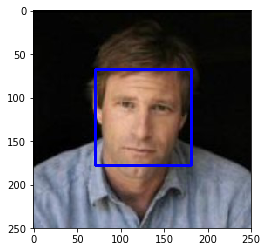

In [13]:
import cv2                
import matplotlib.pyplot as plt                        
%matplotlib inline                               

# extract pre-trained face detector
face_cascade = cv2.CascadeClassifier('haarcascades/haarcascade_frontalface_alt.xml')

# load color (BGR) image
img = cv2.imread(human_files[0])
# convert BGR image to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# find faces in image
faces = face_cascade.detectMultiScale(gray)

# print number of faces detected in the image
print('Number of faces detected:', len(faces))

# get bounding box for each detected face
for (x,y,w,h) in faces:
    # add bounding box to color image
    cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
    
# convert BGR image to RGB for plotting
cv_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# display the image, along with bounding box
plt.imshow(cv_rgb)
plt.show()

In [14]:
faces

array([[ 71,  68, 110, 110]], dtype=int32)

Before using any of the face detectors, it is standard procedure to convert the images to grayscale.  The `detectMultiScale` function executes the classifier stored in `face_cascade` and takes the grayscale image as a parameter.  

In the above code, `faces` is a numpy array of detected faces, where each row corresponds to a detected face.  Each detected face is a 1D array with four entries that specifies the bounding box of the detected face.  The first two entries in the array (extracted in the above code as `x` and `y`) specify the horizontal and vertical positions of the top left corner of the bounding box.  The last two entries in the array (extracted here as `w` and `h`) specify the width and height of the box.

### Write a Human Face Detector

We can use this procedure to write a function that returns `True` if a human face is detected in an image and `False` otherwise.  This function, aptly named `face_detector`, takes a string-valued file path to an image as input and appears in the code block below.

In [15]:
# returns "True" if face is detected in image stored at img_path
def face_detector(img_path):
    img = cv2.imread(img_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    faces = face_cascade.detectMultiScale(gray)
    return len(faces) > 0

### (IMPLEMENTATION) Assess the Human Face Detector

__Question 1:__ Use the code cell below to test the performance of the `face_detector` function.  
- What percentage of the first 100 images in `human_files` have a detected human face?  
- What percentage of the first 100 images in `dog_files` have a detected human face? 

Ideally, we would like 100% of human images with a detected face and 0% of dog images with a detected face.  You will see that our algorithm falls short of this goal, but still gives acceptable performance.  We extract the file paths for the first 100 images from each of the datasets and store them in the numpy arrays `human_files_short` and `dog_files_short`.

__Answer:__ 
(You can print out your results and/or write your percentages in this cell)

In [16]:
%%time

from tqdm import tqdm

human_files_short = human_files[:100]
dog_files_short = dog_files[:100]

#-#-# Do NOT modify the code above this line. #-#-#

## TODO: Test the performance of the face_detector algorithm 
## on the images in human_files_short and dog_files_short.
def countFaces(faceList):
    return [face_detector(img) for img in faceList]

human_faces = countFaces(human_files_short)
dog_faces = countFaces(dog_files_short)

print("{}% of human faces detected".format(sum(human_faces)))
print("{}% of dogs detected as having human faces!".format(sum(dog_faces)))

96% of human faces detected
18% of dogs detected as having human faces!
Wall time: 12.3 s


In [17]:
human_files_short = human_files[:100]
dog_files_short = dog_files[:100]

In [18]:
human_files_short[0]

'/DeepLearning/data/dog_app/lfw\\Aaron_Eckhart\\Aaron_Eckhart_0001.jpg'

In [19]:
face_detector(human_files_short[0])

True

**In the first 1,000 images from each set, 96% of the human faces were detected, conversely 18% of dogs were detected as having human faces**

In [20]:
bad_human_faces = [a for a, b in zip(human_files_short, human_faces) if b == False]
bad_dog_faces = [a for a, b in zip(dog_files_short, dog_faces) if b == True]

In [21]:
len(bad_human_faces), len(bad_dog_faces)

(4, 18)

In [22]:
for ii in range(len(bad_human_faces)):
    print(bad_human_faces[ii])    

lfw\Aaron_Patterson\Aaron_Patterson_0001.jpg
lfw\Abdullah_al-Attiyah\Abdullah_al-Attiyah_0001.jpg
lfw\Abdullah_Gul\Abdullah_Gul_0016.jpg
lfw\Abdul_Majeed_Shobokshi\Abdul_Majeed_Shobokshi_0001.jpg


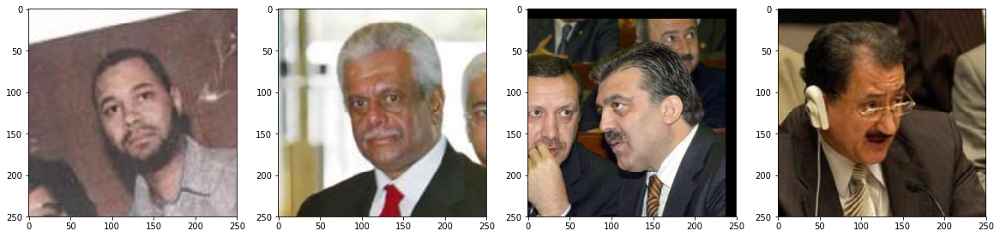

In [23]:
_, axes = plt.subplots(figsize=(20,6), ncols=4)

for ii in range(4):
    ax = axes[ii]
    img = cv2.imread(bad_human_faces[ii])
    cv_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    ax.imshow(cv_rgb)

In [24]:
for ii in range(len(bad_dog_faces)):
    print(bad_dog_faces[ii]) 

dogImages\test\002.Afghan_hound\Afghan_hound_00151.jpg
dogImages\test\004.Akita\Akita_00258.jpg
dogImages\test\004.Akita\Akita_00282.jpg
dogImages\test\005.Alaskan_malamute\Alaskan_malamute_00330.jpg
dogImages\test\005.Alaskan_malamute\Alaskan_malamute_00383.jpg
dogImages\test\005.Alaskan_malamute\Alaskan_malamute_00386.jpg
dogImages\test\005.Alaskan_malamute\Alaskan_malamute_00387.jpg
dogImages\test\006.American_eskimo_dog\American_eskimo_dog_00451.jpg
dogImages\test\008.American_staffordshire_terrier\American_staffordshire_terrier_00556.jpg
dogImages\test\009.American_water_spaniel\American_water_spaniel_00624.jpg
dogImages\test\010.Anatolian_shepherd_dog\Anatolian_shepherd_dog_00661.jpg
dogImages\test\010.Anatolian_shepherd_dog\Anatolian_shepherd_dog_00710.jpg
dogImages\test\011.Australian_cattle_dog\Australian_cattle_dog_00734.jpg
dogImages\test\011.Australian_cattle_dog\Australian_cattle_dog_00761.jpg
dogImages\test\011.Australian_cattle_dog\Australian_cattle_dog_00792.jpg
dogImag

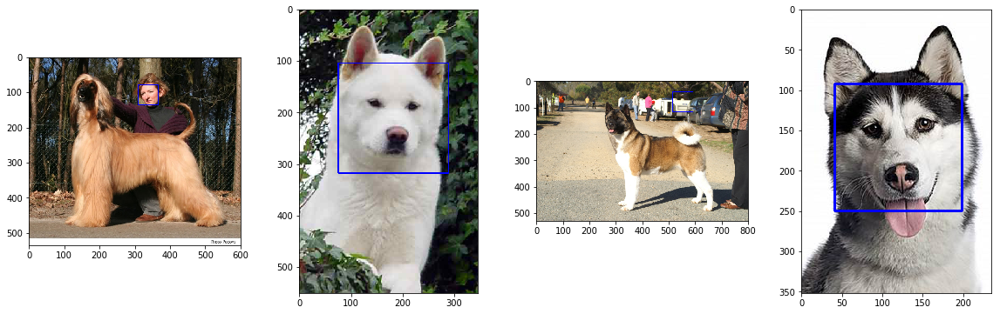

In [25]:
_, axes = plt.subplots(figsize=(20,6), ncols=4)

for ii in range(4):
    ax = axes[ii]
    img = cv2.imread(bad_dog_faces[ii])
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    faces = face_cascade.detectMultiScale(gray)
    for (x,y,w,h) in faces:
        cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
    cv_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)    
    ax.imshow(cv_rgb)

**Look at the third image in more detail for how erroneous a bounding box might be...**

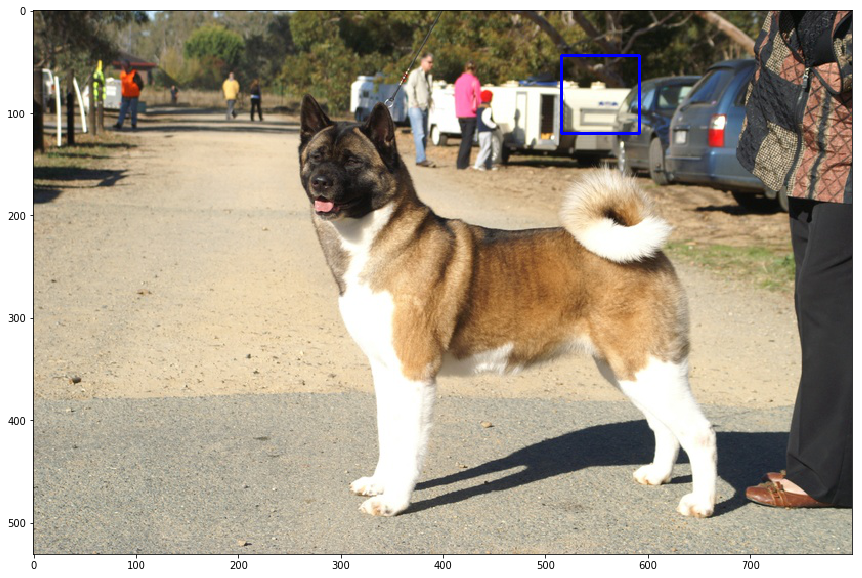

In [27]:
figsize = (20, 10)

fig = plt.figure(figsize=figsize)
    
img = cv2.imread(bad_dog_faces[2])
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
faces = face_cascade.detectMultiScale(gray)
for (x,y,w,h) in faces:
    cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
cv_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

plt.imshow(cv_rgb)

Examination of a few images shows the failure of human face detection may be due to poor contrast and color in the human photos, and that there may be genuine human faces contained in some of the dog photos, or that the dog photos are close up shots with the dog facing front-on to the camera. Additionally, any geometric shape that includes something like two eyes and a mouth can be interpreted as a face!

---

We suggest the face detector from OpenCV as a potential way to detect human images in your algorithm, but you are free to explore other approaches, especially approaches that make use of deep learning :).  Please use the code cell below to design and test your own face detection algorithm.  If you decide to pursue this _optional_ task, report performance on `human_files_short` and `dog_files_short`.

In [28]:
### (Optional) 
### TODO: Test performance of anotherface detection algorithm.
### Feel free to use as many code cells as needed.

## Further explore the data

In [29]:
data_dir = 'dog_images/'
train_dir = data_dir + 'train/'
valid_dir = data_dir + 'valid/'
test_dir  = data_dir + 'test/'

In [30]:
from pathlib import Path
import os

def folders_in_path(path):
    if not Path.is_dir(path):
        raise ValueError("argument is not a directory")
    yield from filter(Path.is_dir, path.iterdir())

def folders_in_depth(path, depth):
    if 0 > depth:
        raise ValueError("depth smaller 0")
    if 0 == depth:
        yield from folders_in_path(path)
    else:
        for folder in folders_in_path(path):
            yield from folders_in_depth(folder, depth-1)

def files_in_path(path):
    if not Path.is_dir(path):
        raise ValueError("argument is not a directory")
    yield from filter(Path.is_file, path.iterdir())
    
def sum_file_size(filepaths):
    return sum([filep.stat().st_size for filep in filepaths])


In [31]:
def files_per_folder(dir_path, dir_desc):
    files_per_folder = []
    for folder in folders_in_depth(Path.cwd()/dir_path,0):
        files = list(files_in_path(folder))
        foldername = os.path.basename(os.path.normpath(folder))
        files_per_folder.append((foldername, len(files)))

    print(dir_desc)
    print("-" * 48)
    for image in files_per_folder:
        img_name = image[0]+' '*50
        img_name = img_name[:45]
        img_count = image[1]
        print('{} {}'.format(img_name, img_count))

In [32]:
files_per_folder(train_dir, "Training data files per class:")

Training data files per class:
------------------------------------------------
001.Affenpinscher                             64
002.Afghan_hound                              58
003.Airedale_terrier                          52
004.Akita                                     63
005.Alaskan_malamute                          77
006.American_eskimo_dog                       64
007.American_foxhound                         50
008.American_staffordshire_terrier            66
009.American_water_spaniel                    34
010.Anatolian_shepherd_dog                    50
011.Australian_cattle_dog                     66
012.Australian_shepherd                       66
013.Australian_terrier                        46
014.Basenji                                   69
015.Basset_hound                              73
016.Beagle                                    59
017.Bearded_collie                            62
018.Beauceron                                 50
019.Bedlington_terrier                

In [33]:
files_per_folder(valid_dir, "Validation data files per class:")

Validation data files per class:
------------------------------------------------
001.Affenpinscher                             8
002.Afghan_hound                              7
003.Airedale_terrier                          7
004.Akita                                     8
005.Alaskan_malamute                          9
006.American_eskimo_dog                       8
007.American_foxhound                         6
008.American_staffordshire_terrier            8
009.American_water_spaniel                    4
010.Anatolian_shepherd_dog                    6
011.Australian_cattle_dog                     8
012.Australian_shepherd                       8
013.Australian_terrier                        6
014.Basenji                                   8
015.Basset_hound                              9
016.Beagle                                    7
017.Bearded_collie                            7
018.Beauceron                                 6
019.Bedlington_terrier                        6
020.Be

In [34]:
files_per_folder(test_dir, "Testing data files per class:")

Testing data files per class:
------------------------------------------------
001.Affenpinscher                             8
002.Afghan_hound                              8
003.Airedale_terrier                          6
004.Akita                                     8
005.Alaskan_malamute                          10
006.American_eskimo_dog                       8
007.American_foxhound                         7
008.American_staffordshire_terrier            8
009.American_water_spaniel                    4
010.Anatolian_shepherd_dog                    6
011.Australian_cattle_dog                     9
012.Australian_shepherd                       9
013.Australian_terrier                        6
014.Basenji                                   9
015.Basset_hound                              10
016.Beagle                                    8
017.Bearded_collie                            8
018.Beauceron                                 7
019.Bedlington_terrier                        6
020.Bel

In [35]:
files_per_folder("lfw/", "Human image counts:")

Human image counts:
------------------------------------------------
Aaron_Eckhart                                 1
Aaron_Guiel                                   1
Aaron_Patterson                               1
Aaron_Peirsol                                 4
Aaron_Pena                                    1
Aaron_Sorkin                                  2
Aaron_Tippin                                  1
Abbas_Kiarostami                              1
Abba_Eban                                     1
Abdel_Aziz_Al-Hakim                           1
Abdel_Madi_Shabneh                            1
Abdel_Nasser_Assidi                           2
Abdoulaye_Wade                                4
Abdulaziz_Kamilov                             1
Abdullah                                      4
Abdullah_Ahmad_Badawi                         1
Abdullah_al-Attiyah                           3
Abdullah_Gul                                  19
Abdullah_Nasseef                              1
Abdullatif_Sener  

Erwin_Mapasseng                               1
Esad_Landzo                                   1
Esteban_Cordoba-Velazquez                     1
Estella_Warren                                1
Estelle_Morris                                1
Ester_Canadas                                 1
Esther_Macklin                                1
Ethan_Hawke                                   4
Etta_James                                    1
Eugene_Melnyk                                 1
Eugene_Teslovic                               1
Eunice_Barber                                 2
Eurico_Guterres                               1
Evander_Holyfield                             2
Evan_Marriott                                 1
Evan_Rachel_Wood                              3
Eva_Amurri                                    1
Eva_Dimas                                     2
Eva_Herzigova                                 1
Eva_Marie_Saint                               1
Eva_Mendes                              

Krishna_Bhadur_Mahara                         1
Kristanna_Loken                               5
Kristen_Breitweiser                           3
Kristen_Rivera                                1
Kristin_Chenoweth                             1
Kristin_Davis                                 3
Kristin_Scott                                 1
Kristin_Scott_Thomas                          1
Kristy_Curry                                  1
Kultida_Woods                                 1
Kurt_Budke                                    1
Kurt_Busch                                    2
Kurt_Hellstrom                                1
Kurt_Russell                                  2
Kurt_Schottenheimer                           1
Kurt_Suzuki                                   1
Kurt_Tanabe                                   1
Kurt_Thomas                                   1
Kurt_Warner                                   5
Kwame_Kilpatrick                              1
Kweisi_Mfume                            

Rick_Carlisle                                 4
Rick_Caruso                                   1
Rick_Dinse                                    3
Rick_Husband                                  1
Rick_Lu                                       1
Rick_Perry                                    6
Rick_Pitino                                   4
Rick_Reed                                     1
Rick_Rickert                                  1
Rick_Romley                                   3
Rick_Santorum                                 3
Rick_Stansbury                                3
Rick_Wagoner                                  2
Ridley_Scott                                  1
Riek_Blanjaar                                 1
Rien_Long                                     1
Rina_Lazo                                     1
Ringo_Starr                                   1
Rio_Ferdinand                                 2
Rita_Grande                                   3
Rita_Moreno                             

---
<a id='step2'></a>
## Step 2: Detect Dogs

In this section, we use a [pre-trained model](http://pytorch.org/docs/master/torchvision/models.html) to detect dogs in images.  

### Obtain Pre-trained VGG-16 Model

The code cell below downloads the VGG-16 model, along with weights that have been trained on [ImageNet](http://www.image-net.org/), a very large, very popular dataset used for image classification and other vision tasks.  ImageNet contains over 10 million URLs, each linking to an image containing an object from one of [1000 categories](https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a).  

In [36]:
import torch
import torchvision.models as models

# define VGG16 model
VGG16 = models.vgg16(pretrained=True)

# check if CUDA is available
use_cuda = torch.cuda.is_available()

# move model to GPU if CUDA is available
if use_cuda:
    VGG16 = VGG16.cuda()

In [37]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

In [38]:
VGG16.eval();

In [39]:
print(VGG16.classifier)

Sequential(
  (0): Linear(in_features=25088, out_features=4096, bias=True)
  (1): ReLU(inplace)
  (2): Dropout(p=0.5)
  (3): Linear(in_features=4096, out_features=4096, bias=True)
  (4): ReLU(inplace)
  (5): Dropout(p=0.5)
  (6): Linear(in_features=4096, out_features=1000, bias=True)
)


Given an image, this pre-trained VGG-16 model returns a prediction (derived from the 1000 possible categories in ImageNet) for the object that is contained in the image.

### (IMPLEMENTATION) Making Predictions with a Pre-trained Model

In the next code cell, you will write a function that accepts a path to an image (such as `'dogImages/train/001.Affenpinscher/Affenpinscher_00001.jpg'`) as input and returns the index corresponding to the ImageNet class that is predicted by the pre-trained VGG-16 model.  The output should always be an integer between 0 and 999, inclusive.

Before writing the function, make sure that you take the time to learn  how to appropriately pre-process tensors for pre-trained models in the [PyTorch documentation](http://pytorch.org/docs/stable/torchvision/models.html).

In [40]:
# Allows for specific calculation of image means and standard deviation, defaults are the imagenet values...
img_means = None
img_std = None

## Calculate image means and standard deviation

The ImageNet defaults are probably quite sufficient for normalisation, since these are ImageNet images. But as they are a subset its perhaps worth experimenting with calculating means and std from just these images, and in any case its a useful tool to have.

The first approach I have developed (informed by Prof Google), the second approach comes from the Udacity student hub. I am using the results from my own approach as the standard deviation figures differ and seem more realistic to me.

In [41]:
img_means = [0.4868, 0.4666, 0.3972]
img_std = [0.2605, 0.2551, 0.2609]

Tried using ImageFile.LOAD_TRUNCATED_IMAGES = False and num_workers = 0 to prevent loading of corrupted image train/098.Leonberger/Leonberger_06571.jpg. However this was too slow so the image needs to be deleted...

In [42]:
if os.path.isfile(train_dir + '098.Leonberger/Leonberger_06571.jpg'):
    print('Removing',train_dir + '098.Leonberger/Leonberger_06571.jpg')
    os.remove(train_dir + '098.Leonberger/Leonberger_06571.jpg')
else:
    print(train_dir + '098.Leonberger/Leonberger_06571.jpg was not found')      

Removing dogImages/train/098.Leonberger/Leonberger_06571.jpg


In [43]:
from PIL import Image
from PIL import ImageFile 
# Can use with num_workers = 0 to handle loading of corrupted files, but it takes a long time...
# ImageFile.LOAD_TRUNCATED_IMAGES = True

import torch
import torchvision.transforms as transforms

In [44]:
from torchvision import datasets, transforms
import os

image_size = 224
num_workers = 4

tfms_basic = transforms.Compose([
        transforms.Resize((image_size, image_size)),
        transforms.ToTensor()
])

# tfms_basic = transforms.Compose([
#         transforms.Resize(image_size + (image_size//7)),
#         transforms.CenterCrop(image_size),
#         transforms.ToTensor()
# ])

dataset1 = datasets.ImageFolder(train_dir, transform=tfms_basic)
dataloader1 = torch.utils.data.DataLoader(dataset1, num_workers=num_workers, batch_size=128)
dataset2 = datasets.ImageFolder(valid_dir, transform=tfms_basic)
dataloader2 = torch.utils.data.DataLoader(dataset2, num_workers=num_workers, batch_size=128)

**Method 1** to calculate actual image means and standard deviation of the dogs images

In [45]:
%%time

# Get the mean and standard deviation of all images in train and valid datasets
red_chan = []
gre_chan = []
blu_chan = []

for images, _ in dataloader1:
    for image in images:
        red_chan.append(image[0])
        gre_chan.append(image[1])
        blu_chan.append(image[2])
        
for images, _ in dataloader2:
    for image in images:
        red_chan.append(image[0])
        gre_chan.append(image[1])
        blu_chan.append(image[2])    
        
red_channels = torch.cat(red_chan, dim=0)
green_channels = torch.cat(gre_chan, dim=0)
blue_channels = torch.cat(blu_chan, dim=0) 

Wall time: 1min 15s


In [46]:
blu_chan[0], len(blu_chan[0])

(tensor([[0.1882, 0.0745, 0.2627,  ..., 0.2078, 0.1020, 0.1412],
         [0.2824, 0.1647, 0.1059,  ..., 0.1333, 0.0941, 0.1686],
         [0.2471, 0.3373, 0.1765,  ..., 0.1137, 0.1294, 0.1882],
         ...,
         [0.6941, 0.6824, 0.6627,  ..., 0.8000, 0.7843, 0.7686],
         [0.7176, 0.6980, 0.6667,  ..., 0.7216, 0.7725, 0.7686],
         [0.7137, 0.6980, 0.6784,  ..., 0.6549, 0.7333, 0.7412]]), 224)

In [47]:
blue_channels[0], len(blue_channels[0])

(tensor([0.1882, 0.0745, 0.2627, 0.2039, 0.1020, 0.1333, 0.2392, 0.1373, 0.1176,
         0.2196, 0.1255, 0.1843, 0.2588, 0.2039, 0.1569, 0.1255, 0.2706, 0.5490,
         0.6196, 0.5765, 0.7176, 0.4588, 0.3412, 0.1686, 0.2510, 0.1412, 0.1804,
         0.3294, 0.4510, 0.6235, 0.6588, 0.7333, 0.6588, 0.9373, 0.8706, 0.5569,
         0.5176, 0.7294, 0.5608, 0.7529, 0.6941, 0.9059, 0.9882, 0.9765, 0.9412,
         0.9608, 0.6000, 0.2941, 0.3686, 0.4431, 0.6627, 0.4549, 0.2235, 0.2275,
         0.3373, 0.4275, 0.2039, 0.2196, 0.2157, 0.2000, 0.2980, 0.3765, 0.3529,
         0.6196, 0.2431, 0.3961, 0.6392, 0.7490, 0.5333, 0.4039, 0.4157, 0.2196,
         0.3216, 0.2235, 0.2314, 0.3020, 0.5843, 0.2627, 0.3216, 0.3451, 0.3059,
         0.2980, 0.2392, 0.2549, 0.3059, 0.3412, 0.4000, 0.1490, 0.1098, 0.1255,
         0.2706, 0.3725, 0.3922, 0.2588, 0.1529, 0.1765, 0.2235, 0.2275, 0.3412,
         0.5765, 0.9490, 0.5333, 0.4314, 0.6549, 0.6706, 0.5647, 0.8431, 0.6627,
         0.8588, 0.8235, 0.9

In [48]:
blue_channels, len(blue_channels)

(tensor([[0.1882, 0.0745, 0.2627,  ..., 0.2078, 0.1020, 0.1412],
         [0.2824, 0.1647, 0.1059,  ..., 0.1333, 0.0941, 0.1686],
         [0.2471, 0.3373, 0.1765,  ..., 0.1137, 0.1294, 0.1882],
         ...,
         [0.1059, 0.1098, 0.1137,  ..., 0.1569, 0.1647, 0.1608],
         [0.1020, 0.1059, 0.1137,  ..., 0.1686, 0.1725, 0.1647],
         [0.1059, 0.1098, 0.1137,  ..., 0.1647, 0.1765, 0.1765]]), 1683136)

In [49]:
len(dataset1) + len(dataset2) 

7514

In [50]:
(len(dataset1) + len(dataset2)) * 224

1683136

In [51]:
red_channels.min(), green_channels.min(), blue_channels.min()

(tensor(0.), tensor(0.), tensor(0.))

In [52]:
red_channels.max(), green_channels.max(), blue_channels.max()

(tensor(1.), tensor(1.), tensor(1.))

In [53]:
img_means = round(red_channels.mean().item(), 4), round(green_channels.mean().item(), 4), round(blue_channels.mean().item(), 4)
img_means = list(img_means)
img_means

[0.4868, 0.4666, 0.3972]

In [54]:
img_std = round(red_channels.std().item(), 4), round(green_channels.std().item(), 4), round(blue_channels.std().item(), 4)
img_std = list(img_std)
img_std

[0.2605, 0.2551, 0.2609]

Results of calculating means and std:
```
img_means = [0.4868, 0.4666, 0.3972]
img_std = [0.2605, 0.2551, 0.2609]
```

Compare with ImageNet defaults:
```    
imgmeans = [0.485, 0.456, 0.406]
imgstd = [0.229, 0.224, 0.225]
```

**Method 2** from the Udacity Student Hub gives a different result for the std...

In [55]:
accumulated = torch.from_numpy(np.zeros((3, image_size * image_size))).float()

In [56]:
%%time

for data, *_ in dataset1:
    modified = data.view(3, -1)
    accumulated.add_(modified)
    
for data, *_ in dataset2:
    modified = data.view(3, -1)
    accumulated.add_(modified)  

means = accumulated.mean(dim=1) / (len(dataset1) + len(dataset2))
stds  = accumulated.std(dim=1)  / (len(dataset1) + len(dataset2))

Wall time: 1min 37s


In [57]:
accumulated, len(accumulated)

(tensor([[3627.6750, 3633.6946, 3626.8354,  ..., 3767.2778, 3767.9719,
          3769.8906],
         [3644.0513, 3650.0200, 3644.4146,  ..., 3700.5701, 3701.8130,
          3704.3389],
         [3119.0293, 3122.7385, 3116.3259,  ..., 3049.6548, 3052.9360,
          3052.7021]]), 3)

In [58]:
accumulated[0], len(accumulated[0])

(tensor([3627.6750, 3633.6946, 3626.8354,  ..., 3767.2778, 3767.9719,
         3769.8906]), 50176)

In [59]:
means 

tensor([0.4861, 0.4560, 0.3918])

In [60]:
stds

tensor([0.0070, 0.0189, 0.0104])

Alternative approach results: 
```
means = [0.4861, 0.4560, 0.3918]
stds = [0.0070, 0.0189, 0.0104]
```

In [61]:
del dataloader1
del dataloader2
del red_chan, gre_chan, blu_chan
del red_channels, green_channels, blue_channels

In [62]:
del accumulated

The following image-handling utility code is adapted from open source code found on the internet or in Udacity provided notebooks... 

In [63]:
def imshow(image, ax=None, title=None, color="black", filename=None, normalize=True):
    """Imshow for Tensor."""
    
    global img_means, img_std
    
    if img_means is not None:
        imgmeans = img_means
    else: 
        imgmeans = [0.485, 0.456, 0.406]

    if img_std is not None:
        imgstd = img_std
    else: 
        imgstd = [0.229, 0.224, 0.225]
        
    if isinstance(image, torch.Tensor): 
        image = image.cpu()
        image = copy.deepcopy(image.numpy())
        
    if ax is None:
        fig, ax = plt.subplots()
    
    # PyTorch tensors assume the color channel is the first dimension
    # but matplotlib assumes is the third dimension
    if isinstance(image, np.ndarray):     
        image = image.transpose((1, 2, 0))
    else:
        image = image.numpy.transpose((1, 2, 0))
    
    
    if normalize:
        # Undo preprocessing
        mean = np.array(imgmeans)
        std = np.array(imgstd)
        image = std * image + mean
        # Image needs to be clipped between 0 and 1 or it looks like noise when displayed
        image = np.clip(image, 0, 1)

    if title is not None:
        ax.set_title(title, color=color)
    if filename is not None: 
        ax.set_xlabel(filename)
        
    ax.imshow(image)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    
    ax.tick_params(axis='both', length=0)
    ax.set_xticklabels('')
    ax.set_yticklabels('')
    
    return ax

In [64]:
def img_resize(img, sz):
    ''' Resize image to passed size based on the shorter of the image sides, using image aspect ratio
    '''
    w, h = img.size
    aspect_ratio = w / h if h < w else h / w
    width  = int(sz) if w < h else int(round(sz * aspect_ratio, 0))
    height = int(sz) if w > h else int(round(sz * aspect_ratio, 0))

    return img.resize((width, height))

def img_crop(img, sz):
    ''' Return a cropped square region from the centre of an image
    '''
    w, h = img.size
    x = (w - sz) / 2
    y = (h - sz) / 2
    x1 = x + sz
    y1 = y + sz

    return img.crop((x, y, x1, y1))

def img_process(img_path, img_sz=224, max_sz=None):
    ''' 
    Scale, crop and normalize an image, returning it as a numpy array
    '''
    global img_means, img_std
    
    if img_means is not None:
        imgmeans = img_means
    else: 
        imgmeans = [0.485, 0.456, 0.406]

    if img_std is not None:
        imgstd = img_std
    else: 
        imgstd = [0.229, 0.224, 0.225]
        
    if max_sz is None:
        max_sz = img_sz + (img_sz // 7)
        
    # Open the image
    from PIL import Image
    img = Image.open(img_path)
    
    # Resize image so shortest side is 256 pixels (for 224 image, 341 is standard for 229)
    img = img_resize(img, max_sz)
    
    # Crop image
    img = img_crop(img, img_sz)

    # Normalize
    img = np.array(img) / 255
    
    mean = np.array(imgmeans) # provided mean or ImageNet mean
    std = np.array(imgstd)    # provided std or ImageNet std
    
    img = (img - mean) / std
    
    # Pytorch requires color channels in the first dimension (opposite of PIL)
    img = img.transpose((2, 0, 1))
    
    return img

Have downloaded a [dictionary](https://gist.githubusercontent.com/yrevar/942d3a0ac09ec9e5eb3a/raw/238f720ff059c1f82f368259d1ca4ffa5dd8f9f5/imagenet1000_clsidx_to_labels.txt) of the entire ImageNet library into the workspace so we can match names to the class values...

In [65]:
ImageNetDict = eval(open("imagenet1000_clsidx_to_labels.txt").read())

In [66]:
ImageNetDict

{0: 'tench, Tinca tinca',
 1: 'goldfish, Carassius auratus',
 2: 'great white shark, white shark, man-eater, man-eating shark, Carcharodon carcharias',
 3: 'tiger shark, Galeocerdo cuvieri',
 4: 'hammerhead, hammerhead shark',
 5: 'electric ray, crampfish, numbfish, torpedo',
 6: 'stingray',
 7: 'cock',
 8: 'hen',
 9: 'ostrich, Struthio camelus',
 10: 'brambling, Fringilla montifringilla',
 11: 'goldfinch, Carduelis carduelis',
 12: 'house finch, linnet, Carpodacus mexicanus',
 13: 'junco, snowbird',
 14: 'indigo bunting, indigo finch, indigo bird, Passerina cyanea',
 15: 'robin, American robin, Turdus migratorius',
 16: 'bulbul',
 17: 'jay',
 18: 'magpie',
 19: 'chickadee',
 20: 'water ouzel, dipper',
 21: 'kite',
 22: 'bald eagle, American eagle, Haliaeetus leucocephalus',
 23: 'vulture',
 24: 'great grey owl, great gray owl, Strix nebulosa',
 25: 'European fire salamander, Salamandra salamandra',
 26: 'common newt, Triturus vulgaris',
 27: 'eft',
 28: 'spotted salamander, Ambystoma 

In [67]:
269-151

118

In [68]:
dog_only_dict = { 
 151: 'Chihuahua',
 152: 'Japanese spaniel',
 153: 'Maltese dog, Maltese terrier, Maltese',
 154: 'Pekinese, Pekingese, Peke',
 155: 'Shih-Tzu',
 156: 'Blenheim spaniel',
 157: 'papillon',
 158: 'toy terrier',
 159: 'Rhodesian ridgeback',
 160: 'Afghan hound, Afghan',
 161: 'basset, basset hound',
 162: 'beagle',
 163: 'bloodhound, sleuthhound',
 164: 'bluetick',
 165: 'black-and-tan coonhound',
 166: 'Walker hound, Walker foxhound',
 167: 'English foxhound',
 168: 'redbone',
 169: 'borzoi, Russian wolfhound',
 170: 'Irish wolfhound',
 171: 'Italian greyhound',
 172: 'whippet',
 173: 'Ibizan hound, Ibizan Podenco',
 174: 'Norwegian elkhound, elkhound',
 175: 'otterhound, otter hound',
 176: 'Saluki, gazelle hound',
 177: 'Scottish deerhound, deerhound',
 178: 'Weimaraner',
 179: 'Staffordshire bullterrier, Staffordshire bull terrier',
 180: 'American Staffordshire terrier, Staffordshire terrier, American pit bull terrier, pit bull terrier',
 181: 'Bedlington terrier',
 182: 'Border terrier',
 183: 'Kerry blue terrier',
 184: 'Irish terrier',
 185: 'Norfolk terrier',
 186: 'Norwich terrier',
 187: 'Yorkshire terrier',
 188: 'wire-haired fox terrier',
 189: 'Lakeland terrier',
 190: 'Sealyham terrier, Sealyham',
 191: 'Airedale, Airedale terrier',
 192: 'cairn, cairn terrier',
 193: 'Australian terrier',
 194: 'Dandie Dinmont, Dandie Dinmont terrier',
 195: 'Boston bull, Boston terrier',
 196: 'miniature schnauzer',
 197: 'giant schnauzer',
 198: 'standard schnauzer',
 199: 'Scotch terrier, Scottish terrier, Scottie',
 200: 'Tibetan terrier, chrysanthemum dog',
 201: 'silky terrier, Sydney silky',
 202: 'soft-coated wheaten terrier',
 203: 'West Highland white terrier',
 204: 'Lhasa, Lhasa apso',
 205: 'flat-coated retriever',
 206: 'curly-coated retriever',
 207: 'golden retriever',
 208: 'Labrador retriever',
 209: 'Chesapeake Bay retriever',
 210: 'German short-haired pointer',
 211: 'vizsla, Hungarian pointer',
 212: 'English setter',
 213: 'Irish setter, red setter',
 214: 'Gordon setter',
 215: 'Brittany spaniel',
 216: 'clumber, clumber spaniel',
 217: 'English springer, English springer spaniel',
 218: 'Welsh springer spaniel',
 219: 'cocker spaniel, English cocker spaniel, cocker',
 220: 'Sussex spaniel',
 221: 'Irish water spaniel',
 222: 'kuvasz',
 223: 'schipperke',
 224: 'groenendael',
 225: 'malinois',
 226: 'briard',
 227: 'kelpie',
 228: 'komondor',
 229: 'Old English sheepdog, bobtail',
 230: 'Shetland sheepdog, Shetland sheep dog, Shetland',
 231: 'collie',
 232: 'Border collie',
 233: 'Bouvier des Flandres, Bouviers des Flandres',
 234: 'Rottweiler',
 235: 'German shepherd, German shepherd dog, German police dog, alsatian',
 236: 'Doberman, Doberman pinscher',
 237: 'miniature pinscher',
 238: 'Greater Swiss Mountain dog',
 239: 'Bernese mountain dog',
 240: 'Appenzeller',
 241: 'EntleBucher',
 242: 'boxer',
 243: 'bull mastiff',
 244: 'Tibetan mastiff',
 245: 'French bulldog',
 246: 'Great Dane',
 247: 'Saint Bernard, St Bernard',
 248: 'Eskimo dog, husky',
 249: 'malamute, malemute, Alaskan malamute',
 250: 'Siberian husky',
 251: 'dalmatian, coach dog, carriage dog',
 252: 'affenpinscher, monkey pinscher, monkey dog',
 253: 'basenji',
 254: 'pug, pug-dog',
 255: 'Leonberg',
 256: 'Newfoundland, Newfoundland dog',
 257: 'Great Pyrenees',
 258: 'Samoyed, Samoyede',
 259: 'Pomeranian',
 260: 'chow, chow chow',
 261: 'keeshond',
 262: 'Brabancon griffon',
 263: 'Pembroke, Pembroke Welsh corgi',
 264: 'Cardigan, Cardigan Welsh corgi',
 265: 'toy poodle',
 266: 'miniature poodle',
 267: 'standard poodle',
 268: 'Mexican hairless'
}

In [69]:
len(dog_only_dict)

118

In [70]:
VGG16.class_to_name = ImageNetDict

In [71]:
def VGG16_predict(img_path, topk=1):
    '''
    Use pre-trained VGG-16 model to obtain index corresponding to 
    predicted ImageNet class for image at specified path
    
    Args:
        img_path: path to an image
        topk: number of predictions to return (allow for top 5 for instance)
        
    Returns:
        Index(s) corresponding to VGG-16 model's prediction
        Probability of the prediction(s)
    '''
    
    ## TODO: Complete the function.
    ## Load and pre-process an image from the given img_path
    ## Return the *index* of the predicted class for that image
    img = img_process(img_path)
    img_tensor = torch.from_numpy(img).type(torch.FloatTensor)
    img_tensor.unsqueeze_(0)

    VGG16.cpu()
    VGG16.eval()
    
    with torch.no_grad():
        log_ps = torch.softmax(VGG16.forward(img_tensor), dim=1)
        probs, classes = torch.topk(log_ps, k=topk)

        probs = probs.view(topk).detach().numpy().tolist()
        classes = classes.view(topk).detach().numpy().tolist()
        classnames = [VGG16.class_to_name[cls] for cls in classes]
        
    return classes, classnames, probs       

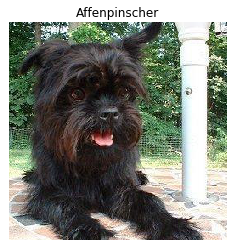

In [72]:
imshow(img_process('dog_images/train/001.Affenpinscher/Affenpinscher_00001.jpg'), title='Affenpinscher')

In [73]:
VGG16_predict('dog_images/train/001.Affenpinscher/Affenpinscher_00001.jpg')

([252], ['affenpinscher, monkey pinscher, monkey dog'], [0.9544305205345154])

From the [dictionary](https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a): 252: 'affenpinscher, monkey pinscher, monkey dog',

### (IMPLEMENTATION) Write a Dog Detector

While looking at the [dictionary](https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a), you will notice that the categories corresponding to dogs appear in an uninterrupted sequence and correspond to dictionary keys 151-268, inclusive, to include all categories from `'Chihuahua'` to `'Mexican hairless'`.  Thus, in order to check to see if an image is predicted to contain a dog by the pre-trained VGG-16 model, we need only check if the pre-trained model predicts an index between 151 and 268 (inclusive).

Use these ideas to complete the `dog_detector` function below, which returns `True` if a dog is detected in an image (and `False` if not).

In [74]:
### returns "True" if a dog is detected in the image stored at img_path
def dog_detector(img_path):
    ## TODO: Complete the function.
    prediction = VGG16_predict(img_path)
    
    dog_detected = (prediction[0][0] in range(151, 269))
    
    return dog_detected

In [75]:
dog_detector('dog_images/train/001.Affenpinscher/Affenpinscher_00001.jpg')

True

### (IMPLEMENTATION) Assess the Dog Detector

__Question 2:__ Use the code cell below to test the performance of your `dog_detector` function.  
- What percentage of the images in `human_files_short` have a detected dog?  
- What percentage of the images in `dog_files_short` have a detected dog?

__Answer:__ 


In [76]:
### TODO: Test the performance of the dog_detector function
### on the images in human_files_short and dog_files_short.
def countDogs(ImageList):
    return [dog_detector(img) for img in ImageList]

In [77]:
%%time

human_dogs = countDogs(human_files_short)
dog_dogs = countDogs(dog_files_short)

print("{}% of dogs detected in human data".format(sum(human_dogs)))
print("{}% of dogs detected in dogs data".format(sum(dog_dogs)))

0% of dogs detected in human data
94% of dogs detected in dogs data
Wall time: 3min 42s


In [78]:
bad_human_dogs = [a for a, b in zip(human_files_short, human_dogs) if b == True]
bad_dog_dogs = [a for a, b in zip(dog_files_short, dog_dogs) if b == False]

In [79]:
for ii in range(len(bad_human_dogs)):
    print(bad_human_dogs[ii]) 

In [80]:
for ii in range(len(bad_dog_dogs)):
    print(bad_dog_dogs[ii]) 

dogImages\test\004.Akita\Akita_00262.jpg
dogImages\test\005.Alaskan_malamute\Alaskan_malamute_00386.jpg
dogImages\test\006.American_eskimo_dog\American_eskimo_dog_00452.jpg
dogImages\test\011.Australian_cattle_dog\Australian_cattle_dog_00728.jpg
dogImages\test\011.Australian_cattle_dog\Australian_cattle_dog_00761.jpg
dogImages\test\011.Australian_cattle_dog\Australian_cattle_dog_00792.jpg


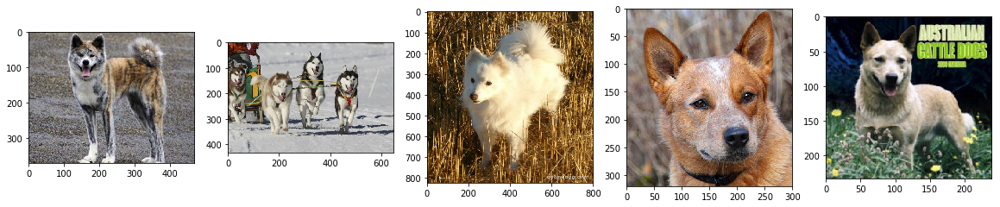

In [81]:
_, axes = plt.subplots(figsize=(20,6), ncols=5)

for ii in range(5):
    ax = axes[ii]
    img = cv2.imread(bad_dog_dogs[ii])
    cv_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    ax.imshow(cv_rgb)

We suggest VGG-16 as a potential network to detect dog images in your algorithm, but you are free to explore other pre-trained networks (such as [Inception-v3](http://pytorch.org/docs/master/torchvision/models.html#inception-v3), [ResNet-50](http://pytorch.org/docs/master/torchvision/models.html#id3), etc).  Please use the code cell below to test other pre-trained PyTorch models.  If you decide to pursue this _optional_ task, report performance on `human_files_short` and `dog_files_short`.

In [82]:
### (Optional) 
### TODO: Report the performance of another pre-trained network.
### Feel free to use as many code cells as needed.

In [83]:
del VGG16

---
<a id='step3'></a>
## Step 3: Create a CNN to Classify Dog Breeds (from Scratch)

Now that we have functions for detecting humans and dogs in images, we need a way to predict breed from images.  In this step, you will create a CNN that classifies dog breeds.  You must create your CNN _from scratch_ (so, you can't use transfer learning _yet_!), and you must attain a test accuracy of at least 10%.  In Step 4 of this notebook, you will have the opportunity to use transfer learning to create a CNN that attains greatly improved accuracy.

We mention that the task of assigning breed to dogs from images is considered exceptionally challenging.  To see why, consider that *even a human* would have trouble distinguishing between a Brittany and a Welsh Springer Spaniel.  

Brittany | Welsh Springer Spaniel
- | - 
<img src="images/Brittany_02625.jpg" width="100"> | <img src="images/Welsh_springer_spaniel_08203.jpg" width="200">

It is not difficult to find other dog breed pairs with minimal inter-class variation (for instance, Curly-Coated Retrievers and American Water Spaniels).  

Curly-Coated Retriever | American Water Spaniel
- | -
<img src="images/Curly-coated_retriever_03896.jpg" width="200"> | <img src="images/American_water_spaniel_00648.jpg" width="200">


Likewise, recall that labradors come in yellow, chocolate, and black.  Your vision-based algorithm will have to conquer this high intra-class variation to determine how to classify all of these different shades as the same breed.  

Yellow Labrador | Chocolate Labrador | Black Labrador
- | -
<img src="images/Labrador_retriever_06457.jpg" width="150"> | <img src="images/Labrador_retriever_06455.jpg" width="240"> | <img src="images/Labrador_retriever_06449.jpg" width="220">

We also mention that random chance presents an exceptionally low bar: setting aside the fact that the classes are slightly imabalanced, a random guess will provide a correct answer roughly 1 in 133 times, which corresponds to an accuracy of less than 1%.  

Remember that the practice is far ahead of the theory in deep learning.  Experiment with many different architectures, and trust your intuition.  And, of course, have fun!

### (IMPLEMENTATION) Specify Data Loaders for the Dog Dataset

Use the code cell below to write three separate [data loaders](http://pytorch.org/docs/stable/data.html#torch.utils.data.DataLoader) for the training, validation, and test datasets of dog images (located at `dogImages/train`, `dogImages/valid`, and `dogImages/test`, respectively).  You may find [this documentation on custom datasets](http://pytorch.org/docs/stable/torchvision/datasets.html) to be a useful resource.  If you are interested in augmenting your training and/or validation data, check out the wide variety of [transforms](http://pytorch.org/docs/stable/torchvision/transforms.html?highlight=transform)!

In [84]:
import os
from PIL import Image
from PIL import ImageFile
from torchvision import datasets, transforms
#ImageFile.LOAD_TRUNCATED_IMAGES = True

### TODO: Write data loaders for training, validation, and test sets
## Specify appropriate transforms, and batch_sizes

data_dir = 'dog_images/'
train_dir = data_dir + 'train/'
valid_dir = data_dir + 'valid/'
test_dir  = data_dir + 'test/'

batch_size = 32 # 20 # 24 # 32 #64 
num_workers = 4
image_size = 224 # 299 # 224  

global img_means, img_std

if img_means is not None:
    imgmeans = img_means
else: 
    imgmeans = [0.485, 0.456, 0.406]

if img_std is not None:
    imgstd = img_std
else: 
    imgstd = [0.229, 0.224, 0.225]
        
data_transforms = {
    'train': transforms.Compose([transforms.RandomAffine(15, translate=(0.1, 0.1), scale=(1.0, 1.5), 
                                                         shear=None, resample=Image.BILINEAR, fillcolor=0),
                                 transforms.Resize(image_size + (image_size//7), interpolation=Image.BILINEAR),
                                 transforms.CenterCrop(image_size),
                                 transforms.RandomHorizontalFlip(),
                                 transforms.ColorJitter(brightness=0.3, contrast=0.3, saturation=0.2, hue=0.05), 
                                 transforms.ToTensor(),
                                 transforms.Normalize(imgmeans, imgstd)
                                ]), 
    'valid': transforms.Compose([transforms.Resize(image_size + (image_size//7)),
                                 transforms.CenterCrop(image_size),
                                 transforms.ToTensor(),
                                transforms.Normalize(imgmeans, imgstd)
                                ]),
    'test' : transforms.Compose([transforms.Resize(image_size + (image_size//7)),
                                 transforms.CenterCrop(image_size),
                                 transforms.ToTensor(),
                                 transforms.Normalize(imgmeans, imgstd)
                                ])
}    

image_datasets = {x: datasets.ImageFolder(os.path.join(data_dir, x),
                                          data_transforms[x])
                  for x in ['train', 'valid', 'test']}

class_names = image_datasets['train'].classes
dataset_sizes = {x: len(image_datasets[x]) for x in ['train', 'valid', 'test']}

loaders_scratch = {x: torch.utils.data.DataLoader(image_datasets[x], 
                                              batch_size=batch_size,
                                              shuffle=False if x[:4]=='test' else True, 
                                              num_workers=num_workers)
              for x in ['train', 'valid', 'test']}

In [85]:
class_names

['001.Affenpinscher',
 '002.Afghan_hound',
 '003.Airedale_terrier',
 '004.Akita',
 '005.Alaskan_malamute',
 '006.American_eskimo_dog',
 '007.American_foxhound',
 '008.American_staffordshire_terrier',
 '009.American_water_spaniel',
 '010.Anatolian_shepherd_dog',
 '011.Australian_cattle_dog',
 '012.Australian_shepherd',
 '013.Australian_terrier',
 '014.Basenji',
 '015.Basset_hound',
 '016.Beagle',
 '017.Bearded_collie',
 '018.Beauceron',
 '019.Bedlington_terrier',
 '020.Belgian_malinois',
 '021.Belgian_sheepdog',
 '022.Belgian_tervuren',
 '023.Bernese_mountain_dog',
 '024.Bichon_frise',
 '025.Black_and_tan_coonhound',
 '026.Black_russian_terrier',
 '027.Bloodhound',
 '028.Bluetick_coonhound',
 '029.Border_collie',
 '030.Border_terrier',
 '031.Borzoi',
 '032.Boston_terrier',
 '033.Bouvier_des_flandres',
 '034.Boxer',
 '035.Boykin_spaniel',
 '036.Briard',
 '037.Brittany',
 '038.Brussels_griffon',
 '039.Bull_terrier',
 '040.Bulldog',
 '041.Bullmastiff',
 '042.Cairn_terrier',
 '043.Canaan_do

In [86]:
class_len = len(class_names)
class_len

133

In [87]:
dataset_sizes

{'train': 6679, 'valid': 835, 'test': 836}

Create a tensor of class weights in case I want to cope with class imbalances...

In [88]:
from collections import defaultdict
class_counts = defaultdict(int)
for _, c in image_datasets["train"].imgs:
    class_counts[c] += 1

class_weights = [1-(float(class_counts[class_id])/len(image_datasets["train"].imgs))
                 for class_id in range(len(image_datasets["train"].classes))]
class_weights = torch.FloatTensor(class_weights)
class_weights.to(device)

tensor([0.9904, 0.9913, 0.9922, 0.9906, 0.9885, 0.9904, 0.9925, 0.9901, 0.9949,
        0.9925, 0.9901, 0.9901, 0.9931, 0.9897, 0.9891, 0.9912, 0.9907, 0.9925,
        0.9928, 0.9907, 0.9904, 0.9930, 0.9903, 0.9907, 0.9945, 0.9939, 0.9904,
        0.9948, 0.9889, 0.9922, 0.9916, 0.9903, 0.9933, 0.9904, 0.9921, 0.9903,
        0.9925, 0.9915, 0.9897, 0.9921, 0.9897, 0.9906, 0.9925, 0.9904, 0.9921,
        0.9900, 0.9919, 0.9919, 0.9925, 0.9925, 0.9907, 0.9927, 0.9930, 0.9915,
        0.9925, 0.9903, 0.9894, 0.9925, 0.9930, 0.9910, 0.9909, 0.9921, 0.9921,
        0.9942, 0.9937, 0.9951, 0.9949, 0.9906, 0.9924, 0.9930, 0.9907, 0.9928,
        0.9937, 0.9939, 0.9934, 0.9904, 0.9936, 0.9940, 0.9912, 0.9931, 0.9916,
        0.9909, 0.9931, 0.9925, 0.9945, 0.9921, 0.9901, 0.9924, 0.9921, 0.9913,
        0.9915, 0.9934, 0.9948, 0.9934, 0.9927, 0.9936, 0.9925, 0.9933, 0.9937,
        0.9949, 0.9928, 0.9957, 0.9913, 0.9937, 0.9954, 0.9925, 0.9931, 0.9961,
        0.9933, 0.9951, 0.9934, 0.9919, 

**Question 3:** Describe your chosen procedure for preprocessing the data. 
- How does your code resize the images (by cropping, stretching, etc)?  What size did you pick for the input tensor, and why?
- Did you decide to augment the dataset?  If so, how (through translations, flips, rotations, etc)?  If not, why not?


**Answer**:  

The dataloaders process images via Pytorch datasets, which incorporate Pytorch transforms on the images.

An image size of 180x180 was chosen as a smaller size allows for more reasonable batch sizes and faster processing, important when testing a network being trained from scratch. I may later adjust this up to 224x224 to make a comparison to the VGG16 network.

Each transforms resizes images to a maximum that allows for a subsequent center crop to reduce the image size to the desired value.

A custom normalisation can be used via the variables img_means and img_std, but ImageNet normalization is used by default if these variables are None.

Additionally, the train transforms employs image augmentation which incorporates RandomAffine for rotation and stretching the image, and uses color jitter to introduce color and brightness variations.

A tensor of class weights was created in case it's required to offset class imbalances.

I am using num_workers at 0 in the Dog Project workspace as I get an error allocating memory with a higher setting. On my personal system I use 4, which loads the data 6 times faster...

### Preparation and notes for the CNN construction...

#### FASTAI CNN head structure
[What goes on behind in the fastai library?](https://forums.fast.ai/t/lesson-1-learner-what-goes-on-behind-in-the-fastai-library/29346)  
[What is the distinct usage of the AdaptiveConcatPool2d layer?](https://forums.fast.ai/t/what-is-the-distinct-usage-of-the-adaptiveconcatpool2d-layer/7600/3)

In [89]:
# Adapted from fastai...
import torch.nn as nn

class AdaptiveConcatPool2d(nn.Module):
    def __init__(self, sz=None):
        super().__init__()
        sz = sz or (1,1)
        self.ap = nn.AdaptiveAvgPool2d(sz)
        self.mp = nn.AdaptiveMaxPool2d(sz)
    def forward(self, x): return torch.cat([self.mp(x), self.ap(x)], 1)

https://discuss.pytorch.org/t/non-legacy-view-module/131/8

In [90]:
class Flatten(nn.Module):
    def __init__(self):
        super(Flatten, self).__init__()

    def forward(self, x):
        x = x.view(x.size(0), -1)
        return x

See https://spandan-madan.github.io/A-Collection-of-important-tasks-in-pytorch/

### (IMPLEMENTATION) Model Architecture

Create a CNN to classify dog breed.  Use the template in the code cell below.

https://towardsdatascience.com/build-your-first-deep-learning-classifier-using-tensorflow-dog-breed-example-964ed0689430

### 6 layer CNN

## 3 layer CNN 

In [91]:
del model_scratch

In [92]:
import torch.nn as nn
import torch.nn.functional as F

# define the CNN architecture
class Net(nn.Module):
    ### TODO: choose an architecture, and complete the class
    def __init__(self, num_classes=133):
        super(Net, self).__init__()
        ## Define layers of a CNN
        self.layer1 = nn.Sequential(
            nn.Conv2d(3, 32, kernel_size=5, stride=1, padding=1, bias=False),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2, padding=0)
        )
        self.layer2 = nn.Sequential(
            nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1, bias=False),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=1, padding=0)
        )
        self.layer3 = nn.Sequential(
            nn.Conv2d(64, 96, kernel_size=3, stride=1, padding=1, bias=False),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=1, padding=0)
        )
        self.classifier = nn.Sequential(
            AdaptiveConcatPool2d(),
            Flatten(),
            nn.BatchNorm1d(96*2, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True),
            nn.Dropout(p=0.25),
            nn.Linear(in_features=96*2, out_features=512, bias=True),
            nn.ReLU(),
            nn.BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True),
            nn.Dropout(p=0.25),
            nn.Linear(in_features=512, out_features=num_classes, bias=True)
        )    
        
        
    def forward(self, x):
        ## Define forward behavior
        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.classifier(x)

        return x

#-#-# You so NOT have to modify the code below this line. #-#-#

# instantiate the CNN
model_scratch = Net()

# move tensors to GPU if CUDA is available
if use_cuda:
    model_scratch.cuda()

In [93]:
print(model_scratch)

Net(
  (layer1): Sequential(
    (0): Conv2d(3, 32, kernel_size=(5, 5), stride=(1, 1), padding=(1, 1), bias=False)
    (1): ReLU()
    (2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (layer2): Sequential(
    (0): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (1): ReLU()
    (2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (layer3): Sequential(
    (0): Conv2d(64, 96, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (1): ReLU()
    (2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (classifier): Sequential(
    (0): AdaptiveConcatPool2d(
      (ap): AdaptiveAvgPool2d(output_size=(1, 1))
      (mp): AdaptiveMaxPool2d(output_size=(1, 1))
    )
    (1): Flatten()
    (2): BatchNorm1d(192, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): Dropout(p=0.25)
    (4): Linear(in_features=192, out_features=512, b

## 3 layer CNN with starting kernel 5 and 48 nodes

In [94]:
del model_scratch

In [95]:
import torch.nn as nn
import torch.nn.functional as F

# define the CNN architecture
class Net(nn.Module):
    ### TODO: choose an architecture, and complete the class
    def __init__(self, num_classes=133):
        super(Net, self).__init__()
        ## Define layers of a CNN
        self.layer1 = nn.Sequential(
            nn.Conv2d(3, 48, kernel_size=5, stride=1, padding=2, bias=False),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2, padding=0)
        )
        self.layer2 = nn.Sequential(
            nn.Conv2d(48, 96, kernel_size=3, stride=1, padding=1, bias=False),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=1, padding=0)
        )
        self.layer3 = nn.Sequential(
            nn.Conv2d(96, 128, kernel_size=3, stride=1, padding=1, bias=False),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=1, padding=0)
        )
        self.classifier = nn.Sequential(
            AdaptiveConcatPool2d(),
            Flatten(),
            nn.BatchNorm1d(128*2, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True),
            nn.Dropout(p=0.25),
            nn.Linear(in_features=128*2, out_features=512, bias=True),
            nn.ReLU(),
            nn.BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True),
            nn.Dropout(p=0.25),
            nn.Linear(in_features=512, out_features=num_classes, bias=True)
        )    
        
        
    def forward(self, x):
        ## Define forward behavior
        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.classifier(x)

        return x

#-#-# You so NOT have to modify the code below this line. #-#-#

# instantiate the CNN
model_scratch = Net()

# move tensors to GPU if CUDA is available
if use_cuda:
    model_scratch.cuda()

In [96]:
print(model_scratch)

Net(
  (layer1): Sequential(
    (0): Conv2d(3, 48, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2), bias=False)
    (1): ReLU()
    (2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (layer2): Sequential(
    (0): Conv2d(48, 96, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (1): ReLU()
    (2): MaxPool2d(kernel_size=2, stride=1, padding=0, dilation=1, ceil_mode=False)
  )
  (layer3): Sequential(
    (0): Conv2d(96, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (1): ReLU()
    (2): MaxPool2d(kernel_size=2, stride=1, padding=0, dilation=1, ceil_mode=False)
  )
  (classifier): Sequential(
    (0): AdaptiveConcatPool2d(
      (ap): AdaptiveAvgPool2d(output_size=(1, 1))
      (mp): AdaptiveMaxPool2d(output_size=(1, 1))
    )
    (1): Flatten()
    (2): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): Dropout(p=0.25)
    (4): Linear(in_features=256, out_features=512, 

In [97]:
summary(model_scratch, (3, 224, 224))

## 3 layer CNN with 2 starting kernel 3 and 48 nodes

In [98]:
del model_scratch

In [99]:
import torch.nn as nn
import torch.nn.functional as F

# define the CNN architecture
class Net(nn.Module):
    ### TODO: choose an architecture, and complete the class
    def __init__(self, num_classes=133):
        super(Net, self).__init__()
        ## Define layers of a CNN
        self.layer1 = nn.Sequential(
            nn.Conv2d(3, 48, kernel_size=3, stride=1, padding=1, bias=False),
            nn.ReLU(),
            nn.Conv2d(48, 48, kernel_size=3, stride=1, padding=1, bias=False),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=1, padding=0)
        )
        self.layer2 = nn.Sequential(
            nn.Conv2d(48, 96, kernel_size=3, stride=1, padding=1, bias=False),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=1, padding=0)
        )
        self.layer3 = nn.Sequential(
            nn.Conv2d(96, 128, kernel_size=3, stride=1, padding=1, bias=False),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=1, padding=0)
        )
        self.classifier = nn.Sequential(
            AdaptiveConcatPool2d(),
            Flatten(),
            nn.BatchNorm1d(128*2, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True),
            nn.Dropout(p=0.25),
            nn.Linear(in_features=128*2, out_features=512, bias=True),
            nn.ReLU(),
            nn.BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True),
            nn.Dropout(p=0.25),
            nn.Linear(in_features=512, out_features=num_classes, bias=True)
        )    
        
        
    def forward(self, x):
        ## Define forward behavior
        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.classifier(x)

        return x

#-#-# You so NOT have to modify the code below this line. #-#-#

# instantiate the CNN
model_scratch = Net()

# move tensors to GPU if CUDA is available
if use_cuda:
    model_scratch.cuda()

In [100]:
print(model_scratch)

Net(
  (layer1): Sequential(
    (0): Conv2d(3, 48, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (1): ReLU()
    (2): Conv2d(48, 48, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (3): ReLU()
    (4): MaxPool2d(kernel_size=2, stride=1, padding=0, dilation=1, ceil_mode=False)
  )
  (layer2): Sequential(
    (0): Conv2d(48, 96, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (1): ReLU()
    (2): MaxPool2d(kernel_size=2, stride=1, padding=0, dilation=1, ceil_mode=False)
  )
  (layer3): Sequential(
    (0): Conv2d(96, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (1): ReLU()
    (2): MaxPool2d(kernel_size=2, stride=1, padding=0, dilation=1, ceil_mode=False)
  )
  (classifier): Sequential(
    (0): AdaptiveConcatPool2d(
      (ap): AdaptiveAvgPool2d(output_size=(1, 1))
      (mp): AdaptiveMaxPool2d(output_size=(1, 1))
    )
    (1): Flatten()
    (2): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True,

## 3 layer CNN with batchnorm

In [101]:
del model_scratch

In [102]:
import torch.nn as nn
import torch.nn.functional as F

# define the CNN architecture
class Net(nn.Module):
    ### TODO: choose an architecture, and complete the class
    def __init__(self, num_classes=133):
        super(Net, self).__init__()
        ## Define layers of a CNN
        self.layer1 = nn.Sequential(
            nn.Conv2d(3, 32, kernel_size=5, stride=1, padding=1, bias=False),
            nn.ReLU(),
            nn.BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True),
            nn.MaxPool2d(kernel_size=2, stride=2, padding=0)
        )
        self.layer2 = nn.Sequential(
            nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1, bias=False),
            nn.ReLU(),
            nn.BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True),
            nn.MaxPool2d(kernel_size=2, stride=1, padding=0)
        )
        self.layer3 = nn.Sequential(
            nn.Conv2d(64, 96, kernel_size=3, stride=1, padding=1, bias=False),
            nn.ReLU(),
            nn.BatchNorm2d(96, eps=1e-05, momentum=0.1, affine=True), 
            nn.MaxPool2d(kernel_size=2, stride=1, padding=0)
        )
        self.classifier = nn.Sequential(
            AdaptiveConcatPool2d(),
            Flatten(),
            nn.BatchNorm1d(96*2, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True),
            nn.Dropout(p=0.25),
            nn.Linear(in_features=96*2, out_features=512, bias=True),
            nn.ReLU(),
            nn.BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True),
            nn.Dropout(p=0.25),
            nn.Linear(in_features=512, out_features=num_classes, bias=True)
        )    
        
        
    def forward(self, x):
        ## Define forward behavior
        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.classifier(x)

        return x

#-#-# You so NOT have to modify the code below this line. #-#-#

# instantiate the CNN
model_scratch = Net()

# move tensors to GPU if CUDA is available
if use_cuda:
    model_scratch.cuda()

In [103]:
print(model_scratch)

Net(
  (layer1): Sequential(
    (0): Conv2d(3, 32, kernel_size=(5, 5), stride=(1, 1), padding=(1, 1), bias=False)
    (1): ReLU()
    (2): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (layer2): Sequential(
    (0): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (1): ReLU()
    (2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (layer3): Sequential(
    (0): Conv2d(64, 96, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (1): ReLU()
    (2): BatchNorm2d(96, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (classifier): Sequential(
    (0): AdaptiveConcatPool2d(
      (ap): AdaptiveAvgPo

## 4 layer CNN 

In [104]:
del model_scratch

In [105]:
import torch.nn as nn
import torch.nn.functional as F

# define the CNN architecture
class Net(nn.Module):
    ### TODO: choose an architecture, and complete the class
    def __init__(self, num_classes=133):
        super(Net, self).__init__()
        ## Define layers of a CNN
        self.layer1 = nn.Sequential(
            nn.Conv2d(3, 32, kernel_size=5, stride=1, padding=1, bias=False),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2, padding=0)
        )
        self.layer2 = nn.Sequential(
            nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1, bias=False),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2, padding=0)
        )
        self.layer3 = nn.Sequential(
            nn.Conv2d(64, 96, kernel_size=3, stride=1, padding=1, bias=False),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2, padding=0)
        )
        self.layer4 = nn.Sequential(
            nn.Conv2d(96, 128, kernel_size=3, stride=1, padding=1, bias=False),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2, padding=0)
        )
        self.classifier = nn.Sequential(
            AdaptiveConcatPool2d(),
            Flatten(),
            nn.BatchNorm1d(128*2, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True),
            nn.Dropout(p=0.25),
            nn.Linear(in_features=128*2, out_features=512, bias=True),
            nn.ReLU(),
            nn.BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True),
            nn.Dropout(p=0.25),
            nn.Linear(in_features=512, out_features=num_classes, bias=True)
        )    
        
        
    def forward(self, x):
        ## Define forward behavior
        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)
        x = self.classifier(x)

        return x

#-#-# You so NOT have to modify the code below this line. #-#-#

# instantiate the CNN
model_scratch = Net()

# move tensors to GPU if CUDA is available
if use_cuda:
    model_scratch.cuda()

In [106]:
print(model_scratch)

Net(
  (layer1): Sequential(
    (0): Conv2d(3, 32, kernel_size=(5, 5), stride=(1, 1), padding=(1, 1), bias=False)
    (1): ReLU()
    (2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (layer2): Sequential(
    (0): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (1): ReLU()
    (2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (layer3): Sequential(
    (0): Conv2d(64, 96, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (1): ReLU()
    (2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (layer4): Sequential(
    (0): Conv2d(96, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (1): ReLU()
    (2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (classifier): Sequential(
    (0): AdaptiveConcatPool2d(
      (ap): AdaptiveAvgPool2d(output_size=(1, 1))
      (mp): AdaptiveMaxPoo

## Another model as suggested by MSJose

In [107]:
del model_scratch

In [108]:
import torch.nn as nn
import torch.nn.functional as F

class Net(nn.Module):
    def __init__(self, num_classes=133):
        super(Net, self).__init__()
        self.conv1 = nn.Conv2d(  3,  32, 3, stride=2, padding=1)
        self.conv2 = nn.Conv2d( 32,  64, 3, stride=2, padding=1)
        self.conv3 = nn.Conv2d( 64, 128, 3, padding=1)
        self.conv4 = nn.Conv2d(128, 256, 2, stride=2, padding=1)
        self.pool = nn.MaxPool2d(2)
        self.dropout = nn.Dropout(0.25)
        self.fc1 = nn.Linear(4*4*256, 1024)
        self.fc2 = nn.Linear( 1024, 512)
        self.fc3 = nn.Linear(  512, num_classes)

    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x)))
        x = self.pool(F.relu(self.conv2(x)))
        x = self.pool(F.relu(self.conv3(x)))
        x = F.relu(self.conv4(x))

        x = x.view(-1, 4*4*256)
        x = F.relu(self.fc1(self.dropout(x)))
        x = F.relu(self.fc2(self.dropout(x)))
        x = self.fc3(self.dropout(x))

        return x

#-#-# You so NOT have to modify the code below this line. #-#-#

# instantiate the CNN
model_scratch = Net()

# move tensors to GPU if CUDA is available
if use_cuda:
    model_scratch.cuda()    

In [109]:
print(model_scratch)

Net(
  (conv1): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (conv3): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv4): Conv2d(128, 256, kernel_size=(2, 2), stride=(2, 2), padding=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (dropout): Dropout(p=0.25)
  (fc1): Linear(in_features=4096, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=512, bias=True)
  (fc3): Linear(in_features=512, out_features=133, bias=True)
)


In [110]:
summary(model_scratch, input_size=(3, 224, 224))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 32, 112, 112]             896
         MaxPool2d-2           [-1, 32, 56, 56]               0
            Conv2d-3           [-1, 64, 28, 28]          18,496
         MaxPool2d-4           [-1, 64, 14, 14]               0
            Conv2d-5          [-1, 128, 14, 14]          73,856
         MaxPool2d-6            [-1, 128, 7, 7]               0
            Conv2d-7            [-1, 256, 4, 4]         131,328
           Dropout-8                 [-1, 4096]               0
            Linear-9                 [-1, 1024]       4,195,328
          Dropout-10                 [-1, 1024]               0
           Linear-11                  [-1, 512]         524,800
          Dropout-12                  [-1, 512]               0
           Linear-13                  [-1, 133]          68,229
Total params: 5,012,933
Trainable param

__Question 4:__ Outline the steps you took to get to your final CNN architecture and your reasoning at each step.  

__Answer:__ 

### (IMPLEMENTATION) Specify Loss Function and Optimizer

Use the next code cell to specify a [loss function](http://pytorch.org/docs/stable/nn.html#loss-functions) and [optimizer](http://pytorch.org/docs/stable/optim.html).  Save the chosen loss function as `criterion_scratch`, and the optimizer as `optimizer_scratch` below.

In [111]:
learning_rate = 1e-5

In [112]:
# For MSJose's suggested model
learning_rate = 0.05

**Set use_weights to True if wanting to use the weights to compensate for class imbalance**

In [113]:
use_weights = False

In [114]:
import torch.optim as optim

### TODO: select loss function
if use_weights:
    criterion_scratch = nn.CrossEntropyLoss(weight=class_weights.to(device), reduction='sum')
else:    
    criterion_scratch = nn.CrossEntropyLoss()

### TODO: select optimizer
optimizer_scratch = torch.optim.Adam(model_scratch.parameters(), lr=learning_rate)

## Establish best learning rate

Code adapted from Sylvain Gugger's [How Do You Find A Good Learning Rate](https://sgugger.github.io/how-do-you-find-a-good-learning-rate.html)

In [115]:
import math

def find_lr(model, optimizer, criterion, dataloaders, init_value = 1e-8, final_value=10., beta = 0.98):
    num = len(dataloaders['train'])-1
    mult = (final_value / init_value) ** (1/num)
    lr = init_value
    optimizer.param_groups[0]['lr'] = lr
    avg_loss = 0.
    best_loss = 0.
    batch_num = 0
    losses = []
    log_lrs = []
    
    for images, labels in dataloaders['train']:
        batch_num += 1
        
        #Get the loss for this mini-batch of images/outputs
        images = images.to(device)
        labels = labels.to(device)
        
        optimizer.zero_grad()
        output = model.forward(images)
        
        loss = criterion(output, labels)
        
        #Compute the smoothed loss
        avg_loss = beta * avg_loss + (1-beta) * loss.item()
        smoothed_loss = avg_loss / (1 - beta**batch_num)
        
        #Stop if the loss is exploding
        if batch_num > 1 and smoothed_loss > 4 * best_loss:
            return log_lrs, losses
        
        #Record the best loss
        if smoothed_loss < best_loss or batch_num==1:
            best_loss = smoothed_loss
        
        #Store the values
        losses.append(smoothed_loss)
        log_lrs.append(math.log10(lr))
        
        #Do the SGD step
        loss.backward()
        optimizer.step()
        
        #Update the lr for the next step
        lr *= mult
        optimizer.param_groups[0]['lr'] = lr
    
    return log_lrs, losses

In [116]:
logs, losses = find_lr(model_scratch, optimizer_scratch, criterion_scratch, loaders_scratch)

## MSJose's suggested model

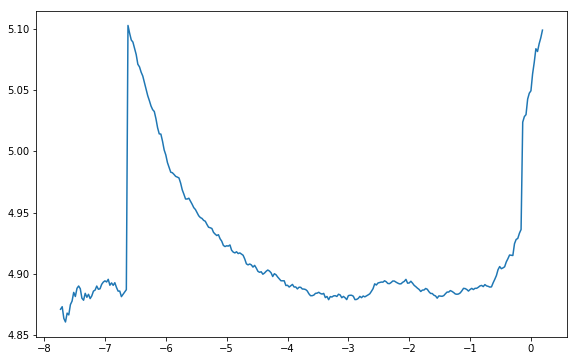

In [117]:
# MSJose's suggested model after aborting training after 26 epochs
plt.rcParams['figure.figsize'] = [9.5, 6]

plt.plot(logs[10:-5],losses[10:-5])

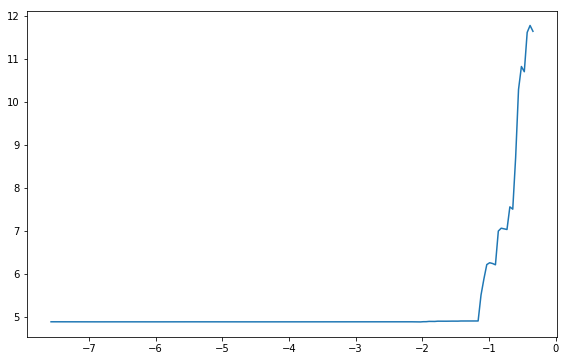

In [118]:
# MSJose's suggested model
plt.rcParams['figure.figsize'] = [9.5, 6]

plt.plot(logs[10:-5],losses[10:-5])

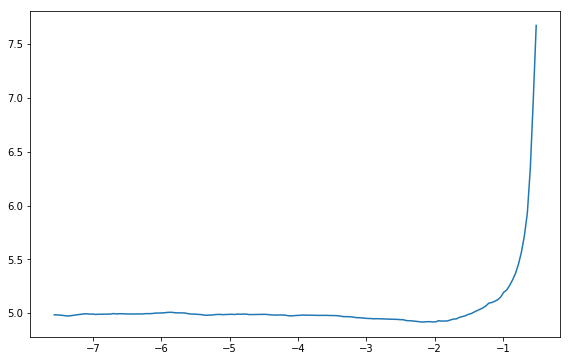

In [119]:
plt.rcParams['figure.figsize'] = [9.5, 6]

plt.plot(logs[10:-5],losses[10:-5])

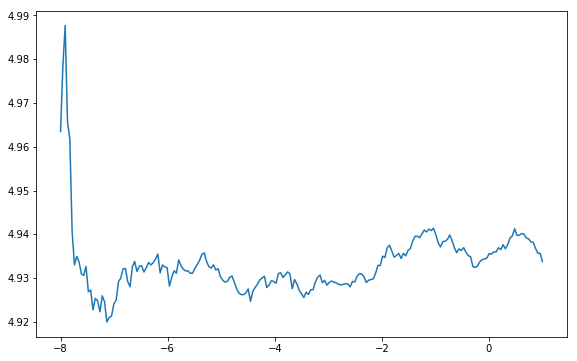

In [120]:
plt.rcParams['figure.figsize'] = [9.5, 6]

plt.plot(logs,losses)

In [121]:
print("{:.10f}".format(1e-05))
print("{:.10f}".format(1e-06))
print("{:.10f}".format(5e-06))
print("{:.10f}".format(7e-06))

0.0000100000
0.0000010000
0.0000050000
0.0000070000


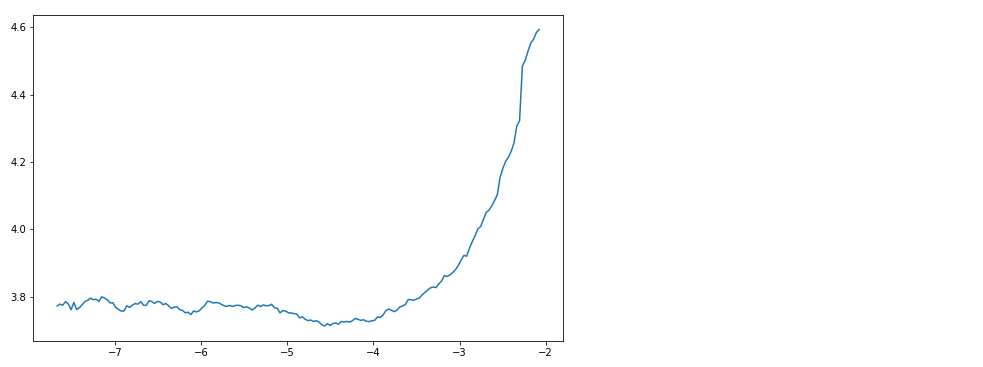

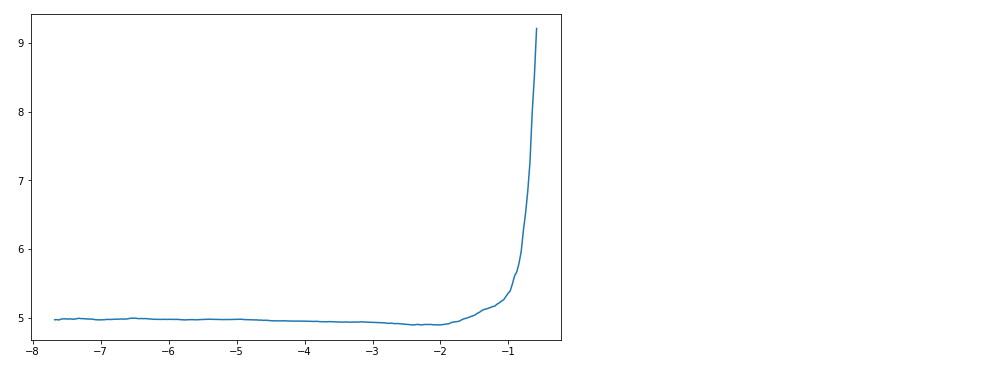

In [122]:
plt.rcParams['figure.figsize'] = [9.5, 6]

plt.plot(logs,losses)

The learning rate finder suggests a rate between `1e-5` and `1e-6`...

In [123]:
print("{:.10f}".format(1e-04))
print("{:.10f}".format(1e-05))
print("{:.10f}".format(5e-05))
print("{:.10f}".format(1e-06))
print("{:.10f}".format(5e-06))
print("{:.10f}".format(7e-06))

0.0001000000
0.0000100000
0.0000500000
0.0000010000
0.0000050000
0.0000070000


In [124]:
learning_rate = 5e-08

In [125]:
learning_rate = 7e-06

In [126]:
learning_rate = 1e-06

**Resetting optimzer to use learning rate calculated by the finder...**

In [127]:
optimizer_scratch = torch.optim.Adam(model_scratch.parameters(), lr=learning_rate)

In [128]:
get_learning_rate(optimizer_scratch)

[1e-08]

Some of the code used below was adapted from https://pytorch.org/tutorials/beginner/finetuning_torchvision_models_tutorial.html

**Run next cell before running def train below, and to clear variables for a new run...**

In [129]:
train_losses, valid_losses, train_acc_history, val_acc_history, lr_hist = [], [], [], [], [] 
best_acc, best_val_epoch, best_acc_epoch, epoch_loss_min = 0.0, 0, 0, np.Inf

### (IMPLEMENTATION) Train and Validate the Model

Train and validate your model in the code cell below.  [Save the final model parameters](http://pytorch.org/docs/master/notes/serialization.html) at filepath `'model_scratch.pt'`.

In [130]:
import time

In [131]:
def train(n_epochs, loaders, model, optimizer, criterion, use_cuda, save_path, 
          use_weights=False):
    """returns trained model"""

    global train_losses, valid_losses, val_acc_history, lr_hist
    global best_acc, best_val_epoch, best_acc_epoch, epoch_loss_min
    
    curr_lr = get_learning_rate(optimizer)
    
    best_model_wts = copy.deepcopy(model.state_dict())
    best_optim_wts = copy.deepcopy(optimizer.state_dict())
    
    since = time.time()

    # initialize tracker for minimum validation loss
    valid_loss_min = np.Inf 
    # also track maximum accuracy...
    valid_acc_max  = 0
    
    for epoch in range(1, n_epochs+1):
        # initialize variables to monitor training and validation loss
        train_loss = 0.0
        valid_loss = 0.0
        valid_acc  = 0.0
        
        ###################
        # train the model #
        ###################
        model.train()
        
        running_loss = 0.0
        running_corrects = 0        

        for batch_idx, (data, target) in enumerate(loaders['train']):
            # move to GPU
            if use_cuda:
                data, target = data.cuda(), target.cuda()
                
            ## find the loss and update the model parameters accordingly
            optimizer.zero_grad()
            
            outputs = model(data)
            
            loss = criterion(outputs, target)
            
            _, preds = torch.max(outputs, 1)
            
            loss.backward()
            optimizer.step()
            
            running_loss += loss.item() * (1 if use_weights==True else data.size(0))
            running_corrects += torch.sum(preds == target.data)
                
            ## record the average training loss, using something like
            train_loss = train_loss + ((1 / (batch_idx + 1)) * (loss.data - train_loss))
            
        epoch_loss = running_loss / dataset_sizes['train']
        epoch_acc = running_corrects.double() / dataset_sizes['train']

        train_losses.append(epoch_loss)
        train_acc_history.append(epoch_acc)
        
        curr_lr = get_learning_rate(optimizer)
        lr_hist.append(curr_lr)        

        ######################    
        # validate the model #
        ######################
        model.eval()

        running_loss = 0.0
        running_corrects = 0
            
        for batch_idx, (data, target) in enumerate(loaders['valid']):
            # move to GPU
            if use_cuda:
                data, target = data.cuda(), target.cuda()
            
            ## update the average validation loss
            val_outputs = model(data)
            
            val_loss = criterion(val_outputs, target)

            _, preds = torch.max(val_outputs, 1)
            
            running_loss += val_loss.item() * (1 if use_weights==True else data.size(0))
            running_corrects += torch.sum(preds == target.data)
            
            valid_loss = valid_loss + ((1 / (batch_idx + 1)) * (val_loss.data - valid_loss))
  
        epoch_val_loss = running_loss / dataset_sizes['valid']
        epoch_val_acc = running_corrects.double() / dataset_sizes['valid']
        
        valid_losses.append(epoch_val_loss)
        val_acc_history.append(epoch_val_acc.item()) 
        
        # print training/validation statistics 
        print('Epoch: {} \tTraining Loss: {:.6f} \tValidation Loss: {:.6f}'.format(
            epoch, 
            train_loss,
            valid_loss
            ))
# Tested and these calculations render identical results...        
#         print('Epoch: {} \tTraining Loss: {:.6f} \tValidation Loss: {:.6f}'.format(
#             epoch, 
#             epoch_loss,
#             epoch_val_loss
#             ))        
        print('Epoch: {} \tTraining Accuracy: {:.6f} \tValidation Accuracy: {:.6f}'.format(
            epoch, 
            epoch_acc,
            epoch_val_acc
            ))  
        
        ## TODO: save the model if validation loss has decreased
        if epoch_val_acc > best_acc:
            filename = save_path + '_acc' # + "_" + str(epoch)
            print('Accuracy has increased ({:.6f} --> {:.6f})  Saving model as {}...'.format(
                best_acc, epoch_val_acc, filename))            

            best_acc_epoch = epoch 
            best_acc = epoch_val_acc
            
            best_model_wts = copy.deepcopy(model.state_dict())
            best_optim_wts = copy.deepcopy(optimizer.state_dict())
            
            torch.save(best_model_wts, filename + '.pt')
            torch.save(best_optim_wts, filename + '_optimizer.pt') 
                
        if epoch_val_loss <= epoch_loss_min:
            filename = save_path + '_val' # + "_" + str(epoch)
            print('Validation loss decreased ({:.6f} --> {:.6f})  Saving model as {}...'.format(
            epoch_loss_min, epoch_val_loss, filename))
                
            best_val_epoch = epoch           
            epoch_loss_min = epoch_val_loss
            
            torch.save(model.state_dict(), filename + '.pt')
            torch.save(optimizer.state_dict(), filename + '_optimizer.pt')            
        
        print()
        
    time_elapsed = time.time() - since
    
    print()
    print('Training complete in {:.0f}m {:.0f}s'.format(
        time_elapsed // 60, time_elapsed % 60))
    print('Best validation accuracy: {:4f}'.format(best_acc))
    print('Best accuracy epoch     : {}'.format(best_acc_epoch))
    print('Best validation loss    : {:4f}'.format(epoch_loss_min))
    print('Best validation epoch   : {}'.format(best_val_epoch))
    
    # load best accuracy model weights
    model.load_state_dict(best_model_wts)
    optimizer.load_state_dict(best_optim_wts)

#     # Save to required model_scratch
#     torch.save(best_model_wts, 'model_scratch.pt')
#     torch.save(best_optim_wts, 'model_scratch_optimizer.pt') 
    
    # return trained model
    return model

## Reload previous best model if required...

**Using reloadModel to restore model and optimizer from best accuracy state_dicts, and also restore tracking values...**

In [132]:
def reloadModel(model, optimizer, state_dicts_name='model_d_502.pth', learning_rate=1e-05, isV1=False, resetarray=True):
    
    global train_losses, valid_losses, val_acc_history, lr_hist
    global best_acc, best_acc_epoch, best_val_epoch, epoch_loss_min

    state_dicts = torch.load(state_dicts_name, map_location=lambda storage, loc: storage)   

    model_statedict = state_dicts['model_statedict']
    optimizer_statedict = state_dicts['optimizer_statedict']
        
    if isV1:
        model_dict = model.state_dict()
        # 1. filter out unnecessary keys
        pretrained_dict = {k: v for k, v in model_statedict.items() if k in model_dict}
        # 2. overwrite entries in the existing state dict
        model_dict.update(pretrained_dict) 
        # 3. load the new state dict
        model.load_state_dict(pretrained_dict)
    else:    
        model.load_state_dict(model_statedict)
        
    parameters = filter(lambda p: p.requires_grad, model.parameters())
    optimizer  = torch.optim.Adam(parameters, lr=learning_rate)
    
    optimizer.load_state_dict(optimizer_statedict)    

    best_acc_epoch = state_dicts['best_acc_epoch']
    best_val_epoch = state_dicts['best_val_epoch']
    
    if resetarray:
        train_losses = state_dicts['train_losses'][:best_acc_epoch]
        valid_losses = state_dicts['valid_losses'][:best_acc_epoch]
        val_acc_history = state_dicts['val_acc_history'][:best_acc_epoch]
        #train_acc_history = state_dicts['train_acc_history'][:best_acc_epoch]
        
        best_acc = val_acc_history[-1]
        epoch_loss_min = valid_losses[-1]
    else:
        train_losses = state_dicts['train_losses']
        valid_losses = state_dicts['valid_losses']
        val_acc_history = state_dicts['val_acc_history']
        #train_acc_history = state_dicts['train_acc_history']
        
        best_acc = val_acc_history[best_acc_epoch]
        epoch_loss_min = valid_losses[best_val_epoch]

In [133]:
state_dicts_name = 'model_d_300.pth'
learning_rate=1e-05
reloadModel(model_scratch, optimizer_scratch, state_dicts_name, learning_rate)

In [134]:
state_dicts_name = 'model_d_460.pth'
learning_rate=1e-05
reloadModel(model_scratch, optimizer_scratch, state_dicts_name, learning_rate)

**...or, just reloading models and optimizer from either best accuracy or best validation state_dicts**

**Accuracy...**

In [135]:
best_model_wts = torch.load("model_scratch_acc.pt", map_location=lambda storage, loc: storage)
best_optim_wts = torch.load("model_scratch_acc_optimizer.pt", map_location=lambda storage, loc: storage)

**or Loss...**

In [136]:
best_model_wts = torch.load("model_scratch_val.pt", map_location=lambda storage, loc: storage)
best_optim_wts = torch.load("model_scratch_val_optimizer.pt", map_location=lambda storage, loc: storage)

In [137]:
optimizer_scratch.load_state_dict(best_optim_wts)

In [138]:
model_scratch.load_state_dict(best_model_wts)
model_scratch.eval();

When loading a state dict saved under Pytorch 1.0 in a Pytorch 0.4.0 environment an error occurs re unexpected keys:
```
RuntimeError: Error(s) in loading state_dict for Net:
	Unexpected key(s) in state_dict: "layer1.4.num_batches_tracked", "layer2.4.num_batches_tracked", "layer3.4.num_batches_tracked", "classifier.2.num_batches_tracked", "classifier.6.num_batches_tracked". 
```
Therefore, see [Loading part of a pre-trained model](https://discuss.pytorch.org/t/how-to-load-part-of-pre-trained-model/1113/2)

In [140]:
train_losses, valid_losses, train_acc_history, val_acc_history, lr_hist = [], [], [], [], [] 
best_acc, best_val_epoch, best_acc_epoch, epoch_loss_min = 0.0, 0, 0, np.Inf

In [141]:
# train the model
model_scratch = train(100, loaders_scratch, model_scratch, optimizer_scratch, 
                           criterion_scratch, use_cuda, 'model_scratch')

Epoch: 1 	Training Loss: 2.556600 	Validation Loss: 2.709807
Epoch: 1 	Training Accuracy: 0.349454 	Validation Accuracy: 0.329341
Accuracy has increased (0.322156 --> 0.329341)  Saving model as model_scratch_acc...

Epoch: 2 	Training Loss: 2.529886 	Validation Loss: 2.693639
Epoch: 2 	Training Accuracy: 0.356640 	Validation Accuracy: 0.326946

Epoch: 3 	Training Loss: 2.517095 	Validation Loss: 2.681422
Epoch: 3 	Training Accuracy: 0.354544 	Validation Accuracy: 0.331737
Accuracy has increased (0.329341 --> 0.331737)  Saving model as model_scratch_acc...

Epoch: 4 	Training Loss: 2.512076 	Validation Loss: 2.662762
Epoch: 4 	Training Accuracy: 0.361282 	Validation Accuracy: 0.319760

Epoch: 5 	Training Loss: 2.515176 	Validation Loss: 2.734705
Epoch: 5 	Training Accuracy: 0.357838 	Validation Accuracy: 0.340120
Accuracy has increased (0.331737 --> 0.340120)  Saving model as model_scratch_acc...

Epoch: 6 	Training Loss: 2.504296 	Validation Loss: 2.650676
Epoch: 6 	Training Accuracy: 

Validation loss decreased (2.453120 --> 2.442574)  Saving model as model_scratch_val...

Epoch: 98 	Training Loss: 2.276291 	Validation Loss: 2.449311
Epoch: 98 	Training Accuracy: 0.408295 	Validation Accuracy: 0.365269

Epoch: 99 	Training Loss: 2.282562 	Validation Loss: 2.468958
Epoch: 99 	Training Accuracy: 0.404552 	Validation Accuracy: 0.371257
Validation loss decreased (2.442574 --> 2.434461)  Saving model as model_scratch_val...

Epoch: 100 	Training Loss: 2.265157 	Validation Loss: 2.427968
Epoch: 100 	Training Accuracy: 0.409492 	Validation Accuracy: 0.378443


Training complete in 153m 38s
Best validation accuracy: 0.382036
Best accuracy epoch     : 88
Best validation loss    : 2.434461
Best validation epoch   : 99


## MSJose's model...

In [142]:
learning_rate = 1e-05
optimizer_scratch = torch.optim.Adam(model_scratch.parameters(), lr=learning_rate)

In [143]:
# restart MSJose model training after re-creating model and setting learning rate to 1e-05
model_scratch = train(100, loaders_scratch, model_scratch, optimizer_scratch, 
                           criterion_scratch, use_cuda, 'model_scratch_msj')

Epoch: 1 	Training Loss: 4.889379 	Validation Loss: 4.888379
Epoch: 1 	Training Accuracy: 0.007935 	Validation Accuracy: 0.008383
Accuracy has increased (0.000000 --> 0.008383)  Saving model as model_scratch_msj_acc...
Validation loss decreased (inf --> 4.887988)  Saving model as model_scratch_msj_val...

Epoch: 2 	Training Loss: 4.885382 	Validation Loss: 4.880887
Epoch: 2 	Training Accuracy: 0.010930 	Validation Accuracy: 0.010778
Accuracy has increased (0.008383 --> 0.010778)  Saving model as model_scratch_msj_acc...
Validation loss decreased (4.887988 --> 4.880489)  Saving model as model_scratch_msj_val...

Epoch: 3 	Training Loss: 4.871359 	Validation Loss: 4.860820
Epoch: 3 	Training Accuracy: 0.010331 	Validation Accuracy: 0.010778
Validation loss decreased (4.880489 --> 4.862034)  Saving model as model_scratch_msj_val...

Epoch: 4 	Training Loss: 4.853985 	Validation Loss: 4.841761
Epoch: 4 	Training Accuracy: 0.013325 	Validation Accuracy: 0.011976
Accuracy has increased (0.01

Epoch: 66 	Training Accuracy: 0.068573 	Validation Accuracy: 0.074251
Validation loss decreased (4.192886 --> 4.187882)  Saving model as model_scratch_msj_val...

Epoch: 67 	Training Loss: 4.188920 	Validation Loss: 4.192327
Epoch: 67 	Training Accuracy: 0.064381 	Validation Accuracy: 0.083832
Accuracy has increased (0.079042 --> 0.083832)  Saving model as model_scratch_msj_acc...

Epoch: 68 	Training Loss: 4.186021 	Validation Loss: 4.181858
Epoch: 68 	Training Accuracy: 0.068873 	Validation Accuracy: 0.077844
Validation loss decreased (4.187882 --> 4.186539)  Saving model as model_scratch_msj_val...

Epoch: 69 	Training Loss: 4.184754 	Validation Loss: 4.208231
Epoch: 69 	Training Accuracy: 0.066926 	Validation Accuracy: 0.082635
Validation loss decreased (4.186539 --> 4.183644)  Saving model as model_scratch_msj_val...

Epoch: 70 	Training Loss: 4.181470 	Validation Loss: 4.185611
Epoch: 70 	Training Accuracy: 0.067226 	Validation Accuracy: 0.077844
Validation loss decreased (4.1836

In [144]:
# for interest, train another 100...
model_scratch = train(100, loaders_scratch, model_scratch, optimizer_scratch, 
                           criterion_scratch, use_cuda, 'model_scratch_msj_2')

Epoch: 1 	Training Loss: 4.079937 	Validation Loss: 4.078501
Epoch: 1 	Training Accuracy: 0.081449 	Validation Accuracy: 0.085030

Epoch: 2 	Training Loss: 4.067559 	Validation Loss: 4.124027
Epoch: 2 	Training Accuracy: 0.083995 	Validation Accuracy: 0.077844

Epoch: 3 	Training Loss: 4.065514 	Validation Loss: 4.132753
Epoch: 3 	Training Accuracy: 0.082348 	Validation Accuracy: 0.080240

Epoch: 4 	Training Loss: 4.056034 	Validation Loss: 4.132572
Epoch: 4 	Training Accuracy: 0.086839 	Validation Accuracy: 0.089820
Accuracy has increased (0.088623 --> 0.089820)  Saving model as model_scratch_msj_2_acc...

Epoch: 5 	Training Loss: 4.064059 	Validation Loss: 4.128477
Epoch: 5 	Training Accuracy: 0.083695 	Validation Accuracy: 0.085030

Epoch: 6 	Training Loss: 4.053667 	Validation Loss: 4.126761
Epoch: 6 	Training Accuracy: 0.080701 	Validation Accuracy: 0.089820
Validation loss decreased (4.109351 --> 4.103686)  Saving model as model_scratch_msj_2_val...

Epoch: 7 	Training Loss: 4.06

Epoch: 49 	Training Accuracy: 0.102111 	Validation Accuracy: 0.095808

Epoch: 50 	Training Loss: 3.899471 	Validation Loss: 4.081692
Epoch: 50 	Training Accuracy: 0.103459 	Validation Accuracy: 0.099401
Accuracy has increased (0.098204 --> 0.099401)  Saving model as model_scratch_msj_2_acc...
Validation loss decreased (4.046796 --> 4.046303)  Saving model as model_scratch_msj_2_val...

Epoch: 51 	Training Loss: 3.915178 	Validation Loss: 4.007411
Epoch: 51 	Training Accuracy: 0.101512 	Validation Accuracy: 0.094611

Epoch: 52 	Training Loss: 3.910541 	Validation Loss: 4.047559
Epoch: 52 	Training Accuracy: 0.100165 	Validation Accuracy: 0.104192
Accuracy has increased (0.099401 --> 0.104192)  Saving model as model_scratch_msj_2_acc...
Validation loss decreased (4.046303 --> 4.040212)  Saving model as model_scratch_msj_2_val...

Epoch: 53 	Training Loss: 3.905390 	Validation Loss: 4.070064
Epoch: 53 	Training Accuracy: 0.106453 	Validation Accuracy: 0.100599
Validation loss decreased (4

### Run if wanting to overwite required scratch model state dict file with this model's state dict

In [145]:
# Save to required model_scratch
torch.save(model.state_dict(), 'model_scratch.pt')
torch.save(optimizer.state_dict(), 'model_scratch_optimizer.pt') 

In [146]:
len(train_losses)

200

In [147]:
checkpt = 'model_msjose_200.pth'
torch.save({'model_statedict':model_scratch.state_dict(),
            'optimizer_statedict':optimizer_scratch.state_dict(), 
            'best_acc_epoch' : 198,
            'best_val_epoch' : 200,
            'train_losses' : train_losses, 
            'valid_losses' : valid_losses, 
            'val_acc_history' : val_acc_history,
            'train_acc_history' : train_acc_history}, 
           checkpt)

**Again, allow loading best of accuracy or loss state_dicts, the training loop by default uses the accuracy state_dict**

In [148]:
acc_model_wts = torch.load("model_scratch_acc.pt", map_location=lambda storage, loc: storage)
acc_optim_wts = torch.load("model_scratch_acc_optimizer.pt", map_location=lambda storage, loc: storage)

In [149]:
optimizer_scratch.load_state_dict(acc_optim_wts)

In [150]:
model_scratch.load_state_dict(acc_model_wts)
model_scratch.eval();

In [152]:
val_model_wts = torch.load("model_scratch_val.pt", map_location=lambda storage, loc: storage)
val_optim_wts = torch.load("model_scratch_val_optimizer.pt", map_location=lambda storage, loc: storage)

In [153]:
optimizer_scratch.load_state_dict(val_optim_wts)

In [154]:
model_scratch.load_state_dict(val_model_wts)
model_scratch.eval();

### (IMPLEMENTATION) Test the Model

Try out your model on the test dataset of dog images.  Use the code cell below to calculate and print the test loss and accuracy.  Ensure that your test accuracy is greater than 10%.

In [155]:
def test(loaders, model, criterion, use_cuda):

    # monitor test loss and accuracy
    test_loss = 0.
    correct = 0.
    total = 0.

    model.eval()
    for batch_idx, (data, target) in enumerate(loaders['test']):
        # move to GPU
        if use_cuda:
            data, target = data.cuda(), target.cuda()
        # forward pass: compute predicted outputs by passing inputs to the model
        output = model(data)
        # calculate the loss
        loss = criterion(output, target)
        # update average test loss 
        test_loss = test_loss + ((1 / (batch_idx + 1)) * (loss.data - test_loss))
        # convert output probabilities to predicted class
        pred = output.data.max(1, keepdim=True)[1]
        # compare predictions to true label
        correct += np.sum(np.squeeze(pred.eq(target.data.view_as(pred))).cpu().numpy())
        total += data.size(0)
            
    print('Test Loss: {:.6f}\n'.format(test_loss))

    print('\nTest Accuracy: %2d%% (%2d/%2d)' % (
        100. * correct / total, correct, total))

In [156]:
# msjose model at 200
%time test(loaders_scratch, model_scratch, criterion_scratch, use_cuda)

Test Loss: 3.955438


Test Accuracy: 10% (91/836)
Wall time: 10.4 s


In [157]:
# call test function    
%time test(loaders_scratch, model_scratch, criterion_scratch, use_cuda)

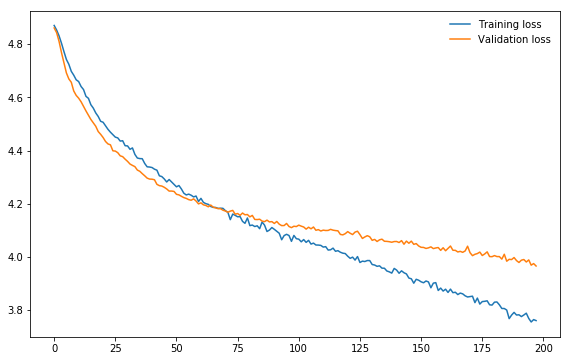

In [158]:
# msjose's model at 200
plt.rcParams['figure.figsize'] = [9.5, 6]

plt.plot(train_losses[2:], label="Training loss")
plt.plot(valid_losses[2:], label="Validation loss")
plt.legend(frameon=False)
plt.show()

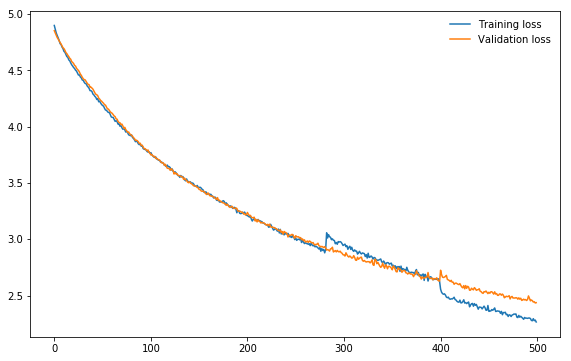

In [159]:
plt.rcParams['figure.figsize'] = [9.5, 6]

plt.plot(train_losses[2:], label="Training loss")
plt.plot(valid_losses[2:], label="Validation loss")
#plt.plot(val_acc_history[2:], label="Validation accuracy")
plt.legend(frameon=False)
#plt.ylim(ymin=-0.1) 
plt.show()

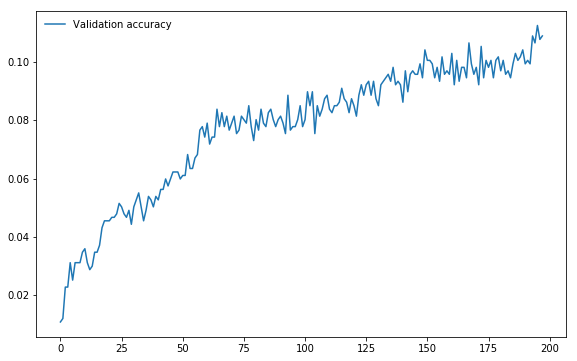

In [160]:
# msjose's model at 200
plt.rcParams['figure.figsize'] = [9.5, 6]

plt.plot(val_acc_history[2:], label="Validation accuracy")
plt.legend(frameon=False)
plt.show()

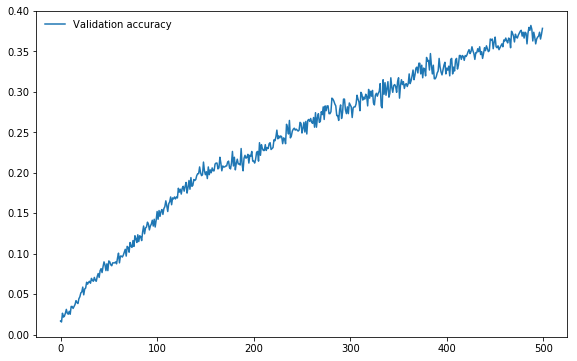

In [161]:
plt.rcParams['figure.figsize'] = [9.5, 6]

# plt.plot(train_losses[2:], label="Training loss")
# plt.plot(valid_losses[2:], label="Validation loss")
plt.plot(val_acc_history[2:], label="Validation accuracy")
plt.legend(frameon=False)
#plt.ylim(ymin=-0.1) 
plt.show()

## Results of 3 layer CNN

### 48-96-128 configuration

(15% accuracy at 103 epochs, 29% (243/836) after 300 epochs)

### 1. Test results
```
Test Loss: 2.945874
Test Accuracy: 29% (243/836)
```
### 2. Run results
```
Training complete in 451m 40s
Best validation accuracy: 0.292216
Best accuracy epoch     : 284
Best validation loss    : 2.878668
Best validation epoch   : 300
```

### 3. Loss chart and Accuracy charts
<img src="images/3_layer_cnn_128_loss.jpg" width="550" align="left">  
 
<img src="images/3_layer_cnn_128_accuracy.jpg" width="550" align="left">  

## Results of 3 layer CNN

#### 32-64-96 CNN

(15% accuracy at 105 epochs, 27% (228/836) after 300 epochs)

### 1. Test results
```
Test Loss: 3.024790
Test Accuracy: 27% (228/836)
```
### 2. Run results

#### Run 1
```
Training complete in 141m 46s
Best validation accuracy: 0.146108
Best accuracy epoch     : 99
Best validation loss    : 3.840200
Best validation epoch   : 100
```
#### Run 2
```
Training complete in 136m 32s
Best validation accuracy: 0.231138
Best accuracy epoch     : 199
Best validation loss    : 3.267654
Best validation epoch   : 199
```
#### Run 3
```
Training complete in 140m 10s
Best validation accuracy: 0.285030
Best accuracy epoch     : 297
Best validation loss    : 2.968024
Best validation epoch   : 300
```

### 3. Loss chart and Accuracy charts
<img src="images/3_layer_cnn_loss.jpg" width="550" align="left">  
 
<img src="images/3_layer_cnn_accuracy.jpg" width="550" align="left">  

## Results of 3 layer CNN with batch normalization

(15% accuracy at 105 epochs, 26% (225/836) after 300 epochs)

### 1. Test Results
```
Test Loss: 3.085338
Test Accuracy: 26% (225/836)
```

### 2. Run results
```
Training complete in 442m 23s
Best validation accuracy: 0.267066
Best accuracy epoch     : 291
Best validation loss    : 2.988656
Best validation epoch   : 299
```

### 3. Loss chart and Accuracy charts
<img src="images/3_layer_cnn_bn_loss.jpg" width="550" align="left">  
 
<img src="images/3_layer_cnn_bn_accuracy.jpg" width="550" align="left">  


## Results of 6 layer CNN

(15% accuracy at 150 epochs)

### 1. Test results
```
Test Loss: 3.768435
Test Accuracy: 15% (128/836)
```
### 2. Run results

#### Run 1
```
Training complete in 70m 19s
Best validation accuracy: 0.075449
Best accuracy epoch     : 49
Best validation loss    : 4.372317
Best validation epoch   : 50
```
#### Run 2
```
Training complete in 133m 29s
Best validation accuracy: 0.150898
Best accuracy epoch     : 150
Best validation loss    : 3.749052
Best validation epoch   : 150
```

---
<a id='step4'></a>
## Step 4: Create a CNN to Classify Dog Breeds (using Transfer Learning)

You will now use transfer learning to create a CNN that can identify dog breed from images.  Your CNN must attain at least 60% accuracy on the test set.

### (IMPLEMENTATION) Specify Data Loaders for the Dog Dataset

Use the code cell below to write three separate [data loaders](http://pytorch.org/docs/master/data.html#torch.utils.data.DataLoader) for the training, validation, and test datasets of dog images (located at `dogImages/train`, `dogImages/valid`, and `dogImages/test`, respectively). 

If you like, **you are welcome to use the same data loaders from the previous step**, when you created a CNN from scratch.

In [162]:
## TODO: Specify data loaders
import os
from PIL import Image
from PIL import ImageFile
from torchvision import datasets, transforms
#ImageFile.LOAD_TRUNCATED_IMAGES = True

data_dir = 'dog_images/'
train_dir = data_dir + 'train/'
valid_dir = data_dir + 'valid/'
test_dir  = data_dir + 'test/'

batch_size = 128 # 64 
num_workers = 4
image_size = 224 

global img_means, img_std

if img_means is not None:
    imgmeans = img_means
else: 
    imgmeans = [0.485, 0.456, 0.406]

if img_std is not None:
    imgstd = img_std
else: 
    imgstd = [0.229, 0.224, 0.225]
        
data_transforms = {
    'train': transforms.Compose([transforms.RandomAffine(15, translate=(0.1, 0.1), scale=(1.0, 1.5), 
                                                         shear=None, resample=Image.BILINEAR, fillcolor=0),
                                 transforms.Resize(image_size + (image_size//7), interpolation=Image.BILINEAR),
                                 transforms.CenterCrop(image_size),
                                 transforms.RandomHorizontalFlip(),
                                 transforms.ColorJitter(brightness=0.3, contrast=0.3, saturation=0.2, hue=0.05), 
                                 transforms.ToTensor(),
                                 transforms.Normalize(imgmeans, imgstd)
                                ]), 
    'valid': transforms.Compose([transforms.Resize(image_size + (image_size//7)),
                                 transforms.CenterCrop(image_size),
                                 transforms.ToTensor(),
                                transforms.Normalize(imgmeans, imgstd)
                                ]),
    'test' : transforms.Compose([transforms.Resize(image_size + (image_size//7)),
                                 transforms.CenterCrop(image_size),
                                 transforms.ToTensor(),
                                 transforms.Normalize(imgmeans, imgstd)
                                ])
}    

image_datasets = {x: datasets.ImageFolder(os.path.join(data_dir, x),
                                          data_transforms[x])
                  for x in ['train', 'valid', 'test']}

class_names = image_datasets['train'].classes
dataset_sizes = {x: len(image_datasets[x]) for x in ['train', 'valid', 'test']}

loaders_transfer = {x: torch.utils.data.DataLoader(image_datasets[x], 
                                              batch_size=batch_size,
                                              shuffle=False if x[:4]=='test' else True, 
                                              num_workers=num_workers)
              for x in ['train', 'valid', 'test']}

### Use ImageFolderWithPaths wrapper as alternative datasets and loaders so we can get paths
 
Seems to only work with num_workers = 0

In [163]:
class ImageFolderWithPaths(datasets.ImageFolder):
    """Custom dataset that includes image file paths. Extends
    torchvision.datasets.ImageFolder
    """

    # override the __getitem__ method. this is the method dataloader calls
    def __getitem__(self, index):
        # this is what ImageFolder normally returns 
        original_tuple = super(ImageFolderWithPaths, self).__getitem__(index)
        # the image file path
        path = self.imgs[index][0]
        # make a new tuple that includes original and the path
        tuple_with_path = (original_tuple + (path,))
        return tuple_with_path

In [164]:
test_datasets = {x: ImageFolderWithPaths(os.path.join(data_dir, x),
                                          data_transforms[x])
                  for x in ['valid', 'test']}

test_dataloaders = {x: torch.utils.data.DataLoader(test_datasets[x], 
                                              batch_size=batch_size,
                                              shuffle=False)
              for x in ['valid', 'test']}

## Explore current structure of Resnet50

In [165]:
import torchvision.models as models
import torch.nn as nn
standard_model = models.resnet50(pretrained=True)

In [166]:
standard_model.fc

Linear(in_features=2048, out_features=1000, bias=True)

In [167]:
print(standard_model)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=F

)


In [168]:
for name, child in standard_model.named_children():
    print(name)

conv1
bn1
relu
maxpool
layer1
layer2
layer3
layer4
avgpool
fc


In [169]:
std_fc = standard_model.fc

In [170]:
std_fc

Linear(in_features=2048, out_features=1000, bias=True)

In [171]:
list(std_fc.parameters())

[Parameter containing:
 tensor([[-0.0092,  0.0153, -0.0375,  ..., -0.0105,  0.0011, -0.0265],
         [ 0.0104, -0.0266,  0.0005,  ...,  0.0288, -0.0210, -0.0067],
         [-0.0072,  0.0664, -0.0393,  ...,  0.0130, -0.0249, -0.0015],
         ...,
         [-0.0104, -0.0018, -0.0348,  ..., -0.0170,  0.1071,  0.0277],
         [-0.0168, -0.0059, -0.0287,  ..., -0.0214, -0.0048, -0.0133],
         [-0.0215,  0.0239,  0.0809,  ...,  0.0010, -0.0440,  0.0180]],
        requires_grad=True), Parameter containing:
 tensor([-0.0091, -0.0041, -0.0205, -0.0176,  0.0096,  0.0059, -0.0144,  0.0007,
          0.0014, -0.0016, -0.0121, -0.0094, -0.0192, -0.0172, -0.0112, -0.0170,
         -0.0081, -0.0136,  0.0085, -0.0179,  0.0070,  0.0184, -0.0025,  0.0024,
         -0.0014,  0.0049,  0.0105, -0.0008, -0.0064, -0.0114, -0.0133, -0.0093,
         -0.0025, -0.0045,  0.0037, -0.0246,  0.0044, -0.0085, -0.0000, -0.0017,
         -0.0042,  0.0024,  0.0095, -0.0066,  0.0023,  0.0004,  0.0278, -0.0113,

In [172]:
len(list(std_fc.parameters())[0])

1000

In [173]:
len(list(std_fc.parameters())[1])

1000

The dog parameters are from 151-268...

In [174]:
len(list(std_fc.parameters())[0][151:269])

118

That is, only 118 classes are dogs, not the 133 we have to train for... 

In [175]:
list(std_fc.parameters())[0][151:269]

tensor([[ 0.0297, -0.0373,  0.0282,  ..., -0.0209,  0.0105, -0.0179],
        [-0.0032, -0.0401,  0.0049,  ...,  0.0235, -0.0141, -0.0105],
        [-0.0047,  0.0192, -0.0182,  ...,  0.0377, -0.0082, -0.0015],
        ...,
        [-0.0240, -0.0389, -0.0177,  ..., -0.0172, -0.0163, -0.0172],
        [-0.0227,  0.0174, -0.0069,  ..., -0.0136, -0.0030,  0.0016],
        [-0.0151, -0.0184, -0.0266,  ..., -0.0249, -0.0077, -0.0226]],
       grad_fn=<SliceBackward>)

In [176]:
list(std_fc.parameters())[1][151:269]

tensor([ 0.0085, -0.0192,  0.0119, -0.0005, -0.0032, -0.0021, -0.0111, -0.0066,
        -0.0031, -0.0007,  0.0009,  0.0335,  0.0111, -0.0024, -0.0061, -0.0029,
        -0.0191,  0.0008, -0.0079,  0.0095,  0.0163,  0.0090,  0.0080,  0.0096,
        -0.0117,  0.0069, -0.0073,  0.0136,  0.0053,  0.0040, -0.0061,  0.0076,
        -0.0114,  0.0077,  0.0097, -0.0023,  0.0098,  0.0030,  0.0045, -0.0075,
         0.0094,  0.0223, -0.0166, -0.0063,  0.0218,  0.0112,  0.0080, -0.0235,
         0.0062, -0.0172,  0.0085,  0.0187,  0.0187,  0.0140, -0.0004, -0.0211,
         0.0035, -0.0046,  0.0195, -0.0101,  0.0083, -0.0014, -0.0108,  0.0021,
        -0.0004, -0.0079,  0.0258,  0.0030,  0.0035,  0.0022, -0.0127, -0.0018,
         0.0287, -0.0167,  0.0195, -0.0018,  0.0062, -0.0086,  0.0050,  0.0006,
        -0.0049,  0.0190,  0.0004,  0.0075, -0.0037,  0.0248,  0.0061,  0.0072,
         0.0230, -0.0051, -0.0026,  0.0039, -0.0048,  0.0029,  0.0164,  0.0024,
         0.0063,  0.0012, -0.0069,  0.00

### (IMPLEMENTATION) Model Architecture

Use transfer learning to create a CNN to classify dog breed.  Use the code cell below, and save your initialized model as the variable `model_transfer`.

In [177]:
del model_transfer

In [178]:
import torchvision.models as models
import torch.nn as nn

## TODO: Specify model architecture 

class AdaptiveConcatPool2d(nn.Module):
    def __init__(self, sz=None):
        super().__init__()
        sz = sz or (1,1)
        self.ap = nn.AdaptiveAvgPool2d(sz)
        self.mp = nn.AdaptiveMaxPool2d(sz)
    def forward(self, x): return torch.cat([self.mp(x), self.ap(x)], 1)

class Flatten(nn.Module):
    def __init__(self):
        super(Flatten, self).__init__()

    def forward(self, x):
        x = x.view(x.size(0), -1)
        return x
    
def get_resnet_model(modelname='resnet50', swap=False, sm=False):
    if modelname == 'resnet18':
        model = models.resnet18(pretrained=True)   
    elif modelname == 'resnet34':    
        model = models.resnet34(pretrained=True)   
    elif modelname == 'resnet50':    
        model = models.resnet50(pretrained=True)
    elif modelname == 'resnet101':    
        model = models.resnet101(pretrained=True)
    elif modelname == 'resnet152':    
        model = models.resnet152(pretrained=True)
    else:
        model = models.resnet50(pretrained=True)
        
    for param in model.parameters():
        param.requires_grad = False    
        
    clf_input_size = model.fc.in_features
    clf_output_size = 133 # len(class_names)
    nf = clf_input_size * 2 # For flattening ...
    
    if swap==True:
        # swapping last 2 layers for new ones - adaptive max pooling and more linear layers with dropout
        Resnetlayers = []
        Resnetlayers.append(AdaptiveConcatPool2d())
        Resnetlayers.append(Flatten())
        Resnetlayers.append(nn.BatchNorm1d(nf, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True))
        Resnetlayers.append(nn.Dropout(p=0.25))
        Resnetlayers.append(nn.Linear(in_features=nf, out_features=512, bias=True))
        Resnetlayers.append(nn.ReLU())
        Resnetlayers.append(nn.BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True))
        Resnetlayers.append(nn.Dropout(p=0.25))
        Resnetlayers.append(nn.Linear(in_features=512, out_features=clf_output_size, bias=True))        
        if sm==True:
            Resnetlayers.append(nn.LogSoftmax())
            
        Resnetlist = list(model.children())[:-2] + Resnetlayers
        model = torch.nn.Sequential(*Resnetlist)
    else:    
        # standard replacing the fc layer to suit the number of classes
        classifier = nn.Linear(clf_input_size, clf_output_size)
        model.fc = classifier

    return model

model_name = "resnet152"

model_transfer = get_resnet_model(model_name, swap=False, sm=False)

#model_name = "resnet152RL"

if use_cuda:
    model_transfer = model_transfer.cuda()

__Question 5:__ Outline the steps you took to get to your final CNN architecture and your reasoning at each step.  Describe why you think the architecture is suitable for the current problem.

__Answer:__ 


**Set use_weights to True if wanting to use the weights to compensate for class imbalance**

In [179]:
from collections import defaultdict
class_counts = defaultdict(int)
for _, c in image_datasets["train"].imgs:
    class_counts[c] += 1

class_weights = [1-(float(class_counts[class_id])/len(image_datasets["train"].imgs))
                 for class_id in range(len(image_datasets["train"].classes))]
class_weights = torch.FloatTensor(class_weights)
class_weights.to(device)

tensor([0.9904, 0.9913, 0.9922, 0.9906, 0.9885, 0.9904, 0.9925, 0.9901, 0.9949,
        0.9925, 0.9901, 0.9901, 0.9931, 0.9897, 0.9891, 0.9912, 0.9907, 0.9925,
        0.9928, 0.9907, 0.9904, 0.9930, 0.9903, 0.9907, 0.9945, 0.9939, 0.9904,
        0.9948, 0.9889, 0.9922, 0.9916, 0.9903, 0.9933, 0.9904, 0.9921, 0.9903,
        0.9925, 0.9915, 0.9897, 0.9921, 0.9897, 0.9906, 0.9925, 0.9904, 0.9921,
        0.9900, 0.9919, 0.9919, 0.9925, 0.9925, 0.9907, 0.9927, 0.9930, 0.9915,
        0.9925, 0.9903, 0.9894, 0.9925, 0.9930, 0.9910, 0.9909, 0.9921, 0.9921,
        0.9942, 0.9937, 0.9951, 0.9949, 0.9906, 0.9924, 0.9930, 0.9907, 0.9928,
        0.9937, 0.9939, 0.9934, 0.9904, 0.9936, 0.9940, 0.9912, 0.9931, 0.9916,
        0.9909, 0.9931, 0.9925, 0.9945, 0.9921, 0.9901, 0.9924, 0.9921, 0.9913,
        0.9915, 0.9934, 0.9948, 0.9934, 0.9927, 0.9936, 0.9925, 0.9933, 0.9937,
        0.9949, 0.9928, 0.9957, 0.9913, 0.9937, 0.9954, 0.9925, 0.9931, 0.9961,
        0.9933, 0.9951, 0.9934, 0.9919, 

In [180]:
len(class_weights)

133

In [181]:
use_weights = False

**Learning rate...**

In [182]:
learning_rate = 0.05

In [183]:
learning_rate = 1e-7

In [184]:
learning_rate = 1e-5

In [185]:
learning_rate = 1e-3

### (IMPLEMENTATION) Specify Loss Function and Optimizer

Use the next code cell to specify a [loss function](http://pytorch.org/docs/master/nn.html#loss-functions) and [optimizer](http://pytorch.org/docs/master/optim.html).  Save the chosen loss function as `criterion_transfer`, and the optimizer as `optimizer_transfer` below.

In [186]:
import torch.optim as optim

if use_weights:
    criterion_transfer = nn.CrossEntropyLoss(weight=class_weights.to(device), reduction='sum')
else:    
    criterion_transfer = nn.CrossEntropyLoss()

parameters = filter(lambda p: p.requires_grad, model_transfer.parameters())

optimizer_transfer = optim.Adam(parameters, lr=learning_rate) #, weight_decay=1e-4)

## Scheduler

In [187]:
from torch.optim import lr_scheduler

multistep = False
OnPlateau = False

# Decay LR by a factor of 0.1 every 14 epochs (9 for inception)
if OnPlateau == True:
    #exp_lr_scheduler = lr_scheduler.ReduceLROnPlateau(optimizer_transfer, mode='max', factor=0.5, patience=5, min_lr=0.000001)
    exp_lr_scheduler = lr_scheduler.ReduceLROnPlateau(optimizer_transfer, mode='max', factor=0.5, patience=5)
elif multistep==True:
    exp_lr_scheduler = lr_scheduler.MultiStepLR(optimizer_transfer, [7, 13, 23], gamma=0.05) # gamma=0.1
else:
    exp_lr_scheduler = lr_scheduler.StepLR(optimizer_transfer, 10, gamma=0.1)
    #exp_lr_scheduler = lr_scheduler.StepLR(optimizer_transfer, 10, gamma=0.05)
    # exp_lr_scheduler = lr_scheduler.StepLR(optimizer_transfer, 5, gamma=0.1)

In [188]:
exp_lr_scheduler

# Training loop

In [189]:
train_losses, valid_losses, train_acc_history, val_acc_history, lr_hist = [], [], [], [], [] 
best_acc, best_val_epoch, best_acc_epoch, epoch_loss_min = 0.0, 0, 0, np.Inf

In [190]:
def train_model(model, criterion, optimizer, dataloaders, scheduler, use_scheduler=False, use_weights=False, 
                num_epochs=50, first_epoch=0, ufilename=None, is_inception=False):
    
    global train_losses, valid_losses, val_acc_history, lr_hist
    global best_acc, best_val_epoch, best_acc_epoch, epoch_loss_min
    global model_name
    
    since = time.time()
    best_model_wts = copy.deepcopy(model.state_dict())
    best_optim_wts = copy.deepcopy(optimizer.state_dict())

    curr_lr = get_learning_rate(optimizer)
    
    # if first_epoch is used assume its to restart training at that point using 1-based indexing
    # so decrement by 1 then add the value to num_epochs
    if first_epoch > 0:
        first_epoch -= 1
        num_epochs = first_epoch + num_epochs
    
    for epoch in range(first_epoch, num_epochs):
        print('Epoch {}/{}'.format(epoch+1, num_epochs))
        print('-' * 11)

        # Each epoch has a training and validation phase
        for phase in ['train', 'valid']:
            if phase == 'train':
                if use_scheduler==True: 
                    if isinstance(scheduler, torch.optim.lr_scheduler.ReduceLROnPlateau):
                        # using best accuracy - the max setting
                        scheduler.step(best_acc)
                    else:    
                        scheduler.step()
                model.train()  # Set model to training mode
            else:
                model.eval()   # Set model to evaluate mode

            running_loss = 0.0
            running_corrects = 0

            # Iterate over data.
            for inputs, labels in dataloaders[phase]:
                inputs, labels = inputs.to(device), labels.to(device)

                # zero the parameter gradients
                optimizer.zero_grad()

                # forward
                # track history if only in train
                with torch.set_grad_enabled(phase == 'train'):
                    # Get model outputs and calculate loss
                    # Special case for inception because in training it has an auxiliary output. In train
                    #   mode we calculate the loss by summing the final output and the auxiliary output
                    #   but in testing we only consider the final output.
                    # From https://discuss.pytorch.org/t/how-to-optimize-inception-model-with-auxiliary-classifiers/7958
                    
                    outputs = model(inputs)
                    
                    if isinstance(outputs, tuple):
                        if epoch == first_epoch:
                            print("Outputs:", outputs)
                        
                        if is_inception and phase == 'train':
                            loss1 = criterion(outputs[0], labels)
                            loss2 = criterion(outputs[1], labels)
                            loss = loss1 + 0.4*loss2
                        else:    
                            loss = sum((criterion(o,labels) for o in outputs))
                    else:
                        loss = criterion(outputs, labels)

                    _, preds = torch.max(outputs, 1)
                    
                    # backward + optimize only if in training phase
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                # statistics
                running_loss += loss.item() * (1 if use_weights==True else inputs.size(0))
                running_corrects += torch.sum(preds == labels.data)

            epoch_loss = running_loss / dataset_sizes[phase]
            epoch_acc = running_corrects.double() / dataset_sizes[phase]

            if phase == 'train':
                train_losses.append(epoch_loss)
                curr_lr = get_learning_rate(optimizer)
                lr_hist.append(curr_lr)
                
                print("Learning rate: {}".format(curr_lr))
                
            if phase == 'valid':
                valid_losses.append(epoch_loss)
                val_acc_history.append(epoch_acc.item())
                                
            print('{} Loss: {:.4f} Acc: {:.4f}'.format(
                phase, epoch_loss, epoch_acc))

            # deep copy the model
            if phase == 'valid' and epoch_acc > best_acc:
                filename = model_name + '_acc_'
                if ufilename is not None:
                    filename = filename + ufilename + '_'
                else:    
                    if use_scheduler==True:
                        filename = filename + 'schd_'
                    if use_weights==True:
                        filename = filename + 'wgts_'
                ### filename = filename + str(epoch+1) 
                if filename[-1:] == "_":
                    filename = filename[:-1]
                    
                print('Accuracy has increased ({:.6f} --> {:.6f}).  Saving model as {}...'.format(
                    best_acc, epoch_acc,
                    filename))

                best_acc_epoch = epoch+1
                best_acc = epoch_acc
                
                best_model_wts = copy.deepcopy(model.state_dict())
                best_optim_wts = copy.deepcopy(optimizer.state_dict())
                torch.save(best_model_wts, filename + '.pt')
                torch.save(best_optim_wts, filename + '_optimizer.pt')               
                
            if phase == 'valid' and epoch_loss <= epoch_loss_min:
                filename = model_name + '_'
                if ufilename is not None:
                    filename = filename + ufilename + '_'
                else:    
                    if use_scheduler==True:
                        filename = filename + 'schd_'
                    if use_weights==True:
                        filename = filename + 'wgts_'
                ### filename = filename + str(epoch+1) 
                if filename[-1:] == "_":
                    filename = filename[:-1]
                
                print('Validation loss decreased ({:.6f} --> {:.6f}).  Saving model as {}...'.format(
                epoch_loss_min,
                epoch_loss,
                filename))
                
                best_val_epoch = epoch+1
                epoch_loss_min = epoch_loss
                
                torch.save(model.state_dict(), filename + '.pt')
                torch.save(optimizer.state_dict(), filename + '_optimizer.pt')

        print()

    time_elapsed = time.time() - since
    
    print('Training complete in {:.0f}m {:.0f}s'.format(
        time_elapsed // 60, time_elapsed % 60))
    print('Best validation Accuracy: {:4f}'.format(best_acc))
    print('Best accuracy epoch     : {}'.format(best_acc_epoch))
    print('Best validation Loss    : {:4f}'.format(epoch_loss_min))
    print('Best validation epoch   : {}'.format(best_val_epoch))
    
    # load best model weights
    model.load_state_dict(best_model_wts)
    optimizer.load_state_dict(best_optim_wts)
    
    return model

https://towardsdatascience.com/gradient-descent-algorithms-and-adaptive-learning-rate-adjustment-methods-79c701b086be

### (IMPLEMENTATION) Train and Validate the Model

Train and validate your model in the code cell below.  [Save the final model parameters](http://pytorch.org/docs/master/notes/serialization.html) at filepath `'model_transfer.pt'`.

In [191]:
print("{:.10f}".format(5e-05))
print("{:.10f}".format(0.0005))
print("{:.10f}".format(5e-06))

0.0000500000
0.0005000000
0.0000050000


In [192]:
round(0.00005, 8)

5e-05

In [193]:
# experiment with training loop that uses modified 1 cycle approach, starting with a low rate, up higher, then back again...
step = 5
start_epoch = 1
end_epoch = start_epoch + step

start = 0.000005
middle = 0.00005
end = 0.0000005

lr = start
start_epoch = 1

# with active_session():
#     # train the model
    
while lr <= middle:
    print(lr)
    parameters = filter(lambda p: p.requires_grad, model_transfer.parameters())
    optimizer_transfer = optim.Adam(parameters, lr=lr)
    end_epoch = start_epoch + step - 1
    print(str(start_epoch), " --> ", str(end_epoch))
    print()

    model_transfer = train_model(model_transfer, 
                    criterion_transfer, 
                    optimizer_transfer,
                    loaders_transfer,         
                    exp_lr_scheduler, 
                    use_scheduler=False, 
                    use_weights=use_weights, 
                    num_epochs=step,
                    first_epoch=start_epoch,
                    ufilename="1cycle_10",
                    is_inception=(model_name=="inception"))

    print()
    print('=' * 20)
    print()

    start_epoch = end_epoch + 1

    lr *= 10
    lr = round(lr, 8)
    
    # increase step after initial loop 
    step = 15
    

# with active_session():
# Step at 20 per epoch for remaining of training run
step = 20    
while lr >= end:
    print(lr)
    parameters = filter(lambda p: p.requires_grad, model_transfer.parameters())
    optimizer_transfer = optim.Adam(parameters, lr=lr)
    end_epoch = start_epoch + step - 1
    print(str(start_epoch), " --> ", str(end_epoch))
    print()

    model_transfer = train_model(model_transfer, 
                    criterion_transfer, 
                    optimizer_transfer,
                    loaders_transfer,         
                    exp_lr_scheduler, 
                    use_scheduler=False, 
                    use_weights=use_weights, 
                    num_epochs=step,
                    first_epoch=start_epoch,
                    ufilename="1cycle_10",
                    is_inception=(model_name=="inception"))

    print()
    print('=' * 20)
    print()

    start_epoch = end_epoch + 1
    
    lr *= 1/10
    lr = round(lr, 8)

    if lr == end:
        step = 5

# print(lr)
# parameters = filter(lambda p: p.requires_grad, model_transfer.parameters())
# optimizer_transfer = optim.Adam(parameters, lr=lr)
# step = 20
# end_epoch = start_epoch + step - 1
# print(str(start_epoch), " --> ", str(end_epoch))
# print()

# model_transfer = train_model(model_transfer, 
#                 criterion_transfer, 
#                 optimizer_transfer,
#                 loaders_transfer,         
#                 exp_lr_scheduler, 
#                 use_scheduler=False, 
#                 use_weights=use_weights, 
#                 num_epochs=step,
#                 first_epoch=start_epoch,
#                 ufilename="1cycle_10",
#                 is_inception=(model_name=="inception"))        

5e-06
1  -->  5

Epoch 1/5
-----------
Learning rate: [5e-06]
train Loss: 4.9067 Acc: 0.0133
valid Loss: 4.8091 Acc: 0.0263
Accuracy has increased (0.000000 --> 0.026347).  Saving model as resnet152RL_acc_1cycle_10...
Validation loss decreased (inf --> 4.809084).  Saving model as resnet152RL_1cycle_10...

Epoch 2/5
-----------
Learning rate: [5e-06]
train Loss: 4.7824 Acc: 0.0302
valid Loss: 4.6788 Acc: 0.0587
Accuracy has increased (0.026347 --> 0.058683).  Saving model as resnet152RL_acc_1cycle_10...
Validation loss decreased (4.809084 --> 4.678789).  Saving model as resnet152RL_1cycle_10...

Epoch 3/5
-----------
Learning rate: [5e-06]
train Loss: 4.6626 Acc: 0.0581
valid Loss: 4.5563 Acc: 0.1186
Accuracy has increased (0.058683 --> 0.118563).  Saving model as resnet152RL_acc_1cycle_10...
Validation loss decreased (4.678789 --> 4.556300).  Saving model as resnet152RL_1cycle_10...

Epoch 4/5
-----------
Learning rate: [5e-06]
train Loss: 4.5509 Acc: 0.0976
valid Loss: 4.4352 Acc: 0.2

valid Loss: 0.3127 Acc: 0.9042

Training complete in 8m 9s
Best validation Accuracy: 0.908982
Best accuracy epoch     : 54
Best validation Loss    : 0.305746
Best validation epoch   : 38




In [194]:
# experiment with training loop that uses modified 1 cycle approach, starting with a low rate, up higher, then back again...
step = 5
start_epoch = 1
end_epoch = start_epoch + step

start = 0.000005
middle = 0.00005
end = 0.0000005

lr = start
start_epoch = 1

# with active_session():
#     # train the model
    
while lr <= middle:
    print(lr)
    parameters = filter(lambda p: p.requires_grad, model_transfer.parameters())
    optimizer_transfer = optim.Adam(parameters, lr=lr)
    end_epoch = start_epoch + step - 1
    print(str(start_epoch), " --> ", str(end_epoch))
    print()

    model_transfer = train_model(model_transfer, 
                    criterion_transfer, 
                    optimizer_transfer,
                    loaders_transfer,         
                    exp_lr_scheduler, 
                    use_scheduler=False, 
                    use_weights=use_weights, 
                    num_epochs=step,
                    first_epoch=start_epoch,
                    ufilename="1cycle_9",
                    is_inception=(model_name=="inception"))

    print()
    print('=' * 20)
    print()

    start_epoch = end_epoch + 1

    lr *= 10
    lr = round(lr, 8)
    
    # increase step after initial loop by step + 5
    step += 5
    

# with active_session():
# Step at 15 per epoch for remaining of training run, and use weight decay
step = 15    
while lr >= end:
    print(lr)
    parameters = filter(lambda p: p.requires_grad, model_transfer.parameters())
    optimizer_transfer = optim.Adam(parameters, lr=lr, weight_decay = 1e-04)
    end_epoch = start_epoch + step - 1
    print(str(start_epoch), " --> ", str(end_epoch))
    print()

    model_transfer = train_model(model_transfer, 
                    criterion_transfer, 
                    optimizer_transfer,
                    loaders_transfer,         
                    exp_lr_scheduler, 
                    use_scheduler=False, 
                    use_weights=use_weights, 
                    num_epochs=step,
                    first_epoch=start_epoch,
                    ufilename="1cycle_9",
                    is_inception=(model_name=="inception"))

    print()
    print('=' * 20)
    print()

    start_epoch = end_epoch + 1
    
    lr *= 1/10
    lr = round(lr, 8)

    if lr == end:
        step = 10

# print(lr)
# parameters = filter(lambda p: p.requires_grad, model_transfer.parameters())
# optimizer_transfer = optim.Adam(parameters, lr=lr)
# step = 20
# end_epoch = start_epoch + step - 1
# print(str(start_epoch), " --> ", str(end_epoch))
# print()

# model_transfer = train_model(model_transfer, 
#                 criterion_transfer, 
#                 optimizer_transfer,
#                 loaders_transfer,         
#                 exp_lr_scheduler, 
#                 use_scheduler=False, 
#                 use_weights=use_weights, 
#                 num_epochs=step,
#                 first_epoch=start_epoch,
#                 ufilename="1cycle_9",
#                 is_inception=(model_name=="inception"))        

5e-06
1  -->  5

Epoch 1/5
-----------
Learning rate: [5e-06]
train Loss: 4.9474 Acc: 0.0039
valid Loss: 4.9150 Acc: 0.0048
Accuracy has increased (0.000000 --> 0.004790).  Saving model as resnet152_acc_1cycle_9...
Validation loss decreased (inf --> 4.914971).  Saving model as resnet152_1cycle_9...

Epoch 2/5
-----------
Learning rate: [5e-06]
train Loss: 4.8921 Acc: 0.0096
valid Loss: 4.8609 Acc: 0.0072
Accuracy has increased (0.004790 --> 0.007186).  Saving model as resnet152_acc_1cycle_9...
Validation loss decreased (4.914971 --> 4.860950).  Saving model as resnet152_1cycle_9...

Epoch 3/5
-----------
Learning rate: [5e-06]
train Loss: 4.8395 Acc: 0.0133
valid Loss: 4.8113 Acc: 0.0108
Accuracy has increased (0.007186 --> 0.010778).  Saving model as resnet152_acc_1cycle_9...
Validation loss decreased (4.860950 --> 4.811338).  Saving model as resnet152_1cycle_9...

Epoch 4/5
-----------
Learning rate: [5e-06]
train Loss: 4.7925 Acc: 0.0217
valid Loss: 4.7653 Acc: 0.0228
Accuracy has i

In [195]:
# experiment with training loop that uses modified 1 cycle approach, starting with a low rate, up higher, then back again...
step = 5
start_epoch = 1
end_epoch = start_epoch + step

start = 0.000005
middle = 0.00005
end = 0.0000005

lr = start
start_epoch = 1

# with active_session():
#     # train the model
    
while lr <= middle:
    print(lr)
    parameters = filter(lambda p: p.requires_grad, model_transfer.parameters())
    optimizer_transfer = optim.Adam(parameters, lr=lr)
    end_epoch = start_epoch + step - 1
    print(str(start_epoch), " --> ", str(end_epoch))
    print()

    model_transfer = train_model(model_transfer, 
                    criterion_transfer, 
                    optimizer_transfer,
                    loaders_transfer,         
                    exp_lr_scheduler, 
                    use_scheduler=False, 
                    use_weights=use_weights, 
                    num_epochs=step,
                    first_epoch=start_epoch,
                    ufilename="1cycle_8",
                    is_inception=(model_name=="inception"))

    print()
    print('=' * 20)
    print()

    start_epoch = end_epoch + 1

    lr *= 10
    lr = round(lr, 8)
    
    # increase step after initial loop 
    step = 15
    

# with active_session():
# Step at 20 per epoch for remaining of training run
step = 20    
while lr >= end:
    print(lr)
    parameters = filter(lambda p: p.requires_grad, model_transfer.parameters())
    optimizer_transfer = optim.Adam(parameters, lr=lr)
    end_epoch = start_epoch + step - 1
    print(str(start_epoch), " --> ", str(end_epoch))
    print()

    model_transfer = train_model(model_transfer, 
                    criterion_transfer, 
                    optimizer_transfer,
                    loaders_transfer,         
                    exp_lr_scheduler, 
                    use_scheduler=False, 
                    use_weights=use_weights, 
                    num_epochs=step,
                    first_epoch=start_epoch,
                    ufilename="1cycle_8",
                    is_inception=(model_name=="inception"))

    print()
    print('=' * 20)
    print()

    start_epoch = end_epoch + 1
    
    lr *= 1/10
    lr = round(lr, 8)

    if lr == end:
        step = 5

# print(lr)
# parameters = filter(lambda p: p.requires_grad, model_transfer.parameters())
# optimizer_transfer = optim.Adam(parameters, lr=lr)
# step = 20
# end_epoch = start_epoch + step - 1
# print(str(start_epoch), " --> ", str(end_epoch))
# print()

# model_transfer = train_model(model_transfer, 
#                 criterion_transfer, 
#                 optimizer_transfer,
#                 loaders_transfer,         
#                 exp_lr_scheduler, 
#                 use_scheduler=False, 
#                 use_weights=use_weights, 
#                 num_epochs=step,
#                 first_epoch=start_epoch,
#                 ufilename="1cycle_6",
#                 is_inception=(model_name=="inception"))        

5e-06
1  -->  5

Epoch 1/5
-----------
Learning rate: [5e-06]
train Loss: 4.9297 Acc: 0.0052
valid Loss: 4.8944 Acc: 0.0072
Accuracy has increased (0.000000 --> 0.007186).  Saving model as resnet152_acc_1cycle_8...
Validation loss decreased (inf --> 4.894356).  Saving model as resnet152_1cycle_8...

Epoch 2/5
-----------
Learning rate: [5e-06]
train Loss: 4.8784 Acc: 0.0081
valid Loss: 4.8436 Acc: 0.0108
Accuracy has increased (0.007186 --> 0.010778).  Saving model as resnet152_acc_1cycle_8...
Validation loss decreased (4.894356 --> 4.843620).  Saving model as resnet152_1cycle_8...

Epoch 3/5
-----------
Learning rate: [5e-06]
train Loss: 4.8250 Acc: 0.0154
valid Loss: 4.7964 Acc: 0.0180
Accuracy has increased (0.010778 --> 0.017964).  Saving model as resnet152_acc_1cycle_8...
Validation loss decreased (4.843620 --> 4.796406).  Saving model as resnet152_1cycle_8...

Epoch 4/5
-----------
Learning rate: [5e-06]
train Loss: 4.7805 Acc: 0.0225
valid Loss: 4.7512 Acc: 0.0359
Accuracy has i

Epoch 83/85
-----------
Learning rate: [5e-07]
train Loss: 0.2067 Acc: 0.9537
valid Loss: 0.3186 Acc: 0.8910

Epoch 84/85
-----------
Learning rate: [5e-07]
train Loss: 0.2165 Acc: 0.9512
valid Loss: 0.3163 Acc: 0.8994

Epoch 85/85
-----------
Learning rate: [5e-07]
train Loss: 0.2116 Acc: 0.9548
valid Loss: 0.3166 Acc: 0.8934

Training complete in 8m 10s
Best validation Accuracy: 0.901796
Best accuracy epoch     : 70
Best validation Loss    : 0.314833
Best validation epoch   : 72




In [196]:
# train for a further 10 epochs at 5e-06 with weight decay of 1e-04
lr = 5e-06
print(lr)
parameters = filter(lambda p: p.requires_grad, model_transfer.parameters())
optimizer_transfer = optim.Adam(parameters, lr=lr, weight_decay = 1e-04)
start_epoch = 86
step = 10
end_epoch = start_epoch + step - 1
print(str(start_epoch), " --> ", str(end_epoch))
print()

model_transfer = train_model(model_transfer, 
                criterion_transfer, 
                optimizer_transfer,
                loaders_transfer,         
                exp_lr_scheduler, 
                use_scheduler=False, 
                use_weights=use_weights, 
                num_epochs=step,
                first_epoch=start_epoch,
                ufilename="1cycle_8a",
                is_inception=(model_name=="inception"))

5e-06
86  -->  95

Epoch 86/95
-----------
Learning rate: [5e-06]
train Loss: 0.2133 Acc: 0.9542
valid Loss: 0.3170 Acc: 0.8970

Epoch 87/95
-----------
Learning rate: [5e-06]
train Loss: 0.2074 Acc: 0.9563
valid Loss: 0.3191 Acc: 0.8970

Epoch 88/95
-----------
Learning rate: [5e-06]
train Loss: 0.2105 Acc: 0.9536
valid Loss: 0.3196 Acc: 0.8994

Epoch 89/95
-----------
Learning rate: [5e-06]
train Loss: 0.2133 Acc: 0.9516
valid Loss: 0.3191 Acc: 0.8958

Epoch 90/95
-----------
Learning rate: [5e-06]
train Loss: 0.2112 Acc: 0.9518
valid Loss: 0.3176 Acc: 0.8946

Epoch 91/95
-----------
Learning rate: [5e-06]
train Loss: 0.2105 Acc: 0.9536
valid Loss: 0.3166 Acc: 0.8982

Epoch 92/95
-----------
Learning rate: [5e-06]
train Loss: 0.2154 Acc: 0.9494
valid Loss: 0.3164 Acc: 0.8982

Epoch 93/95
-----------
Learning rate: [5e-06]
train Loss: 0.2186 Acc: 0.9501
valid Loss: 0.3178 Acc: 0.8922

Epoch 94/95
-----------
Learning rate: [5e-06]
train Loss: 0.2171 Acc: 0.9506
valid Loss: 0.3187 Acc:

In [197]:
# experiment with training loop that uses modified 1 cycle approach, starting with a low rate, up higher, then back again...
step = 15
start_epoch = 1
end_epoch = start_epoch + step

start = 0.00005
middle = 0.00005
end = 0.000005

lr = start
start_epoch = 1

# with active_session():
#     # train the model
    
while lr <= middle:
    print(lr)
    parameters = filter(lambda p: p.requires_grad, model_transfer.parameters())
    optimizer_transfer = optim.Adam(parameters, lr=lr)
    end_epoch = start_epoch + step - 1
    print(str(start_epoch), " --> ", str(end_epoch))
    print()

    model_transfer = train_model(model_transfer, 
                    criterion_transfer, 
                    optimizer_transfer,
                    loaders_transfer,         
                    exp_lr_scheduler, 
                    use_scheduler=False, 
                    use_weights=use_weights, 
                    num_epochs=step,
                    first_epoch=start_epoch,
                    ufilename="1cycle_4",
                    is_inception=(model_name=="inception"))

    print()
    print('=' * 20)
    print()

    start_epoch = end_epoch + 1

    lr *= 10
    lr = round(lr, 8)


# with active_session():
# Step at 15 per epoch for remaining of training run
step = 15    
while lr >= end:
    print(lr)
    parameters = filter(lambda p: p.requires_grad, model_transfer.parameters())
    optimizer_transfer = optim.Adam(parameters, lr=lr)
    end_epoch = start_epoch + step - 1
    print(str(start_epoch), " --> ", str(end_epoch))
    print()

    model_transfer = train_model(model_transfer, 
                    criterion_transfer, 
                    optimizer_transfer,
                    loaders_transfer,         
                    exp_lr_scheduler, 
                    use_scheduler=False, 
                    use_weights=use_weights, 
                    num_epochs=step,
                    first_epoch=start_epoch,
                    ufilename="1cycle_4",
                    is_inception=(model_name=="inception"))

    print()
    print('=' * 20)
    print()

    start_epoch = end_epoch + 1

    lr *= 1/10
    lr = round(lr, 8)

# print(lr)
# parameters = filter(lambda p: p.requires_grad, model_transfer.parameters())
# optimizer_transfer = optim.Adam(parameters, lr=lr)
# step = 20
# end_epoch = start_epoch + step - 1
# print(str(start_epoch), " --> ", str(end_epoch))
# print()

# model_transfer = train_model(model_transfer, 
#                 criterion_transfer, 
#                 optimizer_transfer,
#                 loaders_transfer,         
#                 exp_lr_scheduler, 
#                 use_scheduler=False, 
#                 use_weights=use_weights, 
#                 num_epochs=step,
#                 first_epoch=start_epoch,
#                 ufilename="1cycle_4",
#                 is_inception=(model_name=="inception"))        

5e-05
1  -->  15

Epoch 1/15
-----------
Learning rate: [5e-05]
train Loss: 4.7286 Acc: 0.0449
valid Loss: 4.4825 Acc: 0.1509
Accuracy has increased (0.000000 --> 0.150898).  Saving model as resnet152_acc_1cycle_4...
Validation loss decreased (inf --> 4.482470).  Saving model as resnet152_1cycle_4...

Epoch 2/15
-----------
Learning rate: [5e-05]
train Loss: 4.3230 Acc: 0.2530
valid Loss: 4.0878 Acc: 0.4048
Accuracy has increased (0.150898 --> 0.404790).  Saving model as resnet152_acc_1cycle_4...
Validation loss decreased (4.482470 --> 4.087777).  Saving model as resnet152_1cycle_4...

Epoch 3/15
-----------
Learning rate: [5e-05]
train Loss: 3.9576 Acc: 0.4363
valid Loss: 3.7269 Acc: 0.5377
Accuracy has increased (0.404790 --> 0.537725).  Saving model as resnet152_acc_1cycle_4...
Validation loss decreased (4.087777 --> 3.726876).  Saving model as resnet152_1cycle_4...

Epoch 4/15
-----------
Learning rate: [5e-05]
train Loss: 3.6240 Acc: 0.5462
valid Loss: 3.3941 Acc: 0.6359
Accuracy 

In [198]:
# experiment with training loop that uses 1 cycle approach, starting with a low rate, up to very high, then back again...
step = 10
start_epoch = 1
end_epoch = start_epoch + step

start = 0.00005
middle = 0.0005
end = 0.000005

lr = start
start_epoch = 1

# with active_session():
#     # train the model
    
while lr <= middle:
    print(lr)
    parameters = filter(lambda p: p.requires_grad, model_transfer.parameters())
    optimizer_transfer = optim.Adam(parameters, lr=lr)
    end_epoch = start_epoch + step - 1
    print(str(start_epoch), " --> ", str(end_epoch))
    print()

    model_transfer = train_model(model_transfer, 
                    criterion_transfer, 
                    optimizer_transfer,
                    loaders_transfer,         
                    exp_lr_scheduler, 
                    use_scheduler=False, 
                    use_weights=use_weights, 
                    num_epochs=step,
                    first_epoch=start_epoch,
                    ufilename="1cycle_4",
                    is_inception=(model_name=="inception"))

    print()
    print('=' * 20)
    print()

    start_epoch = end_epoch + 1

    lr *= 10
    lr = round(lr, 8)


# # with active_session():
# # Now in the middle of the cylcle, push this cycle for longer
# step = 20
# parameters = filter(lambda p: p.requires_grad, model_transfer.parameters())
# optimizer_transfer = optim.Adam(parameters, lr=lr)        
# end_epoch = start_epoch + step - 1
# print(str(start_epoch), " --> ", str(end_epoch))
# print()

# model_transfer = train_model(model_transfer, 
#                 criterion_transfer, 
#                 optimizer_transfer,
#                 loaders_transfer,         
#                 exp_lr_scheduler, 
#                 use_scheduler=False, 
#                 use_weights=use_weights, 
#                 num_epochs=step,
#                 first_epoch=start_epoch,
#                 ufilename="1cycle_4",
#                 is_inception=(model_name=="inception"))

# print()
# print('=' * 20)
# print()

# start_epoch = end_epoch + 1

# lr *= 1/10
# lr = round(lr, 8)
    

# with active_session():
# Step at 10 per epoch for remaining of training run
step = 10    
while lr >= end:
    print(lr)
    parameters = filter(lambda p: p.requires_grad, model_transfer.parameters())
    optimizer_transfer = optim.Adam(parameters, lr=lr)
    end_epoch = start_epoch + step - 1
    print(str(start_epoch), " --> ", str(end_epoch))
    print()

    model_transfer = train_model(model_transfer, 
                    criterion_transfer, 
                    optimizer_transfer,
                    loaders_transfer,         
                    exp_lr_scheduler, 
                    use_scheduler=False, 
                    use_weights=use_weights, 
                    num_epochs=step,
                    first_epoch=start_epoch,
                    ufilename="1cycle_4",
                    is_inception=(model_name=="inception"))

    print()
    print('=' * 20)
    print()

    start_epoch = end_epoch + 1

    lr *= 1/10
    lr = round(lr, 8)

# print(lr)
# parameters = filter(lambda p: p.requires_grad, model_transfer.parameters())
# optimizer_transfer = optim.Adam(parameters, lr=lr)
# step = 20
# end_epoch = start_epoch + step - 1
# print(str(start_epoch), " --> ", str(end_epoch))
# print()

# model_transfer = train_model(model_transfer, 
#                 criterion_transfer, 
#                 optimizer_transfer,
#                 loaders_transfer,         
#                 exp_lr_scheduler, 
#                 use_scheduler=False, 
#                 use_weights=use_weights, 
#                 num_epochs=step,
#                 first_epoch=start_epoch,
#                 ufilename="1cycle_4",
#                 is_inception=(model_name=="inception"))        

5e-05
1  -->  10

Epoch 1/10
-----------
Learning rate: [5e-05]
train Loss: 4.7319 Acc: 0.0490
valid Loss: 4.4696 Acc: 0.1665
Accuracy has increased (0.000000 --> 0.166467).  Saving model as resnet152_acc_1cycle_4...
Validation loss decreased (inf --> 4.469575).  Saving model as resnet152_1cycle_4...

Epoch 2/10
-----------
Learning rate: [5e-05]
train Loss: 4.3274 Acc: 0.2460
valid Loss: 4.0784 Acc: 0.3868
Accuracy has increased (0.166467 --> 0.386826).  Saving model as resnet152_acc_1cycle_4...
Validation loss decreased (4.469575 --> 4.078391).  Saving model as resnet152_1cycle_4...

Epoch 3/10
-----------
Learning rate: [5e-05]
train Loss: 3.9629 Acc: 0.3990
valid Loss: 3.7028 Acc: 0.5401
Accuracy has increased (0.386826 --> 0.540120).  Saving model as resnet152_acc_1cycle_4...
Validation loss decreased (4.078391 --> 3.702759).  Saving model as resnet152_1cycle_4...

Epoch 4/10
-----------
Learning rate: [5e-05]
train Loss: 3.6215 Acc: 0.5270
valid Loss: 3.3701 Acc: 0.6228
Accuracy 

In [199]:
# experiment with training loop that uses 1 cycle approach, starting with a low rate, up to very high, then back again...
step = 5
start_epoch = 1
end_epoch = start_epoch + step

start = round(0.05 / 1000, 8)
middle = round(0.05, 8)
end = round(0.05 / 10000, 8)

lr = start
start_epoch = 1

# with active_session():
#     # train the model
    
while lr < middle:
    print(lr)
    parameters = filter(lambda p: p.requires_grad, model_transfer.parameters())
    optimizer_transfer = optim.Adam(parameters, lr=lr)
    end_epoch = start_epoch + step - 1
    print(str(start_epoch), " --> ", str(end_epoch))
    print()

    model_transfer = train_model(model_transfer, 
                    criterion_transfer, 
                    optimizer_transfer,
                    loaders_transfer,         
                    exp_lr_scheduler, 
                    use_scheduler=False, 
                    use_weights=use_weights, 
                    num_epochs=step,
                    first_epoch=start_epoch,
                    ufilename="1cycle_4",
                    is_inception=(model_name=="inception"))

    print()
    print('=' * 20)
    print()

    start_epoch = end_epoch + 1

    lr *= 10
    lr = round(lr, 8)


# with active_session():
# Now in the middle of the cylcle, push this cycle for longer
step = 12
parameters = filter(lambda p: p.requires_grad, model_transfer.parameters())
optimizer_transfer = optim.Adam(parameters, lr=lr)        
end_epoch = start_epoch + step - 1
print(str(start_epoch), " --> ", str(end_epoch))
print()

model_transfer = train_model(model_transfer, 
                criterion_transfer, 
                optimizer_transfer,
                loaders_transfer,         
                exp_lr_scheduler, 
                use_scheduler=False, 
                use_weights=use_weights, 
                num_epochs=step,
                first_epoch=start_epoch,
                ufilename="1cycle_4",
                is_inception=(model_name=="inception"))

print()
print('=' * 20)
print()

start_epoch = end_epoch + 1

lr *= 1/10
lr = round(lr, 8)
    

# with active_session():
# Step at 8 per epoch for remaining of training run
step = 8    
while lr >= end:
    print(lr)
    parameters = filter(lambda p: p.requires_grad, model_transfer.parameters())
    optimizer_transfer = optim.Adam(parameters, lr=lr)
    end_epoch = start_epoch + step - 1
    print(str(start_epoch), " --> ", str(end_epoch))
    print()

    model_transfer = train_model(model_transfer, 
                    criterion_transfer, 
                    optimizer_transfer,
                    loaders_transfer,         
                    exp_lr_scheduler, 
                    use_scheduler=False, 
                    use_weights=use_weights, 
                    num_epochs=step,
                    first_epoch=start_epoch,
                    ufilename="1cycle_4",
                    is_inception=(model_name=="inception"))

    print()
    print('=' * 20)
    print()

    start_epoch = end_epoch + 1

    lr *= 1/10
    lr = round(lr, 8)

# print(lr)
# parameters = filter(lambda p: p.requires_grad, model_transfer.parameters())
# optimizer_transfer = optim.Adam(parameters, lr=lr)
# step = 20
# end_epoch = start_epoch + step - 1
# print(str(start_epoch), " --> ", str(end_epoch))
# print()

# model_transfer = train_model(model_transfer, 
#                 criterion_transfer, 
#                 optimizer_transfer,
#                 loaders_transfer,         
#                 exp_lr_scheduler, 
#                 use_scheduler=False, 
#                 use_weights=use_weights, 
#                 num_epochs=step,
#                 first_epoch=start_epoch,
#                 ufilename="1cycle_4",
#                 is_inception=(model_name=="inception"))        

5e-05
1  -->  5

Epoch 1/5
-----------
Learning rate: [5e-05]
train Loss: 4.7507 Acc: 0.0476
valid Loss: 4.4896 Acc: 0.1461
Accuracy has increased (0.000000 --> 0.146108).  Saving model as resnet152_acc_1cycle_4...
Validation loss decreased (inf --> 4.489589).  Saving model as resnet152_1cycle_4...

Epoch 2/5
-----------
Learning rate: [5e-05]
train Loss: 4.3374 Acc: 0.2379
valid Loss: 4.0959 Acc: 0.4192
Accuracy has increased (0.146108 --> 0.419162).  Saving model as resnet152_acc_1cycle_4...
Validation loss decreased (4.489589 --> 4.095936).  Saving model as resnet152_1cycle_4...

Epoch 3/5
-----------
Learning rate: [5e-05]
train Loss: 3.9730 Acc: 0.4363
valid Loss: 3.7278 Acc: 0.5473
Accuracy has increased (0.419162 --> 0.547305).  Saving model as resnet152_acc_1cycle_4...
Validation loss decreased (4.095936 --> 3.727786).  Saving model as resnet152_1cycle_4...

Epoch 4/5
-----------
Learning rate: [5e-05]
train Loss: 3.6321 Acc: 0.5429
valid Loss: 3.3903 Acc: 0.6156
Accuracy has i

In [200]:
# train for a further 20 epochs
lr *= 1/10
lr = round(lr, 8)
print(lr)
parameters = filter(lambda p: p.requires_grad, model_transfer.parameters())
optimizer_transfer = optim.Adam(parameters, lr=lr)

model_transfer = train_model(model_transfer, 
                    criterion_transfer, 
                    optimizer_transfer,
                    loaders_transfer,         
                    exp_lr_scheduler, 
                    use_scheduler=False, 
                    use_weights=use_weights, 
                    num_epochs=20,
                    first_epoch=56,
                    ufilename="1cycle_2x",
                    is_inception=(model_name=="inception"))

1e-05
Epoch 56/75
-----------
Learning rate: [1e-05]
train Loss: 0.1505 Acc: 0.9645
valid Loss: 0.3104 Acc: 0.8994

Epoch 57/75
-----------
Learning rate: [1e-05]
train Loss: 0.1513 Acc: 0.9645
valid Loss: 0.3143 Acc: 0.8994

Epoch 58/75
-----------
Learning rate: [1e-05]
train Loss: 0.1512 Acc: 0.9639
valid Loss: 0.3103 Acc: 0.8970

Epoch 59/75
-----------
Learning rate: [1e-05]
train Loss: 0.1469 Acc: 0.9635
valid Loss: 0.3126 Acc: 0.9006

Epoch 60/75
-----------
Learning rate: [1e-05]
train Loss: 0.1531 Acc: 0.9617
valid Loss: 0.3092 Acc: 0.9018

Epoch 61/75
-----------


KeyboardInterrupt: 

In [201]:
lr = 1e-03
print(lr)
parameters = filter(lambda p: p.requires_grad, model_transfer.parameters())
optimizer_transfer = optim.Adam(parameters, lr=lr)

model_transfer = train_model(model_transfer, 
                    criterion_transfer, 
                    optimizer_transfer,
                    loaders_transfer,         
                    exp_lr_scheduler, 
                    use_scheduler=False, 
                    use_weights=use_weights, 
                    num_epochs=10,
                    first_epoch=61,
                    ufilename="1cycle_2x",
                    is_inception=(model_name=="inception"))

0.001
Epoch 61/70
-----------
Learning rate: [0.001]
train Loss: 0.2247 Acc: 0.9352
valid Loss: 0.3559 Acc: 0.8778

Epoch 62/70
-----------
Learning rate: [0.001]
train Loss: 0.2064 Acc: 0.9382
valid Loss: 0.3568 Acc: 0.8766

Epoch 63/70
-----------
Learning rate: [0.001]
train Loss: 0.1950 Acc: 0.9416
valid Loss: 0.3655 Acc: 0.8802

Epoch 64/70
-----------
Learning rate: [0.001]
train Loss: 0.1974 Acc: 0.9376
valid Loss: 0.3415 Acc: 0.8862

Epoch 65/70
-----------
Learning rate: [0.001]
train Loss: 0.1919 Acc: 0.9449
valid Loss: 0.3598 Acc: 0.8886

Epoch 66/70
-----------


KeyboardInterrupt: 

In [202]:
lr = 1e-04
print(lr)
parameters = filter(lambda p: p.requires_grad, model_transfer.parameters())
optimizer_transfer = optim.Adam(parameters, lr=lr)

model_transfer = train_model(model_transfer, 
                    criterion_transfer, 
                    optimizer_transfer,
                    loaders_transfer,         
                    exp_lr_scheduler, 
                    use_scheduler=False, 
                    use_weights=use_weights, 
                    num_epochs=5,
                    first_epoch=66,
                    ufilename="1cycle_2x",
                    is_inception=(model_name=="inception"))

0.0001
Epoch 66/70
-----------
Learning rate: [0.0001]
train Loss: 0.1463 Acc: 0.9609
valid Loss: 0.3190 Acc: 0.9030

Epoch 67/70
-----------
Learning rate: [0.0001]
train Loss: 0.1293 Acc: 0.9650
valid Loss: 0.3159 Acc: 0.9090
Accuracy has increased (0.902994 --> 0.908982).  Saving model as resnet152_acc_1cycle_2x...

Epoch 68/70
-----------
Learning rate: [0.0001]
train Loss: 0.1287 Acc: 0.9653
valid Loss: 0.3191 Acc: 0.8946

Epoch 69/70
-----------
Learning rate: [0.0001]
train Loss: 0.1239 Acc: 0.9686
valid Loss: 0.3187 Acc: 0.8970

Epoch 70/70
-----------
Learning rate: [0.0001]
train Loss: 0.1217 Acc: 0.9695
valid Loss: 0.3224 Acc: 0.8958

Training complete in 8m 31s
Best validation Accuracy: 0.908982
Best accuracy epoch     : 67
Best validation Loss    : 0.309063
Best validation epoch   : 48


In [203]:
# experiment with training loop that uses 1 cycle approach, starting with a low rate, up to very high, then back again...
step = 5
start_epoch = 1
end_epoch = start_epoch + step

start = 1e-07
middle = 1e-03
end = 1e-08

lr = start
start_epoch = 1

# with active_session():
#     # train the model
    
while lr < middle:
    print(lr)
    parameters = filter(lambda p: p.requires_grad, model_transfer.parameters())
    optimizer_transfer = optim.Adam(parameters, lr=lr)
    end_epoch = start_epoch + step - 1
    print(str(start_epoch), " --> ", str(end_epoch))
    print()

    model_transfer = train_model(model_transfer, 
                    criterion_transfer, 
                    optimizer_transfer,
                    loaders_transfer,         
                    exp_lr_scheduler, 
                    use_scheduler=False, 
                    use_weights=use_weights, 
                    num_epochs=step,
                    first_epoch=start_epoch,
                    ufilename="1cycle_1",
                    is_inception=(model_name=="inception"))

    print()
    print('=' * 20)
    print()

    start_epoch = end_epoch + 1

    lr *= 10
    lr = round(lr, 8)

# lr = 1e-03

# with active_session():
step = 10    
while lr >= end:
    print(lr)
    parameters = filter(lambda p: p.requires_grad, model_transfer.parameters())
    optimizer_transfer = optim.Adam(parameters, lr=lr)
    end_epoch = start_epoch + step - 1
    print(str(start_epoch), " --> ", str(end_epoch))
    print()

    model_transfer = train_model(model_transfer, 
                    criterion_transfer, 
                    optimizer_transfer,
                    loaders_transfer,         
                    exp_lr_scheduler, 
                    use_scheduler=False, 
                    use_weights=use_weights, 
                    num_epochs=step,
                    first_epoch=start_epoch,
                    ufilename="1cycle_1",
                    is_inception=(model_name=="inception"))

    print()
    print('=' * 20)
    print()

    start_epoch = end_epoch + 1

    lr *= 1/10
    lr = round(lr, 8)

# print(lr)
# parameters = filter(lambda p: p.requires_grad, model_transfer.parameters())
# optimizer_transfer = optim.Adam(parameters, lr=lr)
# end_epoch = start_epoch + step - 1
# print(str(start_epoch), " --> ", str(end_epoch))
# print()

# model_transfer = train_model(model_transfer, 
#                 criterion_transfer, 
#                 optimizer_transfer,
#                 loaders_transfer,         
#                 exp_lr_scheduler, 
#                 use_scheduler=False, 
#                 use_weights=use_weights, 
#                 num_epochs=step,
#                 first_epoch=start_epoch,
#                 ufilename="1cycle_1",
#                 is_inception=(model_name=="inception"))        

1e-07
1  -->  5

Epoch 1/5
-----------
Learning rate: [1e-07]
train Loss: 4.9786 Acc: 0.0060
valid Loss: 4.9774 Acc: 0.0072
Accuracy has increased (0.000000 --> 0.007186).  Saving model as resnet152_acc_resnet50_1cycle...
Validation loss decreased (inf --> 4.977449).  Saving model as resnet152_resnet50_1cycle...

Epoch 2/5
-----------
Learning rate: [1e-07]
train Loss: 4.9729 Acc: 0.0076
valid Loss: 4.9749 Acc: 0.0072
Validation loss decreased (4.977449 --> 4.974909).  Saving model as resnet152_resnet50_1cycle...

Epoch 3/5
-----------
Learning rate: [1e-07]
train Loss: 4.9741 Acc: 0.0069
valid Loss: 4.9721 Acc: 0.0096
Accuracy has increased (0.007186 --> 0.009581).  Saving model as resnet152_acc_resnet50_1cycle...
Validation loss decreased (4.974909 --> 4.972124).  Saving model as resnet152_resnet50_1cycle...

Epoch 4/5
-----------
Learning rate: [1e-07]
train Loss: 4.9716 Acc: 0.0051
valid Loss: 4.9714 Acc: 0.0072
Validation loss decreased (4.972124 --> 4.971384).  Saving model as re

Epoch 73/75
-----------
Learning rate: [1e-06]
train Loss: 0.1871 Acc: 0.9495
valid Loss: 0.3068 Acc: 0.8922

Epoch 74/75
-----------
Learning rate: [1e-06]
train Loss: 0.1794 Acc: 0.9536
valid Loss: 0.3047 Acc: 0.8994

Epoch 75/75
-----------
Learning rate: [1e-06]
train Loss: 0.1839 Acc: 0.9515
valid Loss: 0.3101 Acc: 0.8922

Training complete in 16m 5s
Best validation Accuracy: 0.900599
Best accuracy epoch     : 48
Best validation Loss    : 0.300937
Best validation epoch   : 48


1e-07
76  -->  85

Epoch 76/85
-----------
Learning rate: [1e-07]
train Loss: 0.1886 Acc: 0.9488
valid Loss: 0.3038 Acc: 0.8934

Epoch 77/85
-----------


KeyboardInterrupt: 

In [204]:
learning_rate

0.05

In [205]:
learning_rate = learning_rate / 10

In [206]:
learning_rate

0.0005

In [207]:
parameters = filter(lambda p: p.requires_grad, model_transfer.parameters())

optimizer_transfer = optim.Adam(parameters, lr=learning_rate, weight_decay=1e-4)

In [208]:
# train the model
model_transfer = train_model(model_transfer, 
                    criterion_transfer, 
                    optimizer_transfer,
                    loaders_transfer,         
                    exp_lr_scheduler, 
                    use_scheduler=True, 
                    use_weights=use_weights, 
                    num_epochs=50,
                    first_epoch=1,
                    ufilename="wd3",
                    is_inception=(model_name=="inception"))

#model_transfer = # train(n_epochs, loaders_transfer, model_transfer, optimizer_transfer, criterion_transfer, use_cuda, 'model_transfer.pt')

# load the model that got the best validation accuracy (uncomment the line below)
#model_transfer.load_state_dict(torch.load('model_transfer.pt'))

Epoch 1/50
-----------
Learning rate: [0.05]
train Loss: 59.8538 Acc: 0.2845
valid Loss: 13.9882 Acc: 0.6084
Accuracy has increased (0.000000 --> 0.608383).  Saving model as resnet152_acc_wd3...
Validation loss decreased (inf --> 13.988155).  Saving model as resnet152_wd3...

Epoch 2/50
-----------
Learning rate: [0.05]
train Loss: 7.7872 Acc: 0.6874
valid Loss: 4.2479 Acc: 0.7760
Accuracy has increased (0.608383 --> 0.776048).  Saving model as resnet152_acc_wd3...
Validation loss decreased (13.988155 --> 4.247936).  Saving model as resnet152_wd3...

Epoch 3/50
-----------
Learning rate: [0.05]
train Loss: 4.1639 Acc: 0.7595
valid Loss: 4.0464 Acc: 0.7701
Validation loss decreased (4.247936 --> 4.046398).  Saving model as resnet152_wd3...

Epoch 4/50
-----------
Learning rate: [0.05]
train Loss: 4.4042 Acc: 0.7627
valid Loss: 4.4490 Acc: 0.7701

Epoch 5/50
-----------
Learning rate: [0.05]
train Loss: 4.3779 Acc: 0.7700
valid Loss: 4.8456 Acc: 0.7677

Epoch 6/50
-----------
Learning ra

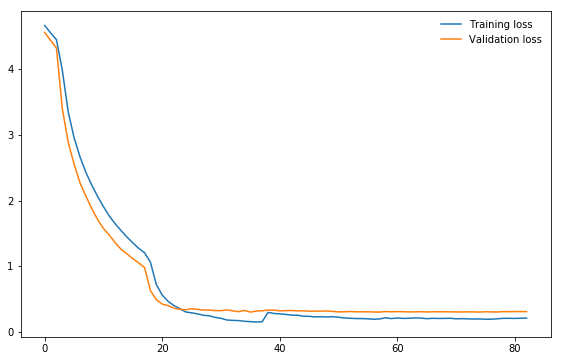

In [209]:
plt.rcParams['figure.figsize'] = [9.5, 6]

plt.plot(train_losses[2:], label="Training loss")
plt.plot(valid_losses[2:], label="Validation loss")
#plt.plot(val_acc_history[2:], label="Validation accuracy")
plt.legend(frameon=False)
#plt.ylim(ymin=-0.1) 
plt.show()

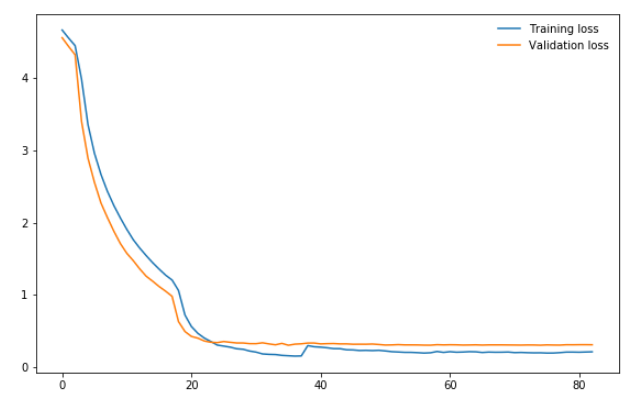

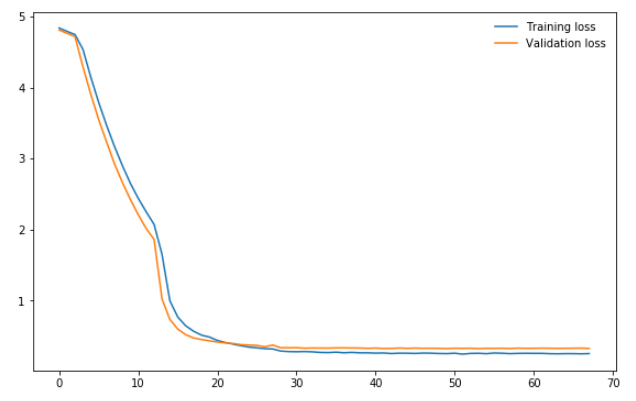

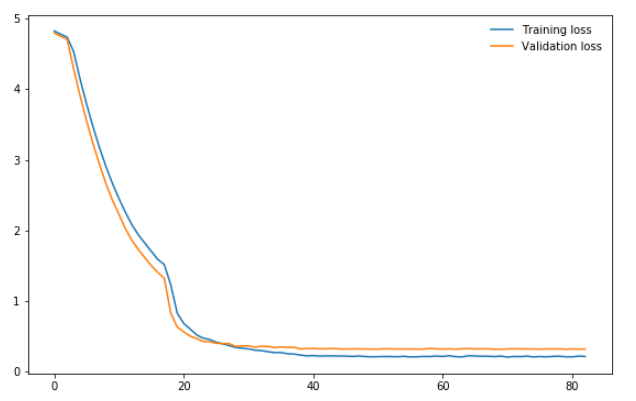

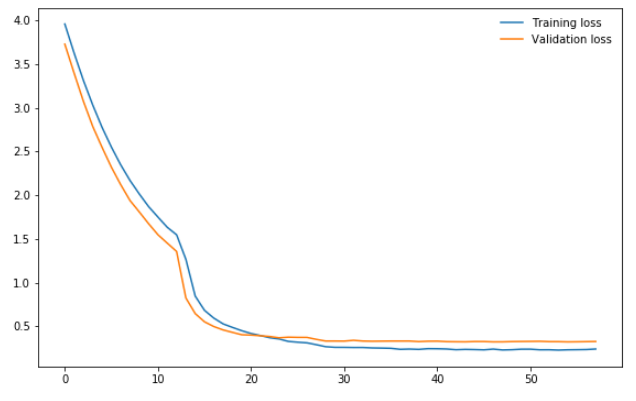

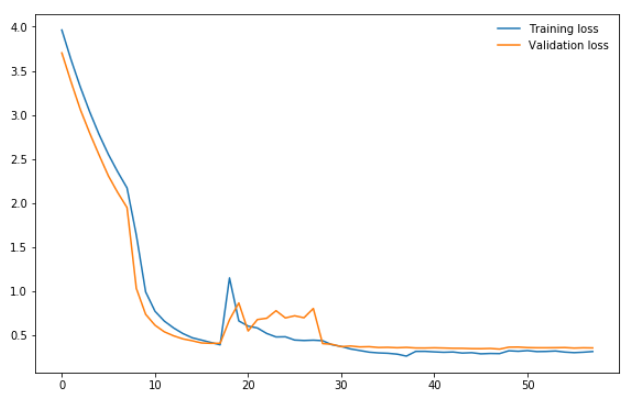

...

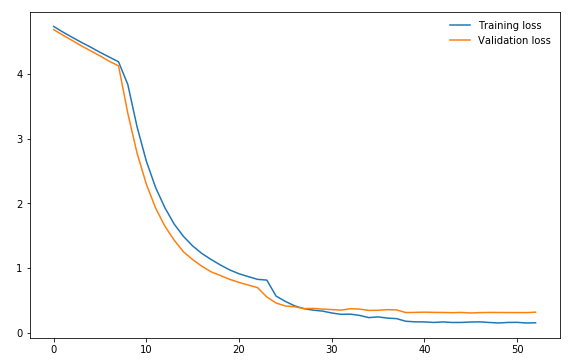

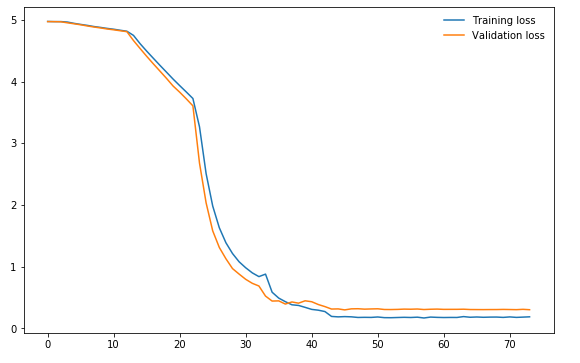

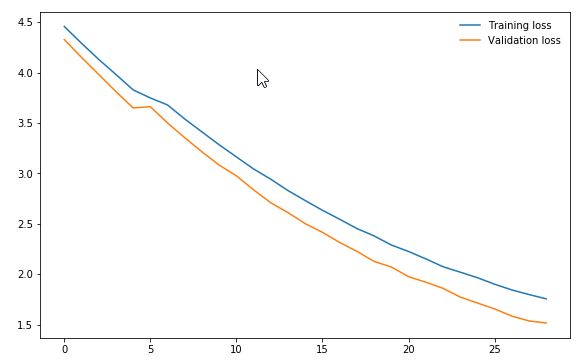

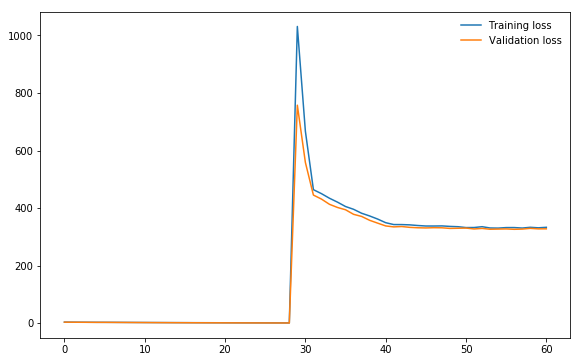

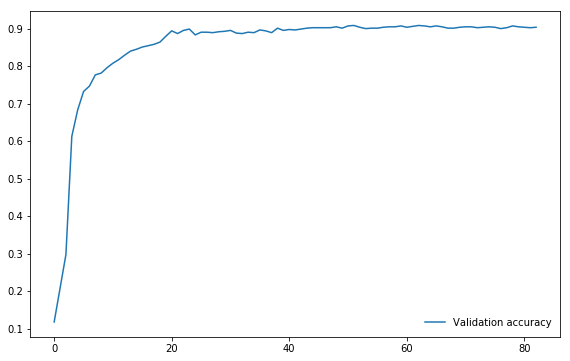

In [211]:
plt.rcParams['figure.figsize'] = [9.5, 6]

# plt.plot(train_losses[2:], label="Training loss")
# plt.plot(valid_losses[2:], label="Validation loss")
plt.plot(val_acc_history[2:], label="Validation accuracy")
plt.legend(frameon=False)
#plt.ylim(ymin=-0.1) 
plt.show()

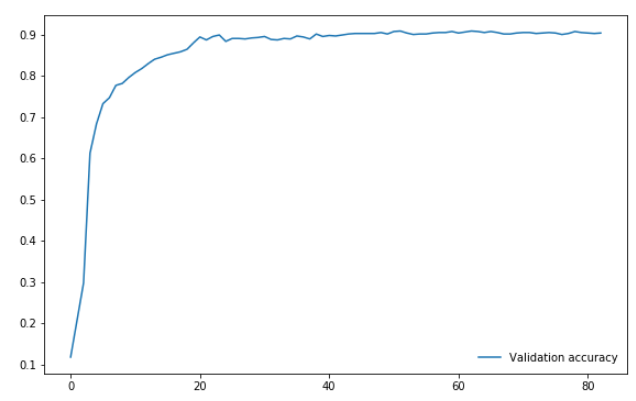

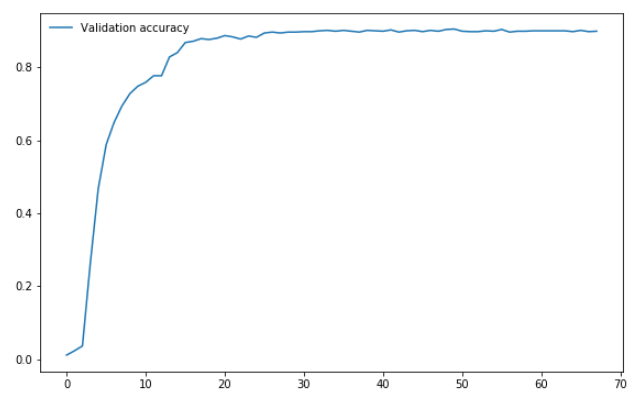

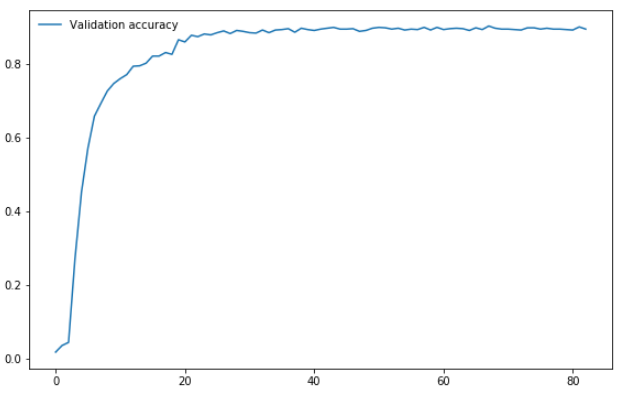

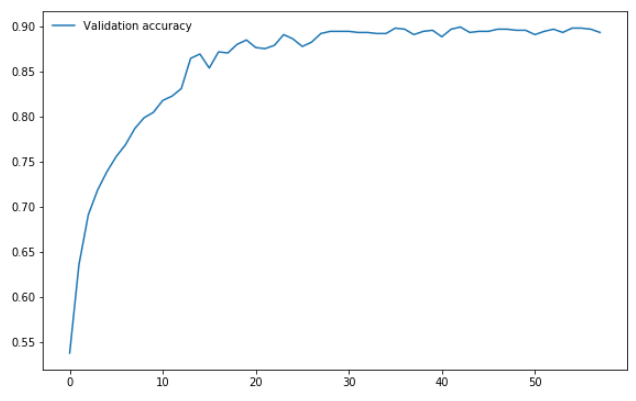

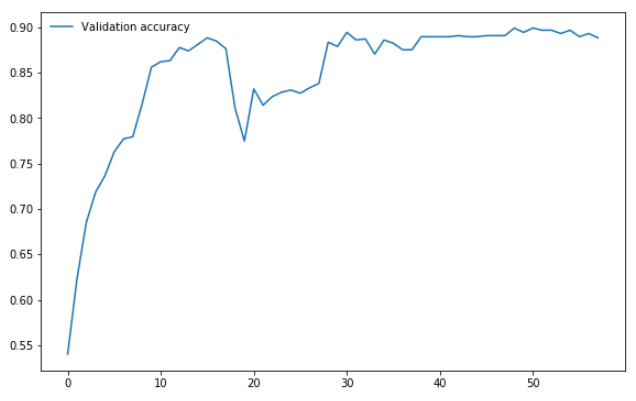

...

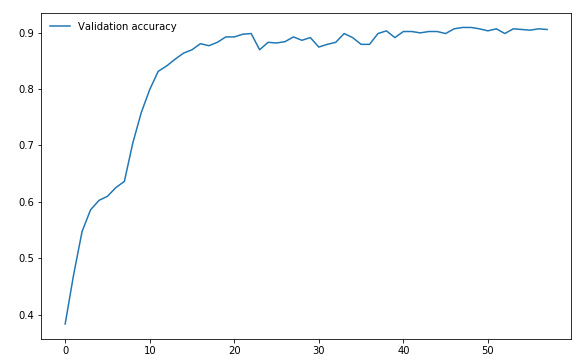

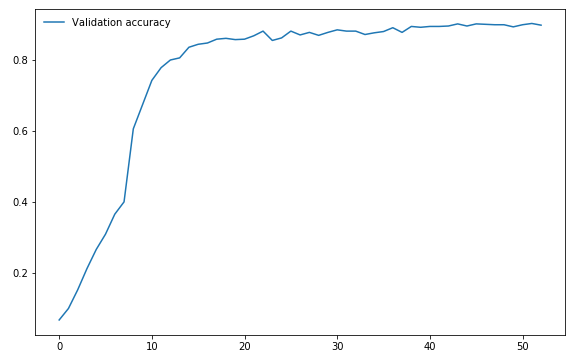

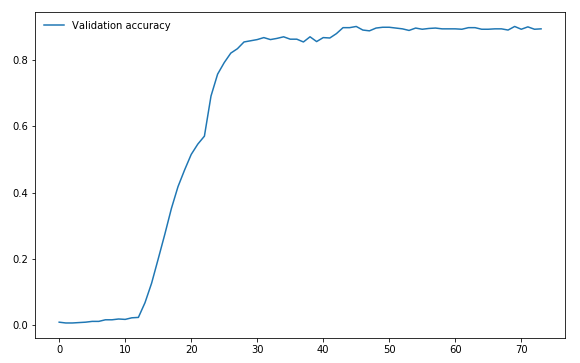

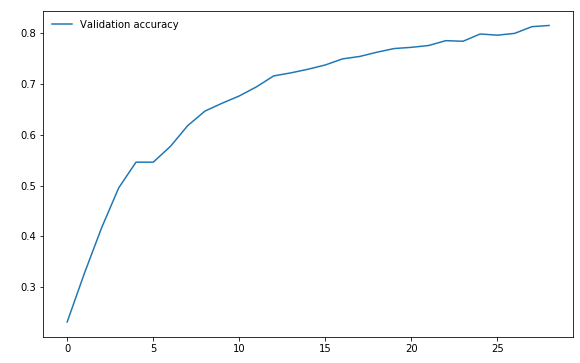

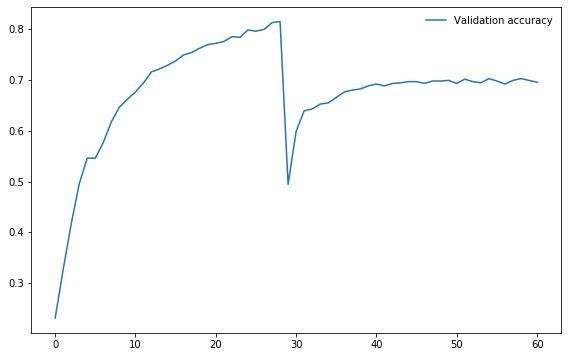

In [212]:
logs, losses = find_lr(model_scratch, optimizer_scratch, criterion_scratch, loaders_scratch)

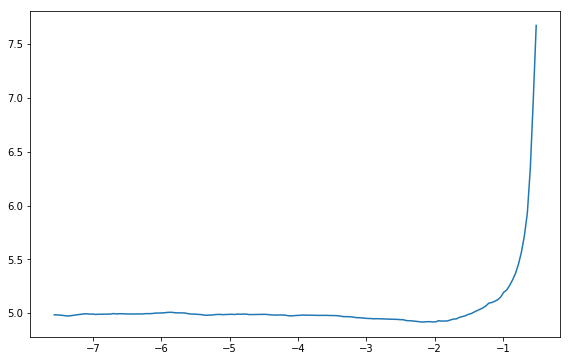

In [213]:
plt.rcParams['figure.figsize'] = [9.5, 6]

plt.plot(logs[10:-5],losses[10:-5])

### Save as state dictionary

In [214]:
checkpt = 'model_1cycle_1.pth'
torch.save({'model_statedict':model_transfer.state_dict(),
            'optimizer_statedict':optimizer_transfer.state_dict(), 
            'best_acc_epoch' : 48,
            'best_val_epoch' : 48,
            'train_losses' : train_losses, 
            'valid_losses' : valid_losses, 
            'val_acc_history' : val_acc_history,
            'train_acc_history' : train_acc_history}, 
           checkpt)

In [215]:
checkpt = 'model_1cycle_2.pth'
torch.save({'model_statedict':model_transfer.state_dict(),
            'optimizer_statedict':optimizer_transfer.state_dict(), 
            'best_acc_epoch' : 54,
            'best_val_epoch' : 48,
            'train_losses' : train_losses, 
            'valid_losses' : valid_losses, 
            'val_acc_history' : val_acc_history,
            'train_acc_history' : train_acc_history}, 
           checkpt)

In [216]:
checkpt = 'model_1cycle_3.pth'
torch.save({'model_statedict':model_transfer.state_dict(),
            'optimizer_statedict':optimizer_transfer.state_dict(), 
            'best_acc_epoch' : 50,
            'best_val_epoch' : 36,
            'train_losses' : train_losses, 
            'valid_losses' : valid_losses, 
            'val_acc_history' : val_acc_history,
            'train_acc_history' : train_acc_history}, 
           checkpt)

In [217]:
checkpt = 'model_std_wd.pth'
torch.save({'model_statedict':model_transfer.state_dict(),
            'optimizer_statedict':optimizer_transfer.state_dict(), 
            'best_acc_epoch' : 24,
            'best_val_epoch' : 30,
            'train_losses' : train_losses, 
            'valid_losses' : valid_losses, 
            'val_acc_history' : val_acc_history,
            'train_acc_history' : train_acc_history}, 
           checkpt)

In [218]:
checkpt = 'model_std_wd2.pth'
torch.save({'model_statedict':model_transfer.state_dict(),
            'optimizer_statedict':optimizer_transfer.state_dict(), 
            'best_acc_epoch' : 46,
            'best_val_epoch' : 50,
            'train_losses' : train_losses, 
            'valid_losses' : valid_losses, 
            'val_acc_history' : val_acc_history,
            'train_acc_history' : train_acc_history}, 
           checkpt)

In [219]:
checkpt = 'model_std_wd3.pth'
torch.save({'model_statedict':model_transfer.state_dict(),
            'optimizer_statedict':optimizer_transfer.state_dict(), 
            'best_acc_epoch' : 37,
            'best_val_epoch' : 28,
            'train_losses' : train_losses, 
            'valid_losses' : valid_losses, 
            'val_acc_history' : val_acc_history,
            'train_acc_history' : train_acc_history}, 
           checkpt)

In [220]:
checkpt = 'model_std_wd4.pth'
torch.save({'model_statedict':model_transfer.state_dict(),
            'optimizer_statedict':optimizer_transfer.state_dict(), 
            'best_acc_epoch' : 49,
            'best_val_epoch' : 34,
            'train_losses' : train_losses, 
            'valid_losses' : valid_losses, 
            'val_acc_history' : val_acc_history,
            'train_acc_history' : train_acc_history}, 
           checkpt)

In [221]:
checkpt = 'model_std_wd5.pth'
torch.save({'model_statedict':model_transfer.state_dict(),
            'optimizer_statedict':optimizer_transfer.state_dict(), 
            'best_acc_epoch' : 54,
            'best_val_epoch' : 49,
            'train_losses' : train_losses, 
            'valid_losses' : valid_losses, 
            'val_acc_history' : val_acc_history,
            'train_acc_history' : train_acc_history}, 
           checkpt)

In [222]:
checkpt = 'model_std_wd6.pth'
torch.save({'model_statedict':model_transfer.state_dict(),
            'optimizer_statedict':optimizer_transfer.state_dict(), 
            'best_acc_epoch' : 51,
            'best_val_epoch' : 50,
            'train_losses' : train_losses, 
            'valid_losses' : valid_losses, 
            'val_acc_history' : val_acc_history,
            'train_acc_history' : train_acc_history}, 
           checkpt)

In [223]:
checkpt = 'model_1cycle_wd7.pth'
torch.save({'model_statedict':model_transfer.state_dict(),
            'optimizer_statedict':optimizer_transfer.state_dict(), 
            'best_acc_epoch' : 45,
            'best_val_epoch' : 57,
            'train_losses' : train_losses, 
            'valid_losses' : valid_losses, 
            'val_acc_history' : val_acc_history,
            'train_acc_history' : train_acc_history}, 
           checkpt)

In [224]:
checkpt = 'model_1cycle_8' # was 'model_std_wd8.pth'
torch.save({'model_statedict':model_transfer.state_dict(),
            'optimizer_statedict':optimizer_transfer.state_dict(), 
            'best_acc_epoch' : 70,
            'best_val_epoch' : 72,
            'train_losses' : train_losses, 
            'valid_losses' : valid_losses, 
            'val_acc_history' : val_acc_history,
            'train_acc_history' : train_acc_history}, 
           checkpt)

In [225]:
checkpt = 'model_std_wd9.pth'
torch.save({'model_statedict':model_transfer.state_dict(),
            'optimizer_statedict':optimizer_transfer.state_dict(), 
            'best_acc_epoch' : 52,
            'best_val_epoch' : 56,
            'train_losses' : train_losses, 
            'valid_losses' : valid_losses, 
            'val_acc_history' : val_acc_history,
            'train_acc_history' : train_acc_history}, 
           checkpt)

In [226]:
print(best_acc_epoch)
print(best_val_epoch)

54
38


In [227]:
checkpt = 'model_1cycle_wd10.pth'
torch.save({'model_statedict':model_transfer.state_dict(),
            'optimizer_statedict':optimizer_transfer.state_dict(), 
            'best_acc_epoch' : 54,
            'best_val_epoch' : 38,
            'train_losses' : train_losses, 
            'valid_losses' : valid_losses, 
            'val_acc_history' : val_acc_history,
            'train_acc_history' : train_acc_history}, 
           checkpt)

## Save model state dict to specified name model_scratch.pt

In [229]:
best_model_wts = copy.deepcopy(model_transfer.state_dict())
best_optim_wts = copy.deepcopy(optimizer_transfer.state_dict())

torch.save(best_model_wts, 'model_transfer.pt')
torch.save(best_optim_wts, 'model_transfer_optimizer.pt') 

## Re-load if needed
**Accuracy...**

In [230]:
best_model_wts = torch.load("resnet152_acc_30.pt", map_location=lambda storage, loc: storage)
best_optim_wts = torch.load("resnet152_acc_30_optimizer.pt", map_location=lambda storage, loc: storage)

In [231]:
best_model_wts = torch.load("resnet152_acc_1cycle_1.pt", map_location=lambda storage, loc: storage)
best_optim_wts = torch.load("resnet152_acc_1cycle_1_optimizer.pt", map_location=lambda storage, loc: storage)

In [232]:
best_model_wts = torch.load("resnet152_acc_1cycle_2.pt", map_location=lambda storage, loc: storage)
best_optim_wts = torch.load("resnet152_acc_1cycle_2_optimizer.pt", map_location=lambda storage, loc: storage)

In [233]:
best_model_wts = torch.load("resnet152X_acc_1cycle_3.pt", map_location=lambda storage, loc: storage)
best_optim_wts = torch.load("resnet152X_acc_1cycle_3_optimizer.pt", map_location=lambda storage, loc: storage)

In [234]:
best_model_wts = torch.load("resnet152_acc_wd1.pt", map_location=lambda storage, loc: storage)
best_optim_wts = torch.load("resnet152_acc_wd1_optimizer.pt", map_location=lambda storage, loc: storage)

**or Loss...**

In [235]:
best_model_wts = torch.load("resnet152_30.pt", map_location=lambda storage, loc: storage)
best_optim_wts = torch.load("resnet152_30_optimizer.pt", map_location=lambda storage, loc: storage)

In [236]:
best_model_wts = torch.load("resnet152_1cycle_1.pt", map_location=lambda storage, loc: storage)
best_optim_wts = torch.load("resnet152_1cycle_1_optimizer.pt", map_location=lambda storage, loc: storage)

In [237]:
best_model_wts = torch.load("resnet152_1cycle_2.pt", map_location=lambda storage, loc: storage)
best_optim_wts = torch.load("resnet152_1cycle_2_optimizer.pt", map_location=lambda storage, loc: storage)

In [238]:
best_model_wts = torch.load("resnet152X_1cycle_3.pt", map_location=lambda storage, loc: storage)
best_optim_wts = torch.load("resnet152X_1cycle_3_optimizer.pt", map_location=lambda storage, loc: storage)

In [240]:
optimizer_transfer.load_state_dict(best_optim_wts)

In [241]:
model_transfer.load_state_dict(best_model_wts)
model_transfer.eval();

## If required, check expected state dict is currently loaded

In [242]:
state_dict = torch.load('resnet152RL_acc_1cycle_10.pt')
opt_state_dict  = torch.load('resnet152RL_acc_1cycle_10_optimizer.pt')

In [243]:
compare_dicts(model_transfer.state_dict(), state_dict)

State_Dicts match perfectly! :)


## Re-load dictionary if needed

**Using reload function will reset the validation and accuracy arrays to be as long as the best epoch...**

In [244]:
state_dicts_name = 'model_1cycle_1.pth'
learning_rate=1e-05
reloadModel(model_transfer, optimizer_transfer, state_dicts_name, learning_rate)

**Or, pass `resetarray=False` to preserve the arrays**

In [245]:
state_dicts_name = 'model_1cycle_1.pth'
learning_rate=1e-05
reloadModel(model_transfer, optimizer_transfer, state_dicts_name, learning_rate, resetarray=False)

In [246]:
state_dicts_name = 'model_1cycle_8.pth'
learning_rate=1e-05
reloadModel(model_transfer, optimizer_transfer, state_dicts_name, learning_rate)

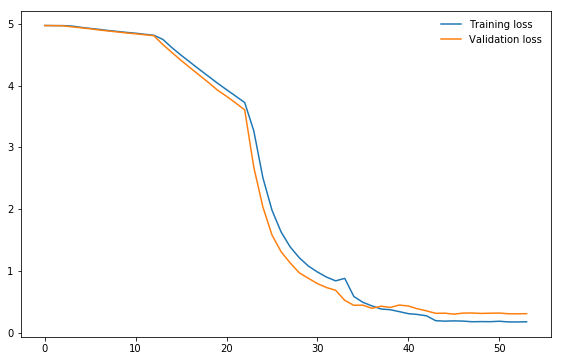

In [247]:
plt.rcParams['figure.figsize'] = [9.5, 6]

plt.plot(train_losses[2:56], label="Training loss")
plt.plot(valid_losses[2:56], label="Validation loss")
plt.legend(frameon=False)
plt.show()

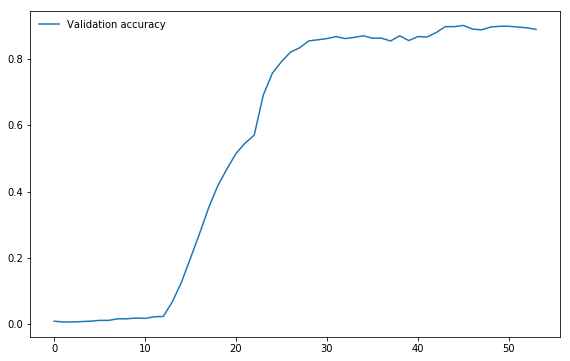

In [248]:
plt.rcParams['figure.figsize'] = [9.5, 6]

plt.plot(val_acc_history[2:56], label="Validation accuracy")
plt.legend(frameon=False)
plt.show()

In [249]:
len(train_losses), len(valid_losses), len(train_acc_history), len(val_acc_history), len(lr_hist)

(76, 76, 0, 76, 60)

### (IMPLEMENTATION) Test the Model

Try out your model on the test dataset of dog images. Use the code cell below to calculate and print the test loss and accuracy.  Ensure that your test accuracy is greater than 60%.

In [250]:
test(loaders_transfer, model_transfer, criterion_transfer, use_cuda)

Test Loss: 0.354985


Test Accuracy: 89% (749/836)


In [251]:
test(loaders_transfer, model_transfer, criterion_transfer, use_cuda)

Test Loss: 0.377083


Test Accuracy: 88% (743/836)


In [252]:
test(loaders_transfer, model_transfer, criterion_transfer, use_cuda)

Test Loss: 0.370314


Test Accuracy: 89% (751/836)


In [253]:
751/836

0.8983253588516746

In [254]:
test(loaders_transfer, model_transfer, criterion_transfer, use_cuda)

Test Loss: 0.375966


Test Accuracy: 88% (741/836)


In [255]:
test(loaders_transfer, model_transfer, criterion_transfer, use_cuda)

Test Loss: 0.404197


Test Accuracy: 88% (743/836)


In [256]:
test(loaders_transfer, model_transfer, criterion_transfer, use_cuda)

Test Loss: 0.395753


Test Accuracy: 88% (739/836)


In [257]:
test(loaders_transfer, model_transfer, criterion_transfer, use_cuda)

Test Loss: 3.099022


Test Accuracy: 88% (739/836)


In [258]:
test(loaders_transfer, model_transfer, criterion_transfer, use_cuda)

Test Loss: 2.294037


Test Accuracy: 87% (735/836)


In [259]:
test(loaders_transfer, model_transfer, criterion_transfer, use_cuda)

Test Loss: 2.359733


Test Accuracy: 87% (735/836)


In [260]:
test(loaders_transfer, model_transfer, criterion_transfer, use_cuda)

Test Loss: 1.888080


Test Accuracy: 88% (740/836)


In [261]:
test(loaders_transfer, model_transfer, criterion_transfer, use_cuda)

Test Loss: 0.357339


Test Accuracy: 90% (753/836)


**Model 2, simple replacement classifier**
- Run 1
```
Test Loss: 0.357339
Test Accuracy: 90% (753/836)
```
- Run 2
```
Test Loss: 0.375682
Test Accuracy: 89% (746/836)
```
   
**Model 2, 2 layers classifier** 
```
Test Loss: 0.417278
Test Accuracy: 89% (750/836)
```

In [262]:
logs, losses = find_lr(model_transfer, optimizer_transfer, criterion_transfer, loaders_transfer)

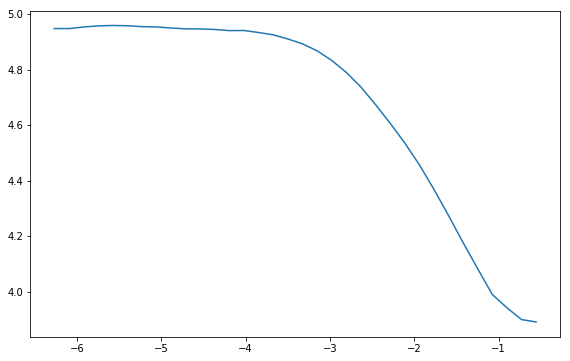

In [263]:
plt.rcParams['figure.figsize'] = [9.5, 6]

plt.plot(logs[10:-5],losses[10:-5])

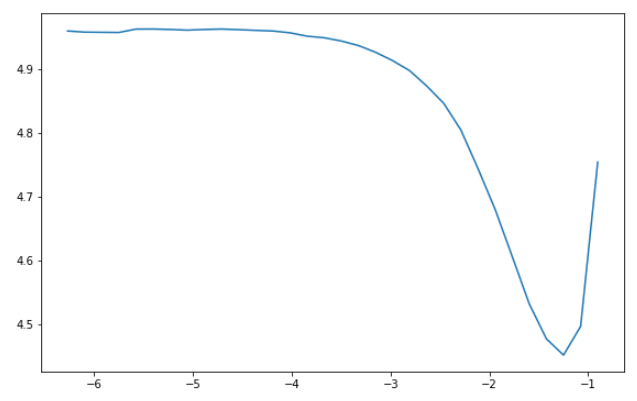

In [264]:
print(1e-02)
print(1e-03)
print(0.05)

0.01
0.001
0.05


## Set up standard ImageNet predictor to assist with assessing non-dog images

In [265]:
import torch
import torchvision.models as models
ImageNetDict = eval(open("imagenet1000_clsidx_to_labels.txt").read())

resnetImageNet = models.resnet152(pretrained=True)
resnetImageNet.class_to_name = ImageNetDict
resnetImageNet.eval();

In [266]:
ImageNetDict

{0: 'tench, Tinca tinca',
 1: 'goldfish, Carassius auratus',
 2: 'great white shark, white shark, man-eater, man-eating shark, Carcharodon carcharias',
 3: 'tiger shark, Galeocerdo cuvieri',
 4: 'hammerhead, hammerhead shark',
 5: 'electric ray, crampfish, numbfish, torpedo',
 6: 'stingray',
 7: 'cock',
 8: 'hen',
 9: 'ostrich, Struthio camelus',
 10: 'brambling, Fringilla montifringilla',
 11: 'goldfinch, Carduelis carduelis',
 12: 'house finch, linnet, Carpodacus mexicanus',
 13: 'junco, snowbird',
 14: 'indigo bunting, indigo finch, indigo bird, Passerina cyanea',
 15: 'robin, American robin, Turdus migratorius',
 16: 'bulbul',
 17: 'jay',
 18: 'magpie',
 19: 'chickadee',
 20: 'water ouzel, dipper',
 21: 'kite',
 22: 'bald eagle, American eagle, Haliaeetus leucocephalus',
 23: 'vulture',
 24: 'great grey owl, great gray owl, Strix nebulosa',
 25: 'European fire salamander, Salamandra salamandra',
 26: 'common newt, Triturus vulgaris',
 27: 'eft',
 28: 'spotted salamander, Ambystoma 

In [267]:
def ImageNet_predict(img_path, topk=1):
    '''
    Use pre-trained resnet152 model to obtain index corresponding to 
    predicted ImageNet class for image at specified path
    
    Args:
        img_path: path to an image
        topk: number of predictions to return (allow for top 5 for instance)
        
    Returns:
        Index(s) corresponding to resnet152 model's prediction
        Probability of the prediction(s)
    '''
    
    img = img_process(img_path)
    img_tensor = torch.from_numpy(img).type(torch.FloatTensor)
    img_tensor.unsqueeze_(0)

    resnetImageNet.cpu()
    resnetImageNet.eval()
    
    with torch.no_grad():
        log_ps = torch.softmax(resnetImageNet.forward(img_tensor), dim=1)
        probs, classes = torch.topk(log_ps, k=topk)

        probs = probs.view(topk).detach().numpy().tolist()
        classes = classes.view(topk).detach().numpy().tolist()
        classnames = [resnetImageNet.class_to_name[cls] for cls in classes]
        
    return classes, classnames, probs

def ImageNet_dog_detector(img_path, inclPrediction=False):
    prediction = ImageNet_predict(img_path)
    
    dog_detected = (prediction[0][0] in range(151, 269))
    
    if inclPrediction==True:
        return (dog_detected, prediction)
    else:    
        return dog_detected

In [268]:
class_names = [item[4:].replace("_", " ") for item in image_datasets['train'].classes]

In [269]:
dict(zip(range(133), class_names))

{0: 'Affenpinscher',
 1: 'Afghan hound',
 2: 'Airedale terrier',
 3: 'Akita',
 4: 'Alaskan malamute',
 5: 'American eskimo dog',
 6: 'American foxhound',
 7: 'American staffordshire terrier',
 8: 'American water spaniel',
 9: 'Anatolian shepherd dog',
 10: 'Australian cattle dog',
 11: 'Australian shepherd',
 12: 'Australian terrier',
 13: 'Basenji',
 14: 'Basset hound',
 15: 'Beagle',
 16: 'Bearded collie',
 17: 'Beauceron',
 18: 'Bedlington terrier',
 19: 'Belgian malinois',
 20: 'Belgian sheepdog',
 21: 'Belgian tervuren',
 22: 'Bernese mountain dog',
 23: 'Bichon frise',
 24: 'Black and tan coonhound',
 25: 'Black russian terrier',
 26: 'Bloodhound',
 27: 'Bluetick coonhound',
 28: 'Border collie',
 29: 'Border terrier',
 30: 'Borzoi',
 31: 'Boston terrier',
 32: 'Bouvier des flandres',
 33: 'Boxer',
 34: 'Boykin spaniel',
 35: 'Briard',
 36: 'Brittany',
 37: 'Brussels griffon',
 38: 'Bull terrier',
 39: 'Bulldog',
 40: 'Bullmastiff',
 41: 'Cairn terrier',
 42: 'Canaan dog',
 43: '

### (IMPLEMENTATION) Predict Dog Breed with the Model

Write a function that takes an image path as input and returns the dog breed (`Affenpinscher`, `Afghan hound`, etc) that is predicted by your model.  

In [270]:
class_examples = eval(open("dog_examples.txt").read())
class_examples

{0: 'dog_images/train/001.Affenpinscher/Affenpinscher_00029.jpg',
 1: 'dog_images/train/002.Afghan_hound/Afghan_hound_00086.jpg',
 2: 'dog_images/train/003.Airedale_terrier/Airedale_terrier_00181.jpg',
 3: 'dog_images/train/004.Akita/Akita_00254.jpg',
 4: 'dog_images/train/005.Alaskan_malamute/Alaskan_malamute_00322.jpg',
 5: 'dog_images/train/006.American_eskimo_dog/American_eskimo_dog_00405.jpg',
 6: 'dog_images/train/007.American_foxhound/American_foxhound_00492.jpg',
 7: 'dog_images/train/008.American_staffordshire_terrier/American_staffordshire_terrier_00576.jpg',
 8: 'dog_images/train/009.American_water_spaniel/American_water_spaniel_00635.jpg',
 9: 'dog_images/train/010.Anatolian_shepherd_dog/Anatolian_shepherd_dog_00701.jpg',
 10: 'dog_images/train/011.Australian_cattle_dog/Australian_cattle_dog_00723.jpg',
 11: 'dog_images/train/012.Australian_shepherd/Australian_shepherd_00809.jpg',
 12: 'dog_images/train/013.Australian_terrier/Australian_terrier_00909.jpg',
 13: 'dog_images/

In [271]:
import ntpath
img_path = 'dog_images/train/001.Affenpinscher/Affenpinscher_00029.jpg'
img_name = ntpath.basename(img_path)
dir_name = ntpath.dirname(img_path)
print(img_path)
print(img_name)
print(dir_name)
print(ntpath.basename(dir_name) + "/" + img_name)
print(ntpath.basename(ntpath.dirname(img_path)) + "/" + ntpath.basename(img_path))

dog_images/train/001.Affenpinscher/Affenpinscher_00029.jpg
Affenpinscher_00029.jpg
dog_images/train/001.Affenpinscher
001.Affenpinscher/Affenpinscher_00029.jpg
001.Affenpinscher/Affenpinscher_00029.jpg


In [272]:
'dog_images/' in img_path

True

In [273]:
### TODO: Write a function that takes a path to an image as input
### and returns the dog breed that is predicted by the model.

# list of class names by index, i.e. a name can be accessed like class_names[0]
class_names = [item[4:].replace("_", " ") for item in image_datasets['train'].classes]
class_examples = eval(open("dog_examples.txt").read())

model_transfer.class_to_name = dict(zip(range(133), class_names))
model_transfer.class_to_example = class_examples

def predict_breed_transfer(img_path, topk=1):
    # load the image and return the predicted breed
    img = img_process(img_path)
    
    img_tensor = torch.from_numpy(img).type(torch.FloatTensor)
    img_tensor.unsqueeze_(0)

    model_transfer.cpu()
    model_transfer.eval()
    
    with torch.no_grad():
        log_ps = torch.softmax(model_transfer.forward(img_tensor), dim=1)
        probs, classes = torch.topk(log_ps, k=topk)

        probs = probs.view(topk).detach().numpy().tolist()
        classes = classes.view(topk).detach().numpy().tolist()
        classnames = [model_transfer.class_to_name[cls] for cls in classes]
        classexamples = [model_transfer.class_to_example[cls] for cls in classes]
        
    return classnames, classes, probs, classexamples   

In [274]:
predict_breed_transfer('dog_images/train/001.Affenpinscher/Affenpinscher_00029.jpg')

(['Affenpinscher'],
 [0],
 [0.980492115020752],
 ['dog_images/train/001.Affenpinscher/Affenpinscher_00029.jpg'])

In [275]:
predict_breed_transfer('dog_images/test/011.Australian_cattle_dog/Australian_cattle_dog_00728.jpg', 5)

(['Finnish spitz',
  'Australian cattle dog',
  'Canaan dog',
  'Nova scotia duck tolling retriever',
  'Basenji'],
 [66, 10, 42, 111, 13],
 [0.38504838943481445,
  0.339610755443573,
  0.04111021012067795,
  0.033640213310718536,
  0.026587525382637978],
 ['dog_images/train/067.Finnish_spitz/Finnish_spitz_04655.jpg',
  'dog_images/train/011.Australian_cattle_dog/Australian_cattle_dog_00723.jpg',
  'dog_images/train/043.Canaan_dog/Canaan_dog_03061.jpg',
  'dog_images/train/112.Nova_scotia_duck_tolling_retriever/Nova_scotia_duck_tolling_retriever_07280.jpg',
  'dog_images/train/014.Basenji/Basenji_00992.jpg'])

In [276]:
img_path = 'dog_images\train\032.Boston_terrier\Boston_terrier_02229.jpg'
img_path

'dog_images\train\x1a.Boston_terrier\\Boston_terrier_02229.jpg'

In [277]:
img_path = 'dog_images\train\032.Boston_terrier\Boston_terrier_02229.jpg'
Image.open(img_path)

OSError: [Errno 22] Invalid argument: 'dog_images\train\x1a.Boston_terrier\\Boston_terrier_02229.jpg'

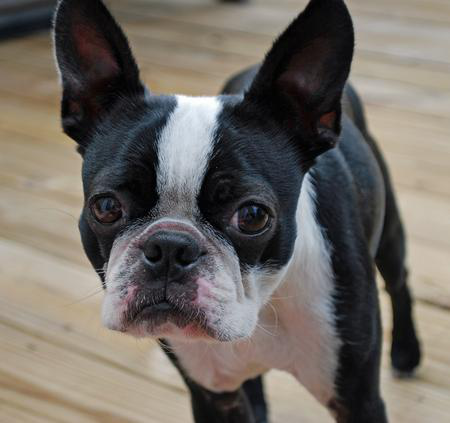

In [278]:
img_path = 'dog_images\\train\\032.Boston_terrier\Boston_terrier_02229.jpg'
Image.open(img_path)

In [279]:
predict_breed_transfer('lfw/Adam_Sandler/Adam_Sandler_0001.jpg', 5)

(['Field spaniel',
  'Chihuahua',
  'Entlebucher mountain dog',
  'Manchester terrier',
  'Smooth fox terrier'],
 [65, 47, 64, 101, 127],
 [0.12647433578968048,
  0.08036021143198013,
  0.04866704344749451,
  0.035429712384939194,
  0.027903858572244644],
 ['dog_images/train/066.Field_spaniel/Field_spaniel_04612.jpg',
  'dog_images/train/048.Chihuahua/Chihuahua_03410.jpg',
  'dog_images/train/065.Entlebucher_mountain_dog/Entlebucher_mountain_dog_04553.jpg',
  'dog_images/train/102.Manchester_terrier/Manchester_terrier_06775.jpg',
  'dog_images/train/128.Smooth_fox_terrier/Smooth_fox_terrier_08097.jpg'])

In [280]:
ImageNet_predict('lfw/Adam_Sandler/Adam_Sandler_0001.jpg')

([834], ['suit, suit of clothes'], [0.5045909881591797])

In [281]:
ImageNet_dog_detector('lfw/Adam_Sandler/Adam_Sandler_0001.jpg', True)

(False, ([834], ['suit, suit of clothes'], [0.5045909881591797]))

In [282]:
ImageNet_predict('dog_images/test/072.German_shorthaired_pointer/German_shorthaired_pointer_04986.jpg')

([210], ['German short-haired pointer'], [0.9985736608505249])

In [283]:
predict_breed_transfer('lfw/Adam_Ant/Adam_Ant_0001.jpg')

(['Dogue de bordeaux'],
 [59],
 [0.10470885038375854],
 ['dog_images/train/060.Dogue_de_bordeaux/Dogue_de_bordeaux_04240.jpg'])

In [284]:
ImageNet_predict('lfw/Adam_Ant/Adam_Ant_0001.jpg')

([834], ['suit, suit of clothes'], [0.1788342148065567])

In [285]:
ImageNet_predict('images/cat.3.jpg')

([285], ['Egyptian cat'], [0.5531317591667175])

In [286]:
ImageNet_predict('images/cat.10.jpg')

([281], ['tabby, tabby cat'], [0.6989806294441223])

In [287]:
ImageNet_predict('images/cat.69.jpg')

([287], ['lynx, catamount'], [0.9721828699111938])

In [288]:
predict_breed_transfer('images/sample_human_output.png')

ValueError: operands could not be broadcast together with shapes (224,224,4) (3,) 

In [289]:
Alexis = predict_breed_transfer('images/sample_human_output.jpg')
Alexis

(['Bedlington terrier'],
 [18],
 [0.12893639504909515],
 ['dog_images/train/019.Bedlington_terrier/Bedlington_terrier_01374.jpg'])

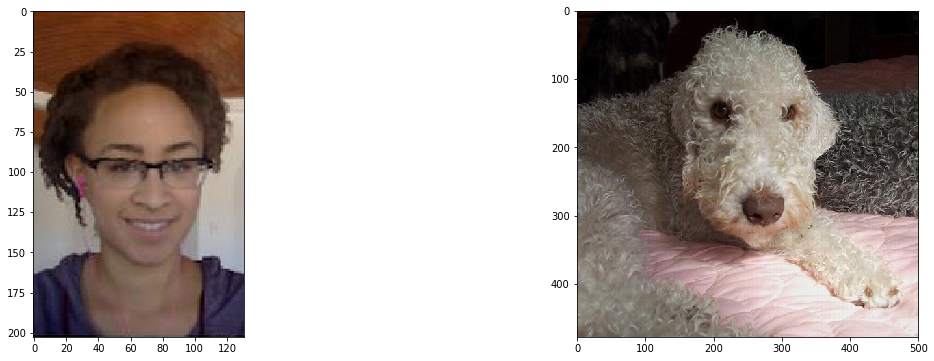

In [290]:
Alexis = predict_breed_transfer('images/sample_human_output.jpg')
_, axes = plt.subplots(figsize=(20,6), ncols=2)

for ii in range(2):
    ax = axes[ii]
    if ii == 0:
        img = cv2.imread('images/sample_human_output.jpg')
    else:
        img = cv2.imread(*Alexis[3]) 
#     cv_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
#     ax.imshow(cv_rgb)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    ax.imshow(img)    

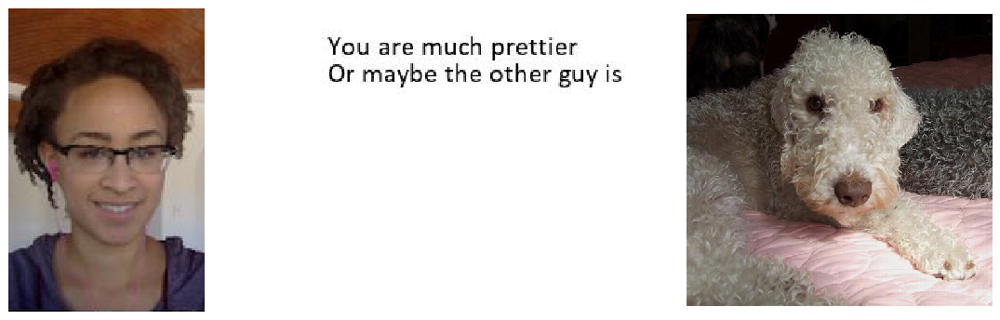

In [291]:
from PIL import ImageDraw
from PIL import ImageFont

Alexis = predict_breed_transfer('images/sample_human_output.jpg')
_, axes = plt.subplots(figsize=(20,6), ncols=3)

for ii in range(3):
    ax = axes[ii]
    if ii == 0:
        img = cv2.imread('images/sample_human_output.jpg')
    elif ii == 1:
        newimg = Image.new('RGB', (224, 224), (255, 255, 255))
        fnt = ImageFont.truetype('images/calibri.ttf', 20)
        d = ImageDraw.Draw(newimg)
        d.text((5, 20), 'You are much prettier', font=fnt, fill=(0, 0, 0))
        d.text((5, 40), 'Or maybe the other guy is', font=fnt, fill=(0, 0, 0))
        newimg.save('images/textmsg.jpg')
        img = cv2.imread('images/textmsg.jpg')
    else:
        img = cv2.imread(*Alexis[3]) 
#     cv_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
#     ax.imshow(cv_rgb)
    
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    ax.imshow(img)   
    ax.set_axis_off()
    ax.tick_params(axis='both', length=0)
    ax.set_xticklabels('')
    ax.set_yticklabels('')    

In [292]:
dog_breed_data = predict_breed_transfer('images/sample_human_output.jpg')
dog_breed_data

(['Bedlington terrier'],
 [18],
 [0.12893639504909515],
 ['dog_images/train/019.Bedlington_terrier/Bedlington_terrier_01374.jpg'])

In [293]:
img_path = dog_breed_data[3][0]
img_path

'dog_images/train/019.Bedlington_terrier/Bedlington_terrier_01374.jpg'

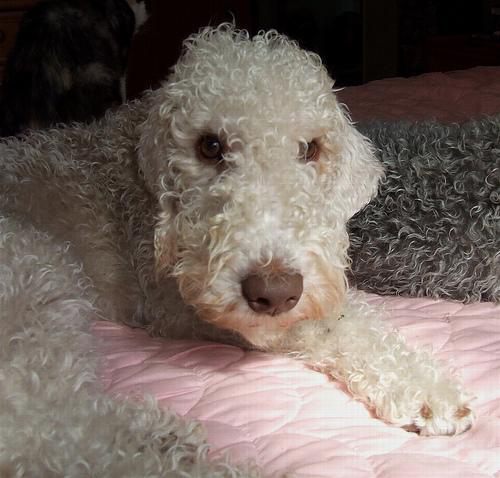

In [294]:
Image.open(img_path)

In [295]:
img_path = 'dog_images/train/130.Welsh_springer_spaniel/Welsh_springer_spaniel_08205.jpg'

In [296]:
# Resize image by specifying longer side size
# http://corochann.com/basic-image-processing-tutorial-1220.html
def resize_longedge(image, pixel):
    """Resize the input image
    
    Longer edge size will be `pixel`, and aspect ratio doesn't change
    """
    height, width = image.shape[:2]
    longer_side = max(height, width)
    ratio = float(pixel) / longer_side
    return cv2.resize(image, None, fx=ratio, fy=ratio)  # size must be int

In [297]:
def resize_shortedge(image, pixel):
    """Resize the input image
    
    Shorter edge size will be `pixel`, and aspect ratio doesn't change
    """
    height, width = image.shape[:2]
    shorter_side = min(height, width)
    ratio = float(pixel) / shorter_side
    return cv2.resize(image, None, fx=ratio, fy=ratio)  # size must be int

In [298]:
ground_truth_img = cv2.imread(img_path)
ground_truth_img = cv2.cvtColor(ground_truth_img, cv2.COLOR_BGR2RGB)

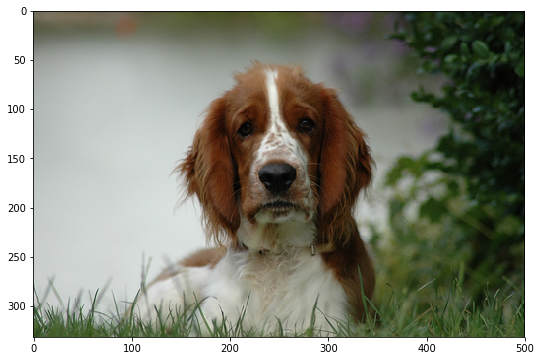

In [299]:
plt.imshow(ground_truth_img)

cropped_image.shape (Height, Width, Channel) =  (332, 332, 3)


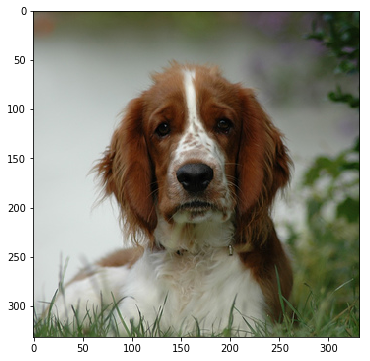

In [300]:
height, width = ground_truth_img.shape[:2]
crop_length = min(height, width)
height_start = (height - crop_length) // 2
width_start = (width - crop_length) // 2
cropped_image = ground_truth_img[
                height_start:height_start+crop_length, 
                width_start:width_start+crop_length,
                :]
print('cropped_image.shape (Height, Width, Channel) = ', cropped_image.shape)
plt.imshow(cropped_image)

resized224_image.shape (Height, Width, Channel) =  (149, 224, 3)


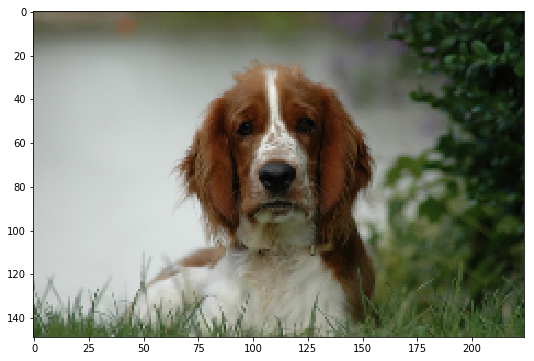

In [301]:
resized224_image = resize_longedge(ground_truth_img, 224)
print('resized224_image.shape (Height, Width, Channel) = ', resized224_image.shape)
plt.imshow(resized224_image)

resized224_shortimage.shape (Height, Width, Channel) =  (224, 337, 3)


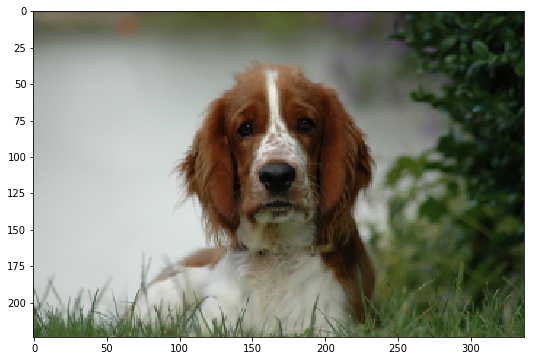

In [302]:
resized224_shortimage = resize_shortedge(ground_truth_img, 224)
print('resized224_shortimage.shape (Height, Width, Channel) = ', resized224_shortimage.shape)
plt.imshow(resized224_shortimage)

In [303]:
os.path.split('/DeepLearning/data/dog_app/dog_images\\test\\001.Affenpinscher\\Affenpinscher_00003.jpg')

('/DeepLearning/data/dog_app/dog_images\\test\\001.Affenpinscher',
 'Affenpinscher_00003.jpg')

In [304]:
os.path.basename('/DeepLearning/data/dog_app/dog_images\\test\\001.Affenpinscher\\Affenpinscher_00003.jpg')

'Affenpinscher_00003.jpg'

In [305]:
import ntpath
ntpath.basename('/DeepLearning/data/dog_app/dog_images\\test\\001.Affenpinscher\\Affenpinscher_00003.jpg')

'Affenpinscher_00003.jpg'

In [306]:
('dog_images/' in img_path.lower()) or ('dog_images\\' in img_path.lower())

True

---
<a id='step5'></a>
## Step 5: Write your Algorithm

Write an algorithm that accepts a file path to an image and first determines whether the image contains a human, dog, or neither.  Then,
- if a __dog__ is detected in the image, return the predicted breed.
- if a __human__ is detected in the image, return the resembling dog breed.
- if __neither__ is detected in the image, provide output that indicates an error.

You are welcome to write your own functions for detecting humans and dogs in images, but feel free to use the `face_detector` and `human_detector` functions developed above.  You are __required__ to use your CNN from Step 4 to predict dog breed.  

Some sample output for our algorithm is provided below, but feel free to design your own user experience!

![Sample Human Output](images/sample_human_output.png)


### (IMPLEMENTATION) Write your Algorithm

In [307]:
### TODO: Write your algorithm.
### Feel free to use as many code cells as needed.

In [308]:
import ntpath

def face_detector2(img_path):
    img = cv2.imread(img_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    faces = face_cascade.detectMultiScale(gray)
    faces_found = len(faces) > 0
    if faces_found:
        for (x,y,w,h) in faces:
            # add bounding box to color image
            cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2) 
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    return (faces_found, img)

def process_prediction(img_path, threshold=0.35):
    ## handle cases for a human face, dog, and neither
    isdog = False
    ishuman = False
    isunknown = False
    altClass = ""
    
    isFromDogData = ('dog_images/' in img_path.lower()) or ('dog_images\\' in img_path.lower())
    isFromHumanData = ('lfw/' in img_path.lower()) or ('lfw\\' in img_path.lower())

    dog_breed_data = predict_breed_transfer(img_path)
    imagenet_data = ImageNet_dog_detector(img_path, True)
    altClass = imagenet_data[1][0]
    altClassName = imagenet_data[1][1]
    
    prediction = dog_breed_data[2][0]
    
    # Signify a dog if the probabilty of a dog is above a threshold 
    isdog = (prediction > threshold)
        
    # If the probabilty of a dog falls below a threshold and a standard imagenet classifier returns non-dog, make it unknown
    if isdog == False:
        if imagenet_data[0] == False:
            isunknown = True
        
    face_data = face_detector2(img_path)
    
    if face_data[0] > 0: ### or altClass in [834]:
        # could be a human
        ishuman = True
        img = face_data[1]
    else:
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    # ground truth image... square crop it
    # see http://corochann.com/basic-image-processing-tutorial-1220.html
    ground_truth_img = cv2.imread(dog_breed_data[3][0])
    ground_truth_img = cv2.cvtColor(ground_truth_img, cv2.COLOR_BGR2RGB)
    height, width = ground_truth_img.shape[:2]
    crop_length = min(height, width)
    height_start = (height - crop_length) // 2
    width_start = (width - crop_length) // 2
    ground_truth_img = ground_truth_img[
                    height_start:height_start+crop_length, 
                    width_start:width_start+crop_length,
                    :]

    return dog_breed_data, imagenet_data, [isdog, ishuman, isunknown, isFromDogData, isFromHumanData], img, ground_truth_img

def run_app(img_path, threshold=0.35):
    img_name = ntpath.basename(ntpath.dirname(img_path)) + "/" + ntpath.basename(img_path)
    subject_name = ntpath.basename(img_path).replace("_", " ")
    color = "black"
    
    image_data = process_prediction(img_path, threshold)
    
    prediction = image_data[0][2]
    prediction = prediction[0]
    
    imagenetdog  = image_data[1][0]
    imagenetpred = image_data[1][1][0][0]
    imagenetname = image_data[1][1][1][0]
    
    # image_data[2] = [isdog, ishuman, isunknown, isFromDogData, isFromHuamData] 
    if image_data[2][0] == True and image_data[2][3] == True:
        message1 = "You are a dog for sure!"
        message2 = ""
    elif image_data[2][0] == True and image_data[2][1] == True:
        message1 = str(round(prediction * 100)) + "% like the guy on the right!" 
        message2 = "but, maybe you are people..."
    elif image_data[2][0] == False and image_data[2][1] == True:
        message1 = "Look like a human, yay!"
        message2 = "the lucky dog looks like you!"
    elif image_data[2][0] == True and prediction > threshold:
        message1 = "Look like a dog for sure..."
        message2 = ""
    elif prediction <= threshold:
        message1 = "Somthing doggy about you..."
        message2 = "not sure what kind of dog!"
        if imagenetdog == False:
            if imagenetpred in range(269,280): # wolves etc.
                message2 = "maybe a cousin of sorts?"
            elif imagenetpred in range(280,294): # cats etc.
                message2 = "some cat disagrees :)"
            elif imagenetpred in range(294,298): # bears etc.    
                message2 = "can you bear the thought?"
            elif imagenetpred in range(365,385): # primates
                message2 = "just monkeying around!"
            elif imagenetpred >= 398: # man-made stuff...
                message2 = "but that doesn't seem possible!"
            else:
                message2 = "but nobody is perfect!"
    elif image_data[2][0] == False:
        message1 = "What are you?"
        message2 = "??????"
    elif image_data[2][2] == True:
        message1 = "I know you're unknown..."
        message2 = "How can that be?"
    else:
        message1 = "I know nothing!"
        message2 = ""
        
    _, axes = plt.subplots(figsize=(20,6), ncols=3)

    for ii in range(3):
        ax = axes[ii]
        if ii == 0:
            img = image_data[3]
            title = subject_name
            filename =  img_name
        elif ii == 1:
            newimg = Image.new('RGB', (224, 224), (255, 255, 255))
            fnt = ImageFont.truetype('images/calibri.ttf', 18)
            d = ImageDraw.Draw(newimg)
            d.text((4, 20), message1, font=fnt, fill=(0, 0, 0))
            d.text((5, 50), message2, font=fnt, fill=(0, 0, 0))
            newimg.save('images/textmsg.jpg')
            img = cv2.imread('images/textmsg.jpg')
            title = ""
            filename = ""
        else:
            img = image_data[4]
            title = image_data[0][0]
            title = title[0]
            filename = ""

        ax.imshow(img)    
        ax.tick_params(axis='both', length=0)
        ax.set_xticklabels('')
        ax.set_yticklabels('')
        
        ax.set_title(title, color=color)
        ax.set_xlabel(filename)
        if ii == 1:
            ax.set_axis_off()
            
    if os.path.isfile('images/textmsg.jpg'):    
        os.remove('images/textmsg.jpg') 

---
<a id='step6'></a>
## Step 6: Test Your Algorithm

In this section, you will take your new algorithm for a spin!  What kind of dog does the algorithm think that _you_ look like?  If you have a dog, does it predict your dog's breed accurately?  If you have a cat, does it mistakenly think that your cat is a dog?

### (IMPLEMENTATION) Test Your Algorithm on Sample Images!

Test your algorithm at least six images on your computer.  Feel free to use any images you like.  Use at least two human and two dog images.  

__Question 6:__ Is the output better than you expected :) ?  Or worse :( ?  Provide at least three possible points of improvement for your algorithm.

__Answer:__ (Three possible points for improvement)

In [309]:
process_prediction('images/wolf_2.jpg')[:3]

((['Icelandic sheepdog'],
  [83],
  [0.24406982958316803],
  ['dog_images/train/084.Icelandic_sheepdog/Icelandic_sheepdog_05715.jpg']),
 (False,
  ([269],
   ['timber wolf, grey wolf, gray wolf, Canis lupus'],
   [0.9177256226539612])),
 [False, False, True, False, False])

269
269


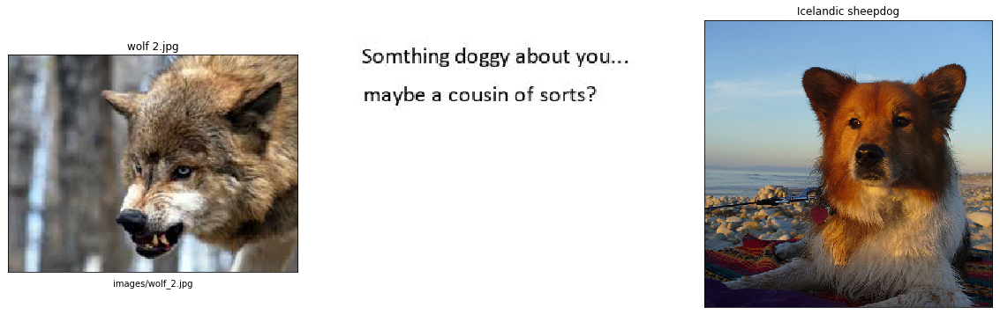

In [310]:
run_app('images/wolf_2.jpg')

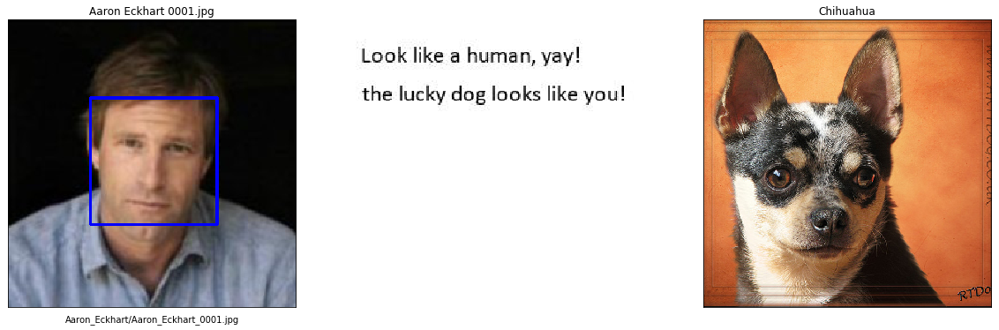

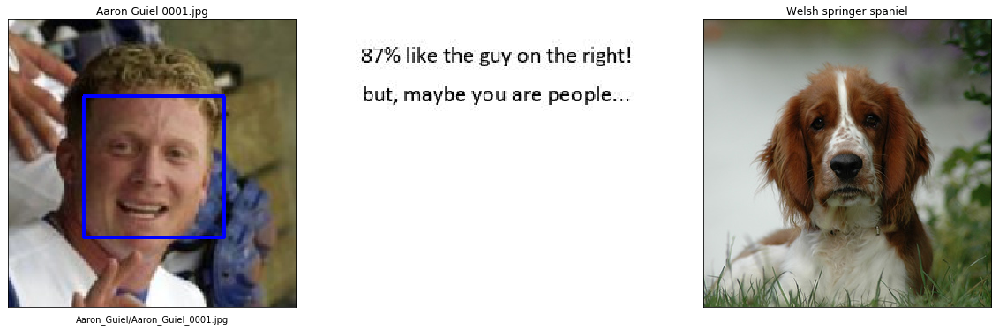

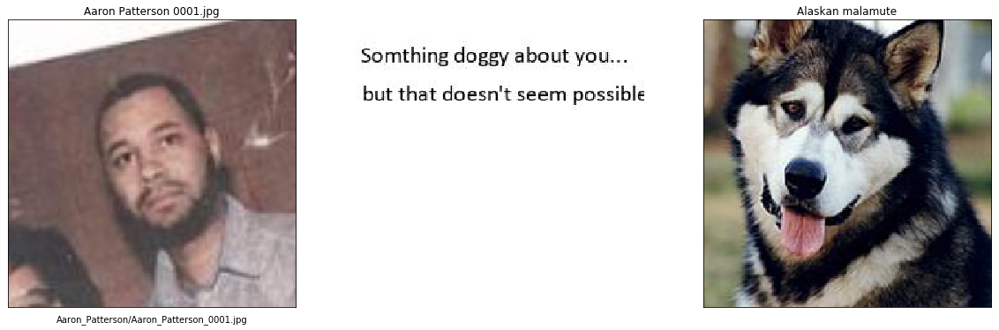

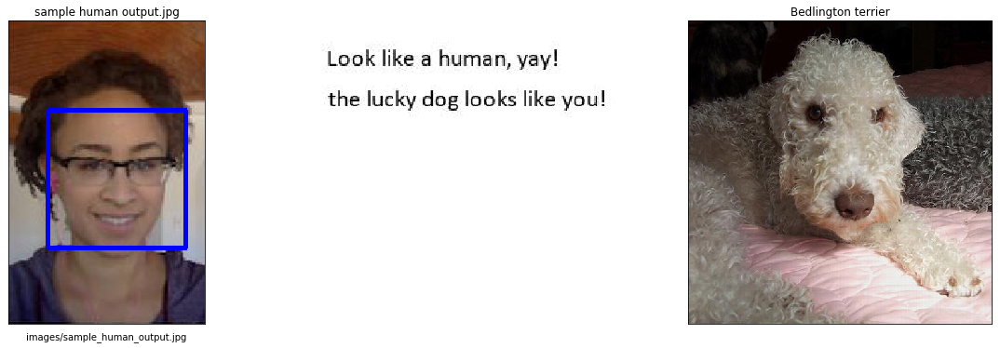

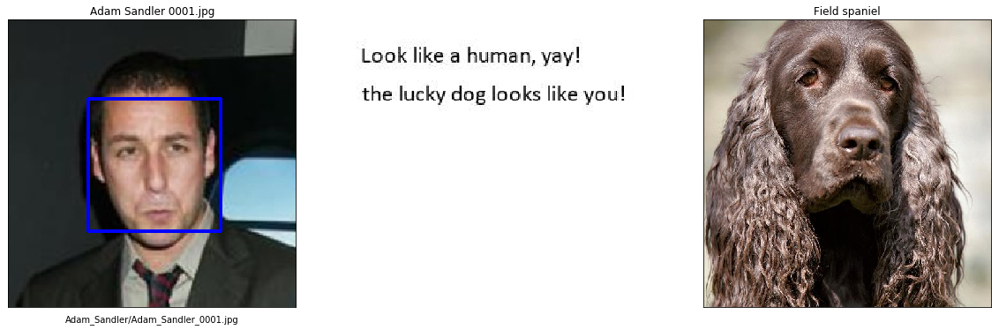

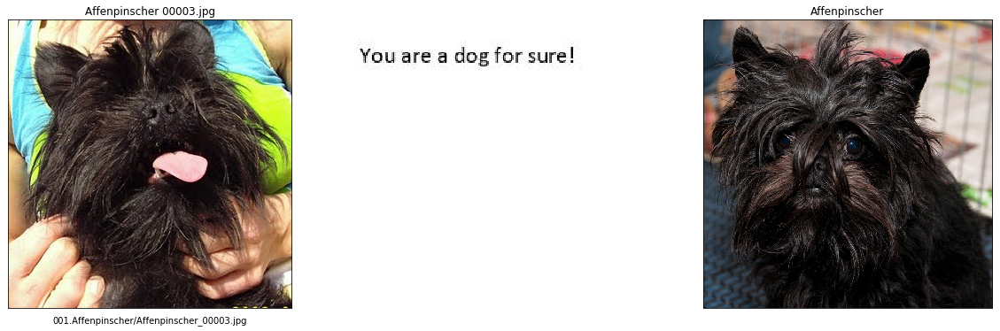

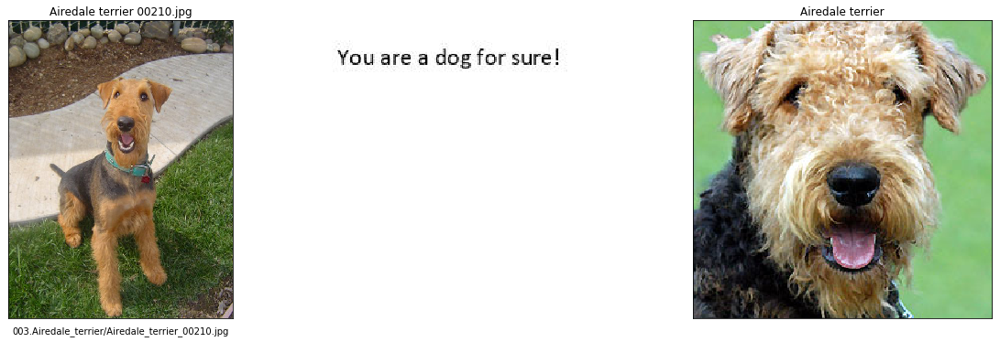

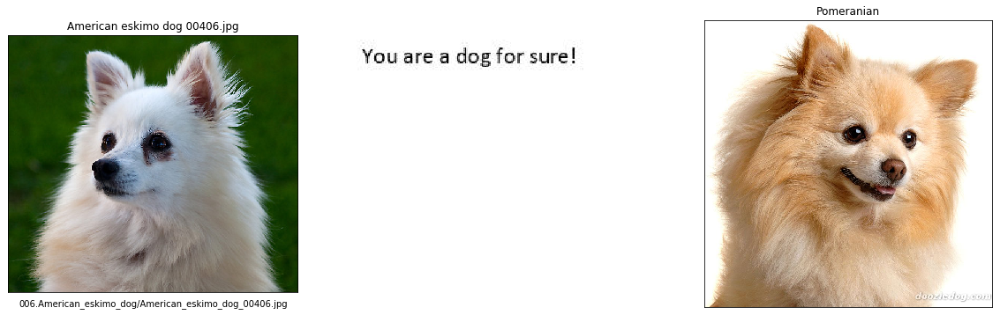

In [311]:
for file in np.hstack((human_files[:3], 
                       'images/sample_human_output.jpg', 
                       'lfw/Adam_Sandler/Adam_Sandler_0001.jpg',
                       dog_files[0], dog_files[20], dog_files[40])):
    run_app(file)

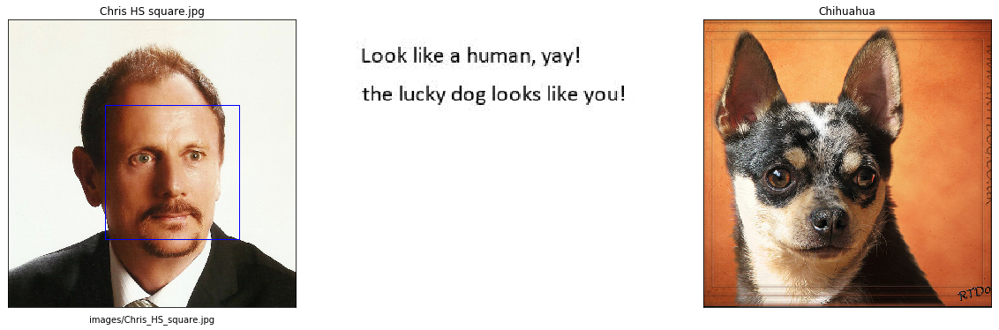

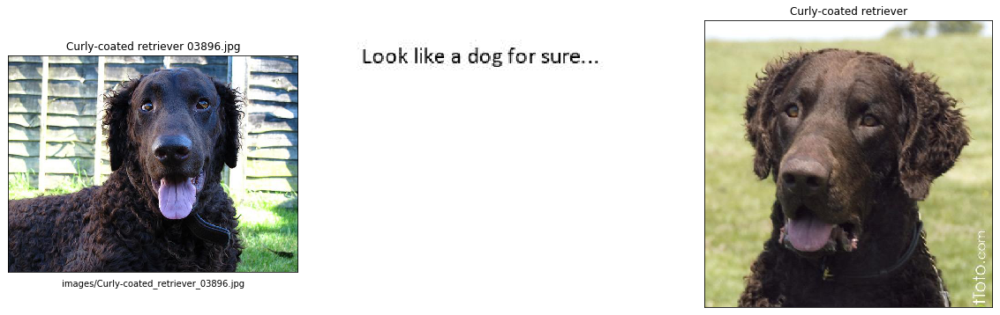

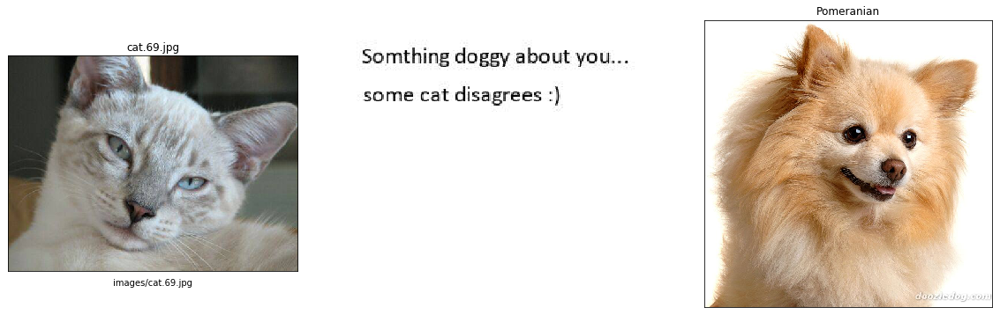

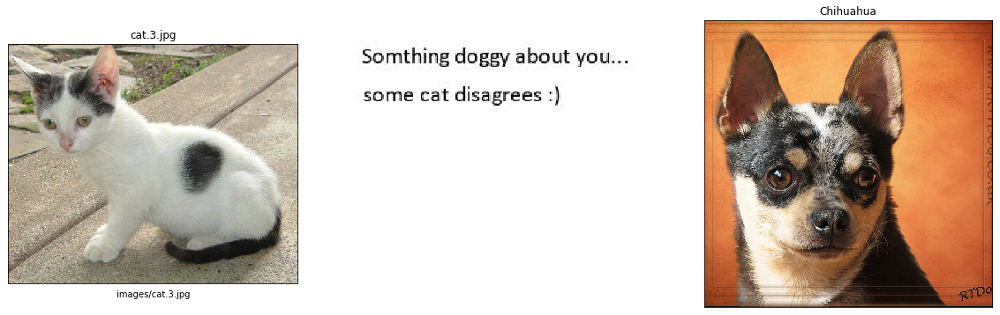

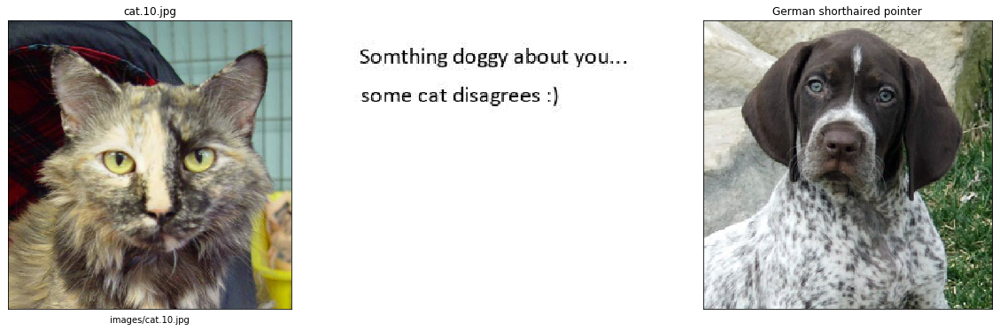

...

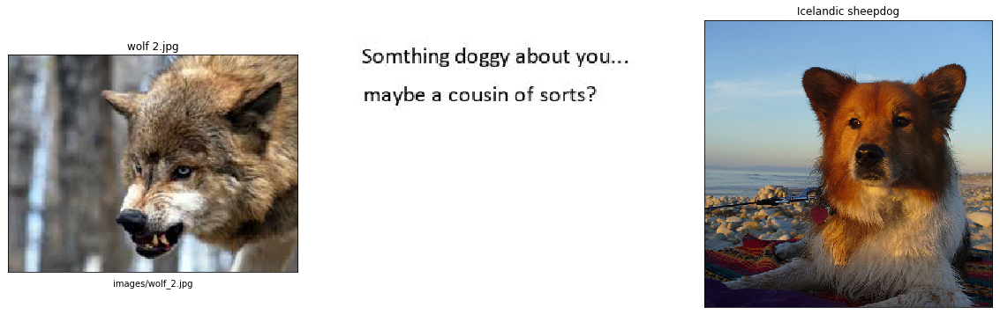

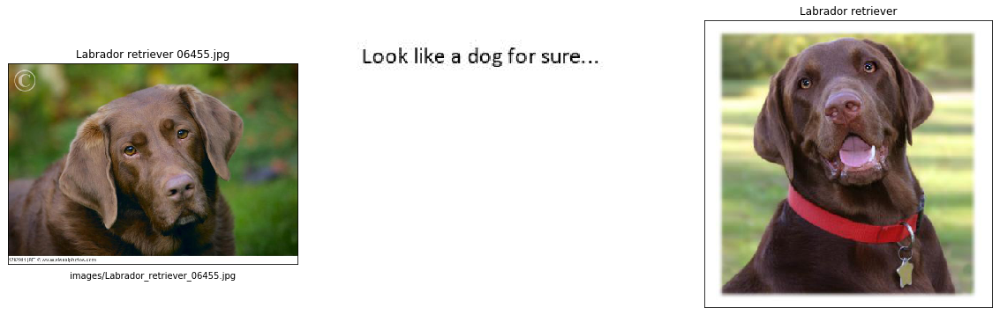

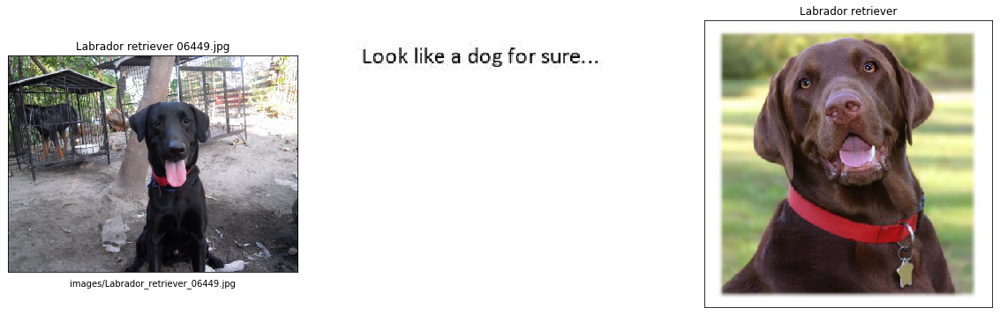

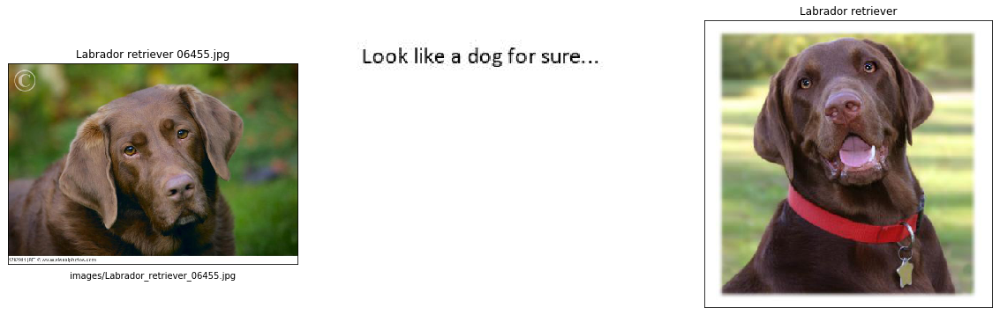

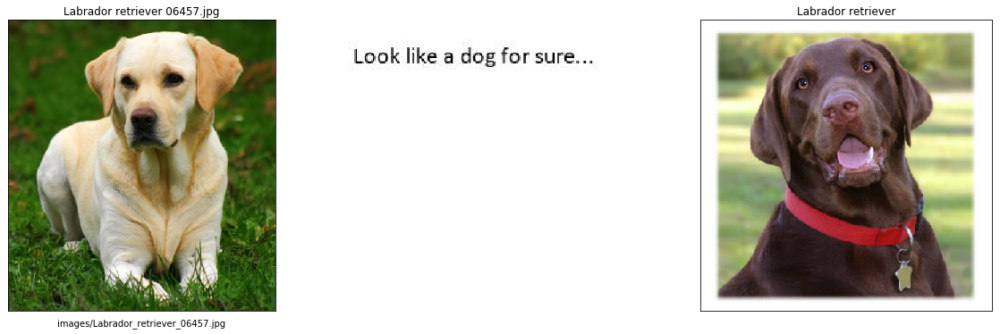

In [312]:
for file in np.hstack(('images/Chris_HS_square.jpg', 
                       'images/Curly-coated_retriever_03896.jpg', 
                       'images/cat.69.jpg',
                       'images/cat.3.jpg',
                       'images/cat.10.jpg',
                       'images/black_bear.jpg',
                       'images/gorilla.jpg',
                       'images/chimp.jpg',
                       'images/that_monkey.jpg',
                       'images/monkeys.jpg',
                       'images/goldfish.jpg',
                       'images/wolf_1.jpg',
                       'images/wolf_2.jpg',
                       'images/Labrador_retriever_06455.jpg', 
                       'images/Labrador_retriever_06449.jpg',
                       'images/Labrador_retriever_06455.jpg',
                       'images/Labrador_retriever_06457.jpg'
                      )):
    run_app(file)

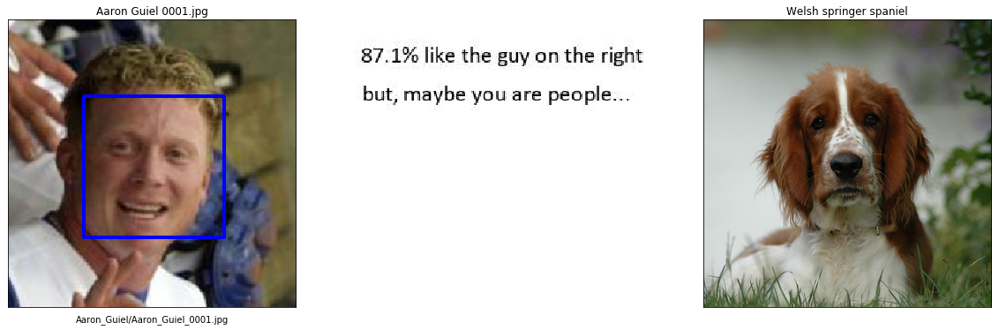

In [313]:
run_app('/DeepLearning/data/dog_app/lfw\\Aaron_Guiel\\Aaron_Guiel_0001.jpg')

In [314]:
pred_data = process_prediction('images/cat.3.jpg', 0.35)

In [315]:
pred_data[:3]

((['Chihuahua'],
  [47],
  [0.2500515580177307],
  ['dog_images/train/048.Chihuahua/Chihuahua_03410.jpg']),
 (False, ([285], ['Egyptian cat'], [0.5531317591667175])),
 [False, False, True, False, False])

In [316]:
pred_data[1]

(False, ([285], ['Egyptian cat'], [0.5531317591667175]))

In [317]:
pred_data[1][0]

False

In [318]:
pred_data[1][1][0][0]

285

In [319]:
pred_data[1][1][1][0]

'Egyptian cat'

In [320]:
process_prediction('images/wolf_1.jpg')[:3]

((['Icelandic sheepdog'],
  [83],
  [0.3519810438156128],
  ['dog_images/train/084.Icelandic_sheepdog/Icelandic_sheepdog_05715.jpg']),
 (False,
  ([269],
   ['timber wolf, grey wolf, gray wolf, Canis lupus'],
   [0.604245126247406])),
 [True, False, False, False, False])

In [321]:
process_prediction('images/gorilla.jpg')[:3]

((['Cane corso'],
  [43],
  [0.3520183265209198],
  ['dog_images/train/044.Cane_corso/Cane_corso_03133.jpg']),
 (False, ([366], ['gorilla, Gorilla gorilla'], [0.7590936422348022])),
 [True, False, False, False, False])

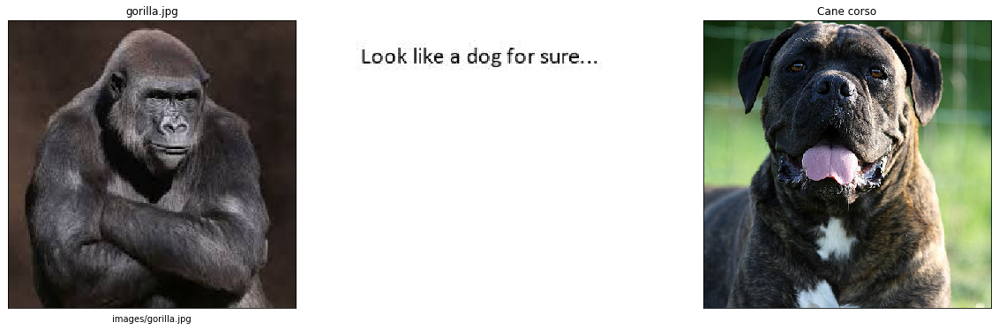

In [322]:
run_app('images/gorilla.jpg')

285


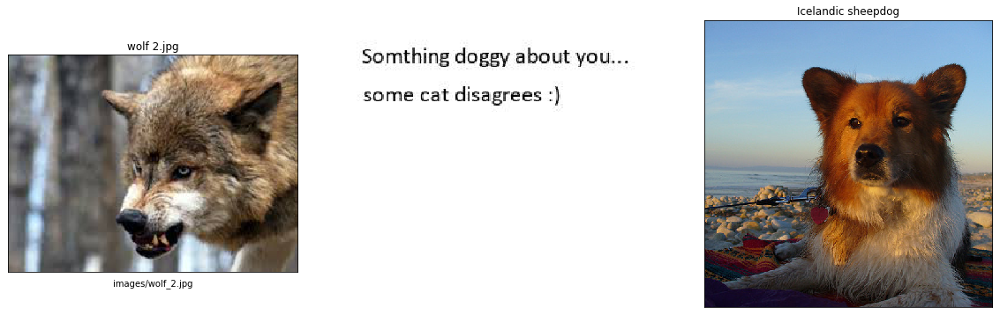

In [323]:
run_app('images/wolf_2.jpg')

In [324]:
process_prediction('images/wolf_2.jpg')[:3]

((['Icelandic sheepdog'],
  [83],
  [0.24406982958316803],
  ['dog_images/train/084.Icelandic_sheepdog/Icelandic_sheepdog_05715.jpg']),
 (False,
  ([269],
   ['timber wolf, grey wolf, gray wolf, Canis lupus'],
   [0.9177256226539612])),
 [False, False, True, False, False])

In [325]:
human_files[:3], dog_files[:3]

(array(['/DeepLearning/data/dog_app/lfw\\Aaron_Eckhart\\Aaron_Eckhart_0001.jpg',
        '/DeepLearning/data/dog_app/lfw\\Aaron_Guiel\\Aaron_Guiel_0001.jpg',
        '/DeepLearning/data/dog_app/lfw\\Aaron_Patterson\\Aaron_Patterson_0001.jpg'],
       dtype='<U111'),
 array(['/DeepLearning/data/dog_app/dog_images\\test\\001.Affenpinscher\\Affenpinscher_00003.jpg',
        '/DeepLearning/data/dog_app/dog_images\\test\\001.Affenpinscher\\Affenpinscher_00023.jpg',
        '/DeepLearning/data/dog_app/dog_images\\test\\001.Affenpinscher\\Affenpinscher_00036.jpg'],
       dtype='<U127'))

In [326]:
dog_breed_data = predict_breed_transfer('/DeepLearning/data/dog_app/lfw\\Aaron_Eckhart\\Aaron_Eckhart_0001.jpg')

In [327]:
dog_breed_data

(['Chihuahua'],
 [47],
 [0.06957560032606125],
 ['dog_images/train/048.Chihuahua/Chihuahua_03410.jpg'])

In [328]:
dog_breed_data[3][0]

'dog_images/train/048.Chihuahua/Chihuahua_03410.jpg'

In [329]:
ground_truth_img = cv2.imread(dog_breed_data[3][0])

In [330]:
ground_truth_img = cv2.imread(dog_breed_data[3])

In [331]:
testimg = process_prediction('/DeepLearning/data/dog_app/lfw\\Aaron_Eckhart\\Aaron_Eckhart_0001.jpg')

In [332]:
testimg

((['Chihuahua'],
  [47],
  [0.06957560032606125],
  ['dog_images/train/048.Chihuahua/Chihuahua_03410.jpg']),
 [False, True, True, False],
 array([[[  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0],
         ...,
         [  1,   1,   1],
         [  1,   1,   1],
         [  1,   1,   1]],
 
        [[  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0],
         ...,
         [  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0]],
 
        [[  0,   0,   0],
         [  0,   0,   0],
         [  1,   1,   1],
         ...,
         [  3,   3,   3],
         [  3,   3,   3],
         [  3,   3,   3]],
 
        ...,
 
        [[105, 121, 147],
         [111, 127, 153],
         [119, 134, 163],
         ...,
         [120, 131, 151],
         [133, 144, 164],
         [140, 151, 171]],
 
        [[104, 120, 146],
         [106, 122, 148],
         [113, 128, 157],
         ...,
         [127, 138, 158],
         [140, 151, 171],
         [1

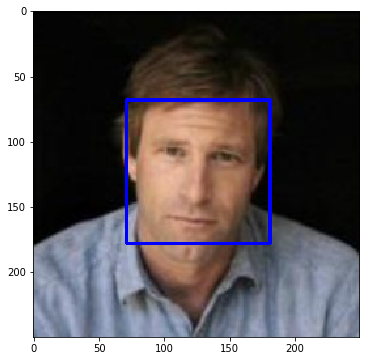

In [333]:
plt.imshow(testimg[2])

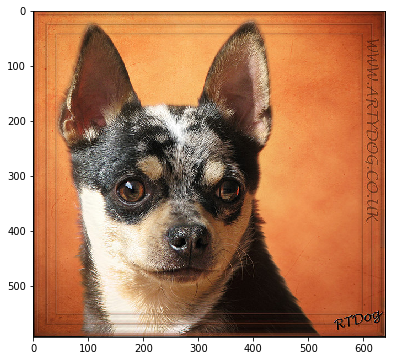

In [334]:
plt.imshow(testimg[3])

In [335]:
testimg = process_prediction('images/Chris_HS_square.jpg')

In [336]:
testimg

((['Chihuahua'],
  [47],
  [0.08603549003601074],
  ['dog_images/train/048.Chihuahua/Chihuahua_03410.jpg']),
 [False, True, True, False],
 array([[[121, 127, 127],
         [120, 126, 126],
         [120, 126, 126],
         ...,
         [120, 126, 124],
         [120, 126, 124],
         [120, 126, 124]],
 
        [[121, 126, 120],
         [121, 126, 120],
         [121, 126, 120],
         ...,
         [122, 127, 121],
         [122, 127, 121],
         [122, 127, 121]],
 
        [[241, 243, 230],
         [242, 244, 231],
         [242, 244, 231],
         ...,
         [243, 246, 237],
         [243, 246, 237],
         [243, 246, 237]],
 
        ...,
 
        [[ 22,  23,  18],
         [ 22,  23,  18],
         [ 21,  22,  17],
         ...,
         [ 19,  20,  15],
         [ 21,  22,  17],
         [ 21,  22,  17]],
 
        [[ 21,  22,  17],
         [ 21,  22,  17],
         [ 21,  22,  17],
         ...,
         [ 18,  19,  14],
         [ 21,  22,  17],
         [ 

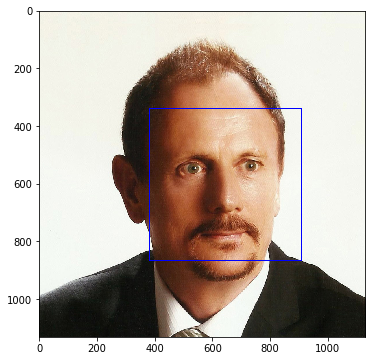

In [337]:
plt.imshow(testimg[2])

In [338]:
ImageNet_predict('images/Chris_HS_square.jpg')

([834], ['suit, suit of clothes'], [0.8445096611976624])

In [339]:
testimg = process_prediction('/DeepLearning/data/dog_app/lfw\\Aaron_Guiel\\Aaron_Guiel_0001.jpg')

/DeepLearning/data/dog_app/lfw\Aaron_Guiel\Aaron_Guiel_0001.jpg
False


In [340]:
testimg

((['Welsh springer spaniel'],
  [129],
  [0.8713216185569763],
  ['dog_images/train/130.Welsh_springer_spaniel/Welsh_springer_spaniel_08205.jpg']),
 [True, True, False, False],
 array([[[238, 243, 239],
         [240, 245, 241],
         [242, 247, 241],
         ...,
         [ 89,  88,  57],
         [ 92,  91,  60],
         [ 92,  91,  60]],
 
        [[246, 248, 245],
         [244, 246, 243],
         [243, 245, 242],
         ...,
         [ 89,  88,  57],
         [ 91,  90,  59],
         [ 91,  90,  59]],
 
        [[248, 248, 246],
         [248, 248, 246],
         [247, 247, 245],
         ...,
         [ 89,  88,  57],
         [ 91,  90,  59],
         [ 91,  90,  59]],
 
        ...,
 
        [[ 25,  32,  76],
         [ 24,  31,  75],
         [ 19,  26,  68],
         ...,
         [ 48,  49,  43],
         [ 48,  49,  44],
         [ 48,  49,  44]],
 
        [[ 24,  31,  75],
         [ 21,  28,  70],
         [ 18,  25,  67],
         ...,
         [ 42,  43,  38]

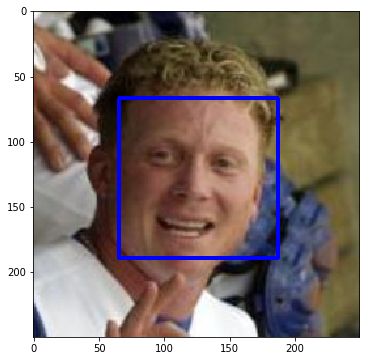

In [341]:
plt.imshow(testimg[2])

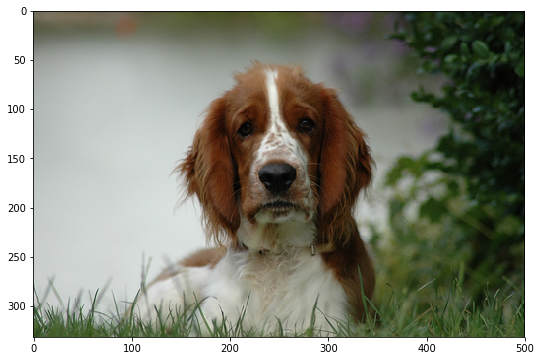

In [342]:
plt.imshow(testimg[3])

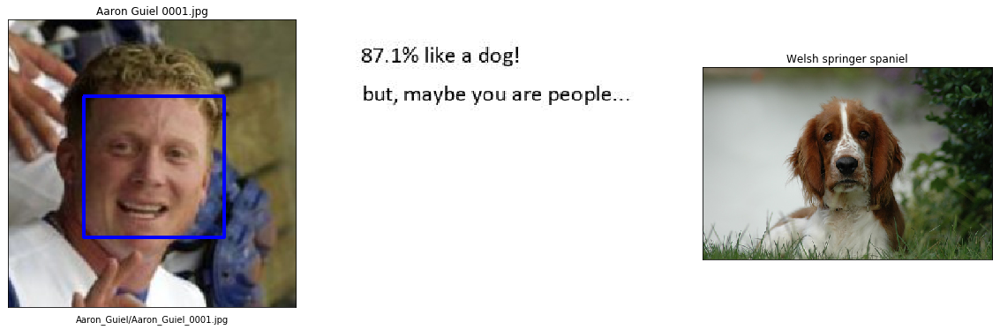

In [343]:
run_app('/DeepLearning/data/dog_app/lfw\\Aaron_Guiel\\Aaron_Guiel_0001.jpg')

In [344]:
process_prediction('dog_images/train/001.Affenpinscher/Affenpinscher_00029.jpg')

dog_images/train/001.Affenpinscher/Affenpinscher_00029.jpg
True


((['Affenpinscher'],
  [0],
  [0.980492115020752],
  ['dog_images/train/001.Affenpinscher/Affenpinscher_00029.jpg']),
 [True, False, False, True],
 array([[[ 36,  59,  77],
         [ 36,  59,  75],
         [ 39,  60,  77],
         ...,
         [189, 174, 141],
         [194, 176, 154],
         [193, 183, 171]],
 
        [[ 36,  59,  77],
         [ 35,  58,  74],
         [ 39,  60,  77],
         ...,
         [192, 181, 153],
         [198, 181, 163],
         [193, 186, 176]],
 
        [[ 37,  60,  76],
         [ 34,  57,  73],
         [ 37,  58,  75],
         ...,
         [195, 184, 162],
         [196, 182, 169],
         [190, 185, 179]],
 
        ...,
 
        [[ 44,  60,  75],
         [ 51,  63,  75],
         [ 51,  69,  83],
         ...,
         [ 92,  93,  98],
         [ 79,  87,  90],
         [ 81,  86,  90]],
 
        [[ 50,  63,  79],
         [ 55,  67,  79],
         [ 56,  74,  88],
         ...,
         [ 95,  95, 103],
         [ 84,  91,  99],
  

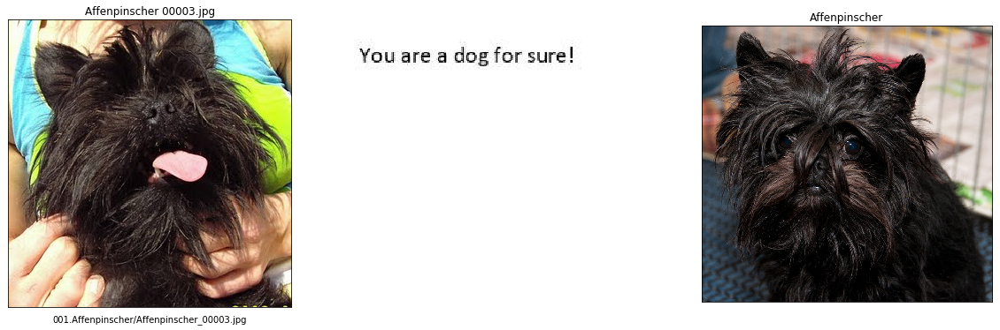

In [345]:
run_app(dog_files[0])

In [346]:
## TODO: Execute your algorithm from Step 6 on
## at least 6 images on your computer.
## Feel free to use as many code cells as needed.

## suggested code, below
for file in np.hstack((human_files[:3], dog_files[:3])):
    print(process_prediction(file))

((['Chihuahua'], [47], [0.06957560032606125], ['dog_images/train/048.Chihuahua/Chihuahua_03410.jpg']), True, True)
((['Welsh springer spaniel'], [129], [0.8713216185569763], ['dog_images/train/130.Welsh_springer_spaniel/Welsh_springer_spaniel_08205.jpg']), False, False)
((['Alaskan malamute'], [4], [0.11768720299005508], ['dog_images/train/005.Alaskan_malamute/Alaskan_malamute_00322.jpg']), False, True)
((['Affenpinscher'], [0], [0.9785173535346985], ['dog_images/train/001.Affenpinscher/Affenpinscher_00029.jpg']), False, False)
((['Affenpinscher'], [0], [0.9862194657325745], ['dog_images/train/001.Affenpinscher/Affenpinscher_00029.jpg']), False, False)
((['Affenpinscher'], [0], [0.8206979632377625], ['dog_images/train/001.Affenpinscher/Affenpinscher_00029.jpg']), False, False)


In [347]:
for file in np.hstack((human_files[:3], dog_files[:3])):
    print(ImageNet_predict(file))

([739], ["potter's wheel"], [0.1687753051519394])
([617], ['lab coat, laboratory coat'], [0.27303215861320496])
([739], ["potter's wheel"], [0.06263517588376999])
([252], ['affenpinscher, monkey pinscher, monkey dog'], [0.9864093065261841])
([252], ['affenpinscher, monkey pinscher, monkey dog'], [0.9392310976982117])
([252], ['affenpinscher, monkey pinscher, monkey dog'], [0.9900209903717041])


In [348]:
## suggested code, below
for file in np.hstack((human_files[:3], dog_files[0], dog_files[20], dog_files[40])):
    prediction = process_prediction(file)
    print(prediction[:2])

((['Chihuahua'], [47], [0.06957560032606125], ['dog_images/train/048.Chihuahua/Chihuahua_03410.jpg']), [False, True, True, False])
((['Welsh springer spaniel'], [129], [0.8713216185569763], ['dog_images/train/130.Welsh_springer_spaniel/Welsh_springer_spaniel_08205.jpg']), [True, True, False, False])
((['Alaskan malamute'], [4], [0.11768720299005508], ['dog_images/train/005.Alaskan_malamute/Alaskan_malamute_00322.jpg']), [False, False, True, False])
((['Affenpinscher'], [0], [0.9785173535346985], ['dog_images/train/001.Affenpinscher/Affenpinscher_00029.jpg']), [True, False, False, False])
((['Airedale terrier'], [2], [0.8567410111427307], ['dog_images/train/003.Airedale_terrier/Airedale_terrier_00181.jpg']), [True, False, False, False])
((['Pomeranian'], [122], [0.8344544768333435], ['dog_images/train/123.Pomeranian/Pomeranian_07876.jpg']), [True, False, False, False])


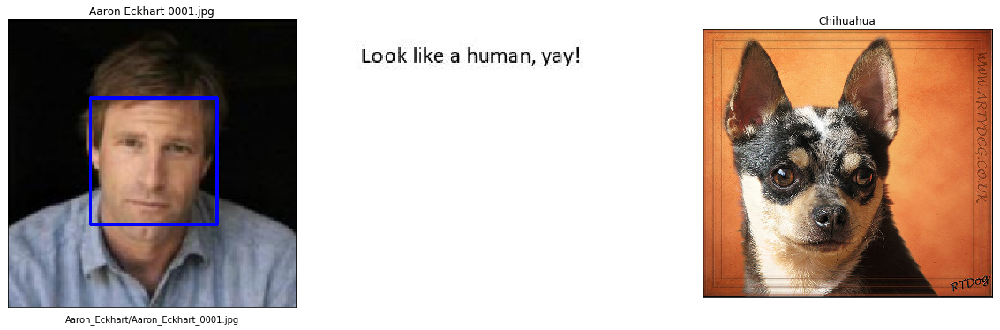

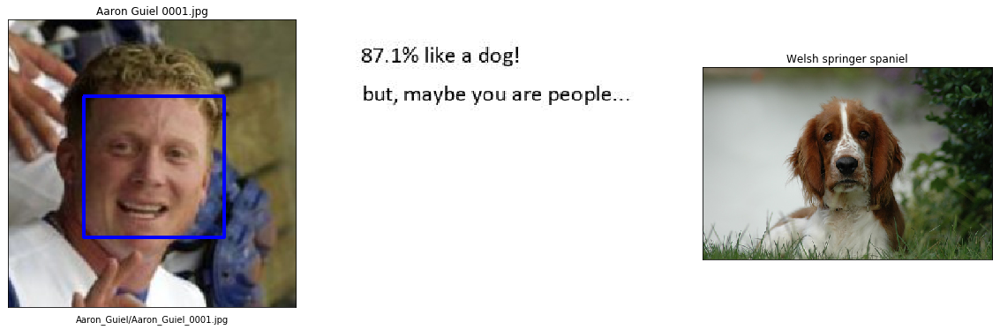

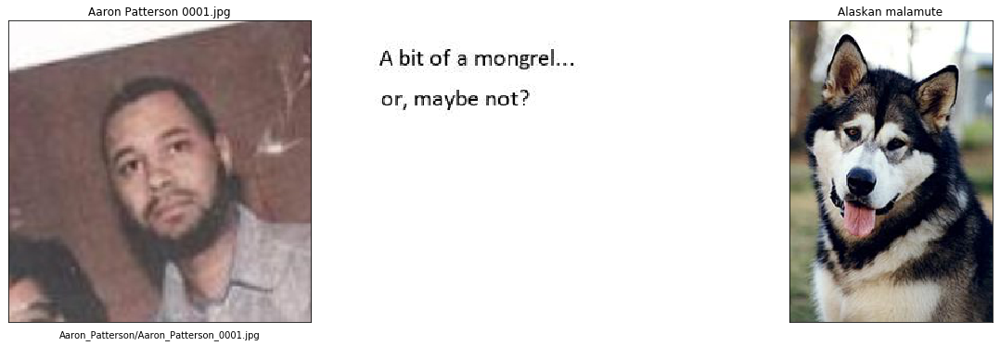

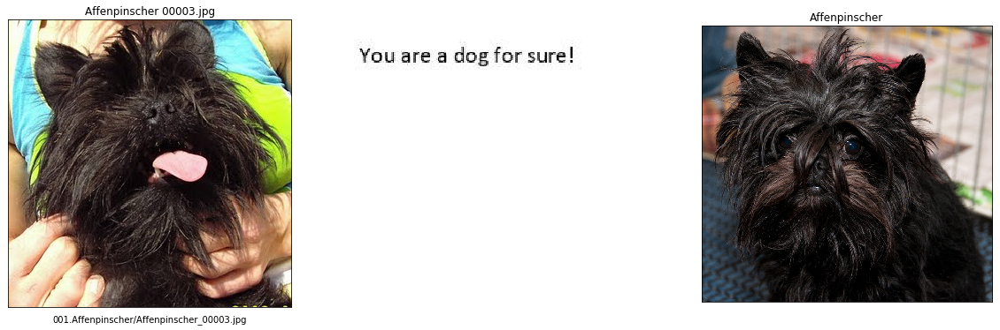

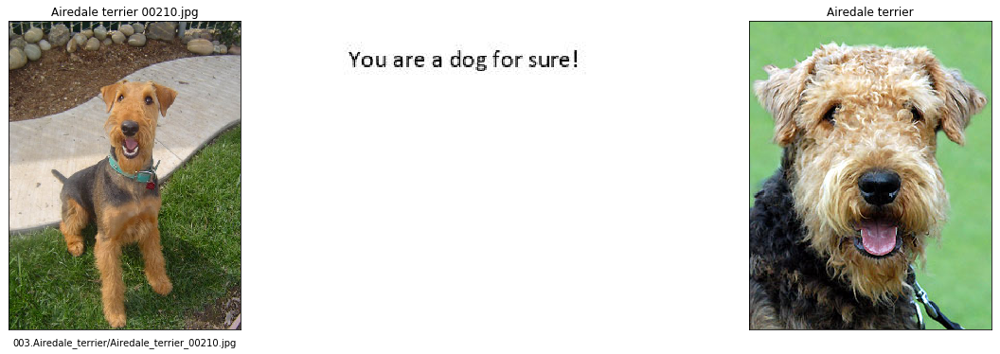

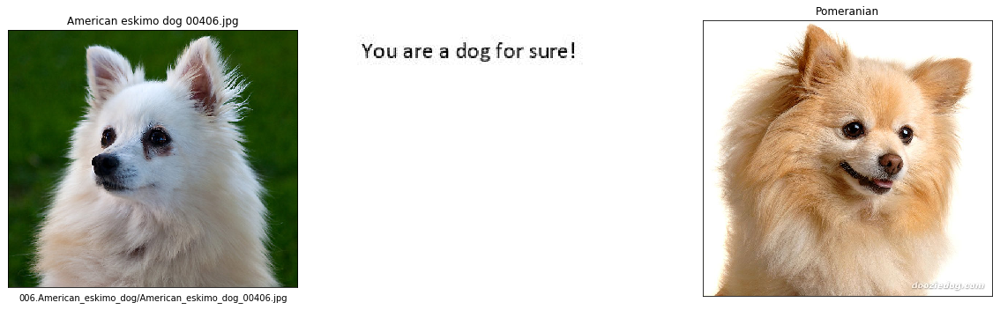

In [349]:
for file in np.hstack((human_files[:3], dog_files[0], dog_files[20], dog_files[40])):
    run_app(file)

# Code in development...

In [350]:
import os
import torchvision
from torchvision import datasets, models, transforms

In [351]:
class_names

['001.Affenpinscher',
 '002.Afghan_hound',
 '003.Airedale_terrier',
 '004.Akita',
 '005.Alaskan_malamute',
 '006.American_eskimo_dog',
 '007.American_foxhound',
 '008.American_staffordshire_terrier',
 '009.American_water_spaniel',
 '010.Anatolian_shepherd_dog',
 '011.Australian_cattle_dog',
 '012.Australian_shepherd',
 '013.Australian_terrier',
 '014.Basenji',
 '015.Basset_hound',
 '016.Beagle',
 '017.Bearded_collie',
 '018.Beauceron',
 '019.Bedlington_terrier',
 '020.Belgian_malinois',
 '021.Belgian_sheepdog',
 '022.Belgian_tervuren',
 '023.Bernese_mountain_dog',
 '024.Bichon_frise',
 '025.Black_and_tan_coonhound',
 '026.Black_russian_terrier',
 '027.Bloodhound',
 '028.Bluetick_coonhound',
 '029.Border_collie',
 '030.Border_terrier',
 '031.Borzoi',
 '032.Boston_terrier',
 '033.Bouvier_des_flandres',
 '034.Boxer',
 '035.Boykin_spaniel',
 '036.Briard',
 '037.Brittany',
 '038.Brussels_griffon',
 '039.Bull_terrier',
 '040.Bulldog',
 '041.Bullmastiff',
 '042.Cairn_terrier',
 '043.Canaan_do

In [352]:
## See https://discuss.pytorch.org/t/how-to-classify-single-image-using-loaded-net/1411
## and https://gist.github.com/jkarimi91/d393688c4d4cdb9251e3f939f138876e
def image_loader(img_path, imsize=224):    
    loader = transforms.Compose([transforms.Resize(imsize), transforms.ToTensor(),
                                 transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                                       std=[0.229, 0.224, 0.225])])
    img = Image.open(img_path)
    img = loader(img).float()
    img = torch.tensor(img) #, requires_grad=True)
    img = img.unsqueeze(0)
    
    return img #.to(device)

In [353]:
image_loader('dogImages/train/001.Affenpinscher/Affenpinscher_00001.jpg')

tensor([[[[-0.7479, -1.2445, -1.4158,  ..., -1.4672, -1.5528, -1.1932],
          [-0.2342, -1.0048, -1.1075,  ..., -1.7069, -1.4329, -1.0733],
          [-0.6965, -0.5596, -0.3027,  ..., -1.6213, -1.2274, -0.9877],
          ...,
          [ 1.8037,  1.7694,  1.6667,  ...,  1.8893,  1.7009,  1.7009],
          [ 1.9235,  1.8550,  1.7352,  ...,  1.6153,  1.7523,  1.6324],
          [ 1.9235,  1.8722,  1.7694,  ...,  1.3413,  1.6838,  1.4783]],

         [[-0.4426, -0.9328, -1.0903,  ..., -1.2479, -1.4405, -1.1604],
          [ 0.1176, -0.6702, -0.7402,  ..., -1.4930, -1.3004, -1.0028],
          [-0.3200, -0.1800,  0.1176,  ..., -1.3880, -1.0728, -0.8978],
          ...,
          [ 1.2206,  1.1856,  1.1331,  ...,  1.6408,  1.4657,  1.5007],
          [ 1.3256,  1.2731,  1.1856,  ...,  1.3782,  1.5532,  1.4482],
          [ 1.3256,  1.2731,  1.2031,  ...,  1.0805,  1.4832,  1.3081]],

         [[-0.9330, -1.2641, -1.4559,  ..., -1.1596, -1.4036, -1.1421],
          [-0.3055, -1.0898, -

# Utilities

In [354]:
%%javascript

// Sourced from http://nbviewer.jupyter.org/gist/minrk/5d0946d39d511d9e0b5a

$("#renumber-button").parent().remove();

function renumber() {
    // renumber cells in order
    var i=1;
    IPython.notebook.get_cells().map(function (cell) {
        if (cell.cell_type == 'code') {
            // set the input prompt
            cell.set_input_prompt(i);
            // set the output prompt (in two places)
            cell.output_area.outputs.map(function (output) {
                if (output.output_type == 'execute_result') {
                    output.execution_count = i;
                    cell.element.find(".output_prompt").text('Out[' + i + ']:');
                }
            });
            i += 1;
        }
    });
}

IPython.toolbar.add_buttons_group([{
  'label'   : 'Renumber',
  'icon'    : 'fa-list-ol',
  'callback': renumber,
  'id'      : 'renumber-button'
}]);

<IPython.core.display.Javascript object>

## CV2 image handling functions...

In [355]:
import cv2  
face_cascade = cv2.CascadeClassifier('haarcascades/haarcascade_frontalface_alt.xml')

# Resize image by specifying longer side size
# http://corochann.com/basic-image-processing-tutorial-1220.html
def resize_longedge(image, pixel):
    """Resize the input image
    
    Longer edge size will be `pixel`, and aspect ratio doesn't change
    """
    height, width = image.shape[:2]
    longer_side = max(height, width)
    ratio = float(pixel) / longer_side
    return cv2.resize(image, None, fx=ratio, fy=ratio)  # size must be int

def resize_shortedge(image, pixel):
    """Resize the input image
    
    Shorter edge size will be `pixel`, and aspect ratio doesn't change
    """
    height, width = image.shape[:2]
    shorter_side = min(height, width)
    ratio = float(pixel) / shorter_side
    return cv2.resize(image, None, fx=ratio, fy=ratio)  # size must be int

# Appendix

## 1 Cycle training of transfer model

## Standard training of Transfer model

## Architecture and training output of 3 layer CNN - 48-96-128 

## Architecture and training output of 3 runs of the 3 layer CNN

### Run 1 (1 to 100). Best epoch was 99

### Run 2 (101 to 200). Best epoch was 199

### Run 3 (201 to 300). Best epoch was 297

## Architecture and training output of 1 300 epoch run of the 3 layer CNN with batchnorm

## Architecture and training output of 2 runs of 6 layer CNN

### Run 1 (1 to 50). Best epoch was 49

### Run 1 (51 to 150). Best epoch was 150

In [357]:
5e-04

0.0005